# Hierarchical Cluster

In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_score
from tqdm import tqdm
from sklearn.decomposition import PCA
from sklearn import metrics
from scipy.stats import mode
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import NearestCentroid
from scipy.spatial.distance import pdist
from clustering_utils import *

## Load the Data

In [2]:
df = pd.read_csv("../dataset/cleaned_user_profiles.csv", index_col=0)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11508 entries, 2353593986 to 933183398
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   name                    11508 non-null  object 
 1   lang                    11508 non-null  object 
 2   bot                     11508 non-null  int64  
 3   created_at              11508 non-null  object 
 4   statuses_count          11508 non-null  int64  
 5   avg_length              11508 non-null  float64
 6   avg_special_chars       11508 non-null  float64
 7   urls_ratio              11508 non-null  float64
 8   mentions_ratio          11508 non-null  float64
 9   hashtags_ratio          11508 non-null  float64
 10  reply_count_mean        11508 non-null  float64
 11  reply_count_std         11508 non-null  float64
 12  favorite_count_mean     11508 non-null  float64
 13  favorite_count_std      11508 non-null  float64
 14  favorite_count_entropy  1

loaded the data, we separate the numerical features (used to run the clustering algorithms) and the categorical ones (used to understand the results of the clustering algorithms)

In [4]:
# remove categorical features
cat_features = ["name", "lang", "bot", "created_at"]
df_cat = df[cat_features]
df_num = df.loc[:, ~df.columns.isin(cat_features)]

In [5]:
df_cat.head()

,name,lang,bot,created_at
2353593986,Lamonica Raborn,en,1,2019-02-22 18:00:42
2358850842,Lourie Botton,en,0,2019-02-26 03:02:32
137959629,Dadan Syarifudin,en,1,2015-04-30 07:09:56
466124818,Carletto Focia,it,1,2017-01-18 02:49:18
2571493866,MBK Ebook,en,0,2019-06-18 19:30:21


In [6]:
df_num.head()

,statuses_count,avg_length,avg_special_chars,urls_ratio,mentions_ratio,hashtags_ratio,reply_count_mean,reply_count_std,favorite_count_mean,favorite_count_std,favorite_count_entropy,retweet_count_mean,retweet_count_std,retweet_count_entropy
2353593986,76,62.340909,14.015152,0.000000,0.272727,0.098485,0.0,0.0,0.037879,0.190903,0.232481,0.037879,0.190903,0.232481
2358850842,54,69.082645,15.041322,0.000000,0.338843,0.024793,0.0,0.0,0.049587,0.217090,0.284639,0.024793,0.155495,0.167568
137959629,53,65.340909,14.694444,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000
466124818,50,86.944871,18.689463,0.022331,0.006281,0.072575,0.0,0.0,0.165387,0.530838,0.669155,0.826239,13.034008,0.392850
2571493866,7085,72.311246,14.582073,0.000825,0.506461,0.118229,0.0,0.0,0.056365,0.243387,0.317182,0.016772,0.142619,0.120737


## Preprocessing

First apply the log scale of the feature with a skewed distribution (see DataProfileUnderstanding.ipynb), following the results presented in data understanding of the profiling.

In [7]:
# TODO : Review the DataUnderstandingProfiling

skewed_features = [
    "statuses_count",
    "avg_special_chars",
    "urls_ratio",
    "mentions_ratio",
    "hashtags_ratio",
    "reply_count_mean",
    "reply_count_std",
    "favorite_count_mean",
    "favorite_count_entropy",
    "favorite_count_std",
    "retweet_count_mean",
    "retweet_count_entropy",
    "retweet_count_std"]

df_num_not_skewed = preprocess_skewed_features(df_num, skewed_features)

Apply Standard Scaling as preprocessing step

In [8]:
scaler = StandardScaler()

In [9]:
X = scaler.fit_transform(df_num_not_skewed.values)

## Apply Hierarchical Clustering

We will try different combination of the clustering's parameters, metrics and aggregation, plotting out the different dendrograms, and based on that we will choose the best cutting measure, selecting at the end the method with the most significative dendrogram.

### Metric: Cosine

#### Aggregator: Single

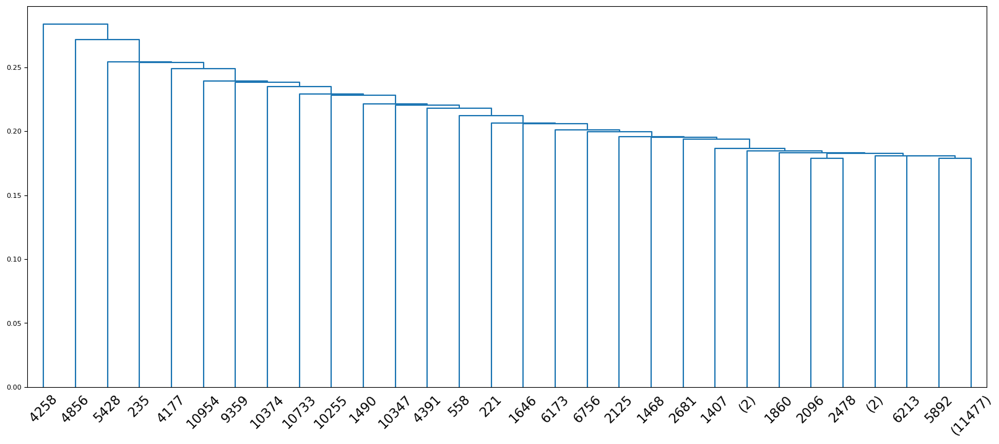

In [10]:
data_dist = pdist(X, metric='cosine')
data_link = linkage(data_dist, method='single', metric='cosine')

fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=0.11, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

#### Aggregator: Average

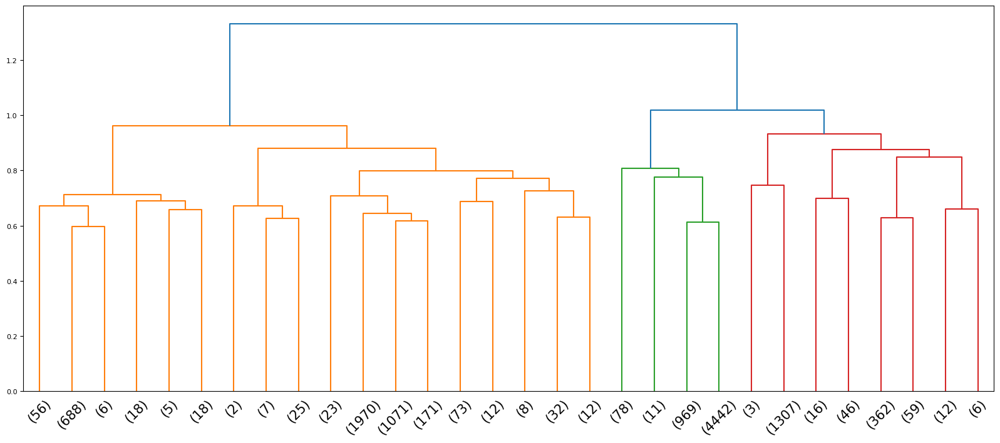

In [11]:
data_dist = pdist(X, metric='cosine')
data_link = linkage(data_dist, method='average', metric='cosine')


fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=1.0, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

#### Aggregator: Complete

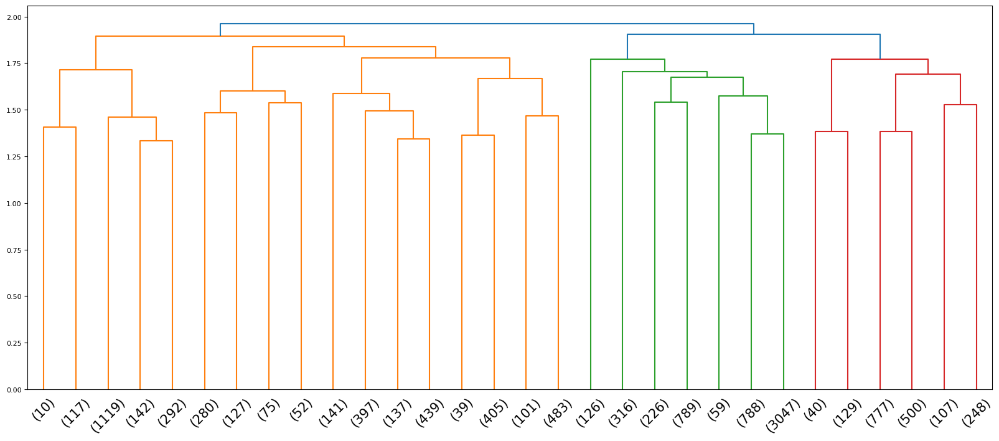

In [12]:
data_dist = pdist(X, metric='cosine')
data_link = linkage(data_dist, method='complete', metric='cosine')


fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=1.9, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

### Metric: Euclidean

#### Aggregator: Single

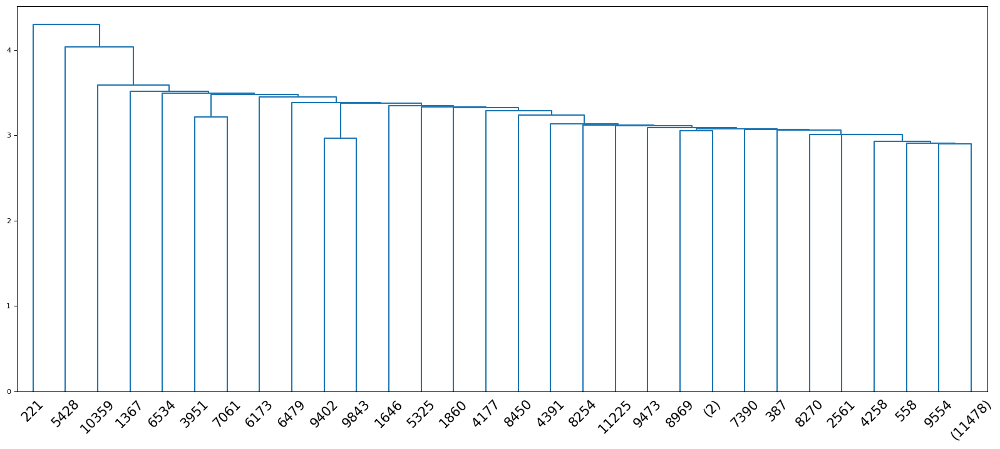

In [13]:
data_dist = pdist(X, metric='euclidean')
data_link = linkage(data_dist, method='single', metric='euclidean')

fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=0.7, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

#### Aggregator: Average

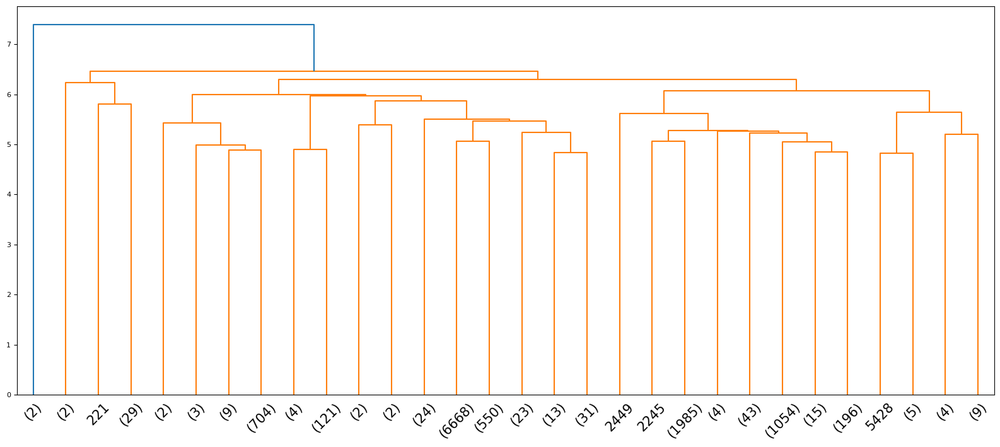

In [14]:
data_dist = pdist(X, metric='euclidean')
data_link = linkage(data_dist, method='average', metric='euclidean')

fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=7, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

#### Aggregator: Complete

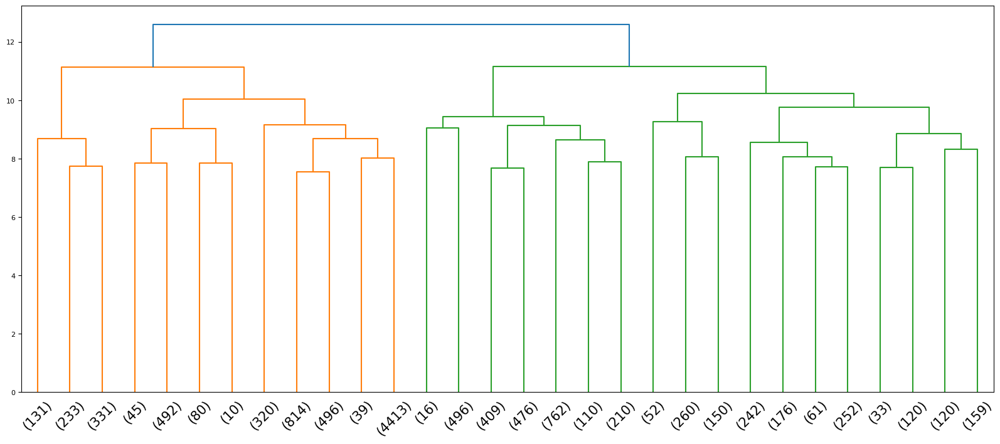

In [15]:
data_dist = pdist(X, metric='euclidean')
data_link = linkage(data_dist, method='complete', metric='euclidean')

fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=11.6, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

#### Aggregator: Ward

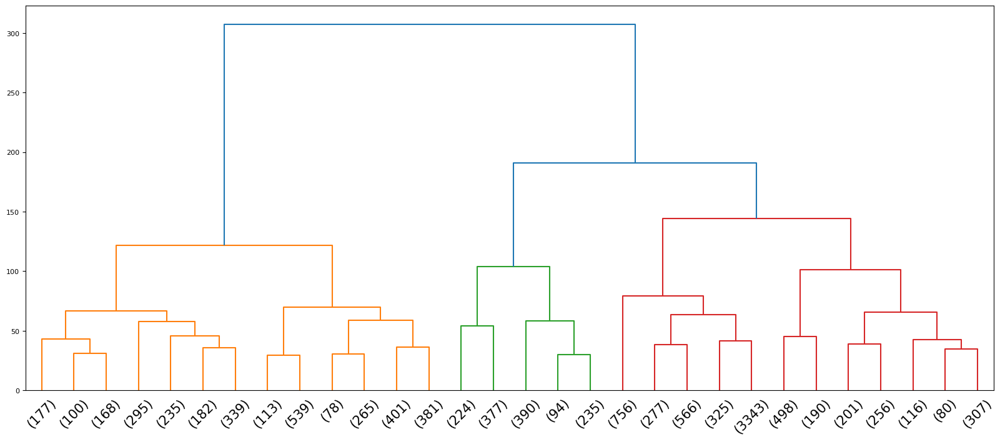

In [16]:
data_dist = pdist(X, metric='euclidean')
data_link = linkage(data_dist, method='ward', metric='euclidean')

fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(1, 1, 1)
res = dendrogram(data_link, color_threshold=175, truncate_mode='lastp')
ax.tick_params(axis='x', which='major', labelsize=15)
ax.tick_params(axis='y', which='major', labelsize=8)

Now apply the clustering methods just plotted out, to compute the metrics, the number of cluster are choosen with respect to the relative dendrogram.

### AgglomerativeClustering with cosine as affinity and average as linkage

In [17]:
cluster = AgglomerativeClustering(n_clusters=3, affinity='cosine', linkage='average')
cluster.fit_predict(X)

print('Silhouette %s' % silhouette_score(X, cluster.labels_))
print('Separation %s' % metrics.davies_bouldin_score(X, cluster.labels_))

Silhouette 0.32191840390719373
Separation 1.5044588759395818


### AgglomerativeClustering with cosine as affinity and complete as linkage

In [18]:
cluster = AgglomerativeClustering(n_clusters=3, affinity='cosine', linkage='complete')
cluster.fit_predict(X)

print('Silhouette %s' % silhouette_score(X, cluster.labels_))
print('Separation %s' % metrics.davies_bouldin_score(X, cluster.labels_))

Silhouette 0.30862701728818503
Separation 1.5815514920801217


### AgglomerativeClustering with euclidean as affinity and complete as linkage

In [19]:
cluster = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='complete')
cluster.fit_predict(X)

print('Silhouette %s' % silhouette_score(X, cluster.labels_))
print('Separation %s' % metrics.davies_bouldin_score(X, cluster.labels_))

Silhouette 0.3147167115525173
Separation 2.041929600566317


### AgglomerativeClustering with euclidean as affinity and ward as linkage

In [20]:
res_cluster = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
res_cluster.fit_predict(X)

print('Silhouette %s' % silhouette_score(X, res_cluster.labels_))
print('Separation %s' % metrics.davies_bouldin_score(X, res_cluster.labels_))

Silhouette 0.349018386442831
Separation 1.298321401122908


In [21]:
y_predict = res_cluster.fit_predict(X)
clf = NearestCentroid()
clf.fit(X, y_predict)

NearestCentroid()

Plot The number of samples in each cluster

In [22]:
cluster_hist(res_cluster.labels_)

{0: 6915, 1: 3273, 2: 1320}

Based on the dendrograms and the Silouette and Separation we have choose the Euclidean Affinity and Ward Linkage.

The dendrogram of the choosen configuration is clear one, with the higher separation (in the dendrogram) of the clusters elements.

### Plot Cluster Results

Plot the centroids in a tabular way, to have a summary of the clusters

In [23]:
pd.DataFrame(clf.centroids_, columns=df_num_not_skewed.columns)

,log_statuses_count,avg_length,log_avg_special_chars,log_urls_ratio,log_mentions_ratio,log_hashtags_ratio,log_reply_count_mean,log_reply_count_std,log_favorite_count_mean,log_favorite_count_std,log_favorite_count_entropy,log_retweet_count_mean,log_retweet_count_std,log_retweet_count_entropy
0,-0.462338,0.122086,0.134457,-0.374964,-0.368550,-0.304001,-0.248634,-0.348431,-0.270227,-0.302515,-0.276692,-0.543812,-0.535521,-0.460929
1,1.220372,-0.113497,-0.226471,0.847810,1.161417,0.388993,-0.234184,-0.346207,0.785870,0.886564,0.905499,1.136272,1.147946,1.246303
2,-0.603947,-0.358142,-0.142824,-0.137883,-0.949090,0.628026,1.883176,2.683742,-0.532982,-0.613512,-0.795737,0.031393,-0.040986,-0.675627


In [24]:
centers_not_skewed = scaler.inverse_transform(clf.centroids_)

In [25]:
pd.DataFrame(centers_not_skewed, columns=df_num_not_skewed.columns)

,log_statuses_count,avg_length,log_avg_special_chars,log_urls_ratio,log_mentions_ratio,log_hashtags_ratio,log_reply_count_mean,log_reply_count_std,log_favorite_count_mean,log_favorite_count_std,log_favorite_count_entropy,log_retweet_count_mean,log_retweet_count_std,log_retweet_count_entropy
0,4.297195,68.657308,2.784357,0.010968,0.180798,0.069345,0.000030,0.000187,0.051341,0.200710,0.223172,0.646564,1.242539,0.275626
1,8.331935,65.652511,2.729210,0.070846,0.545547,0.124894,0.000141,0.000324,0.149173,0.498671,0.518627,4.663357,6.383594,1.202565
2,3.957650,62.532125,2.741991,0.022577,0.042396,0.144055,0.016364,0.187000,0.027000,0.122780,0.093452,2.021780,2.752774,0.159057


In [26]:
centers = reverse_log_skewed(centers_not_skewed, df_num, skewed_features)

In [27]:
pd.DataFrame(centers, columns=df_num.columns)

,statuses_count,avg_length,avg_special_chars,urls_ratio,mentions_ratio,hashtags_ratio,reply_count_mean,reply_count_std,favorite_count_mean,favorite_count_std,favorite_count_entropy,retweet_count_mean,retweet_count_std,retweet_count_entropy
0,72.493361,68.657308,15.189406,0.011028,0.198174,0.071805,0.000030,0.000187,0.052682,0.222270,0.250036,0.908970,2.464399,0.317356
1,4153.450179,65.652511,14.320780,0.073416,0.725552,0.133029,0.000141,0.000324,0.160874,0.646531,0.679719,104.991251,591.051711,2.328644
2,51.334176,62.532125,14.517845,0.022834,0.043308,0.154948,0.016498,0.205627,0.027368,0.130636,0.097958,6.551752,14.686081,0.172404


Plot the centroids coordinates in parallel and radar coordinates, we can see that the different centroids have values of the features that vary in the magnitude between different clusters, so each cluster represent a kind of behaviour different with respect the others.

For example the centroid whose cluster has high number of bot have less values in some interaction features, with respect to the cluster with high number of bots, this is sound with the domain of the problem.

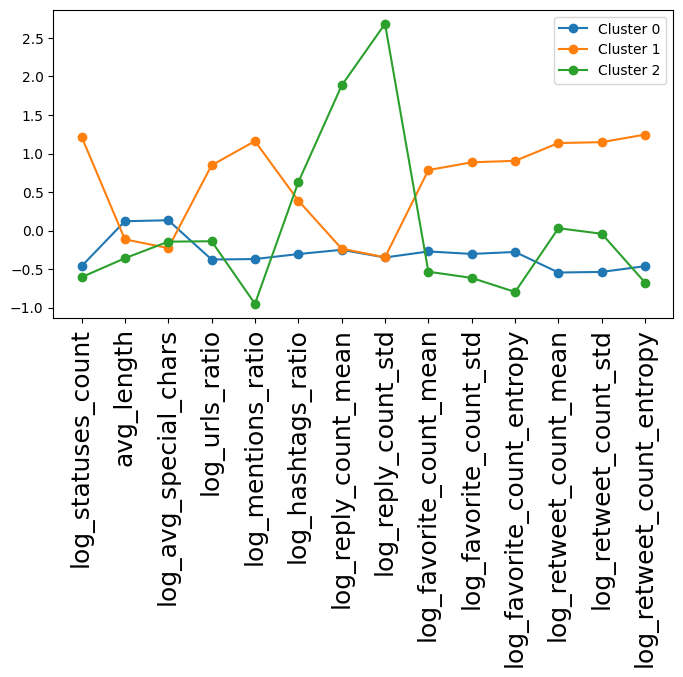

In [28]:
plot_parallel_coordinates_clusters(df_num_not_skewed, clf.centroids_, "hierarchical")

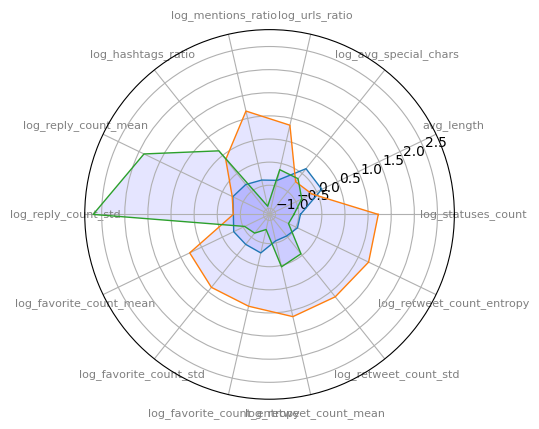

In [29]:
plot_radar_clusters(df_num_not_skewed, clf.centroids_, "hierarchical")

#### Distribution of CategoricalFeatures per Cluster

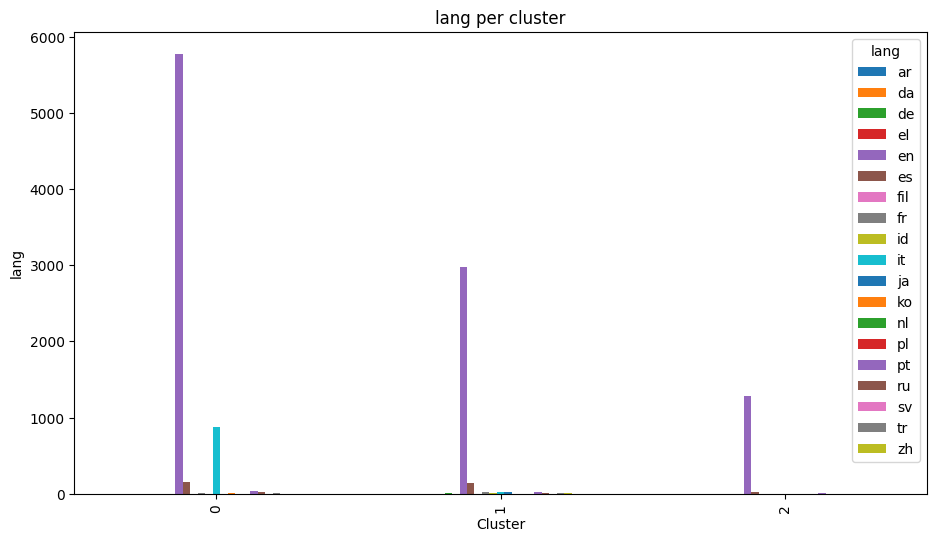

In [30]:
categorical_hist_clusters(df_cat, res_cluster.labels_, "lang", "hierarchical")

Plot the distribution of bot and non-bot user per cluster, we can see that each cluster have a majority of one of the two classes, this is a simptom of the goodness of the cluster method, and the utility of the selected indicator choosen to describe an user profile.

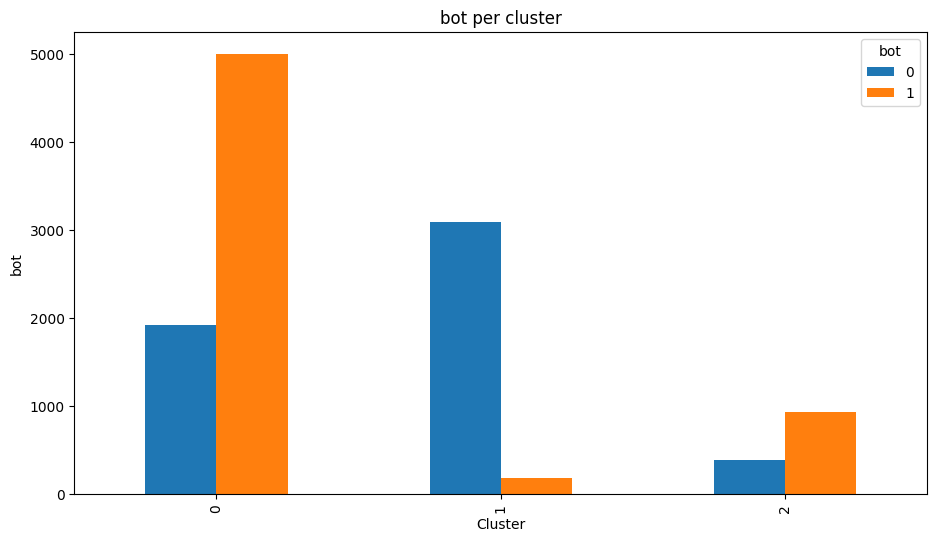

In [31]:
categorical_hist_clusters(df_cat, res_cluster.labels_, "bot", "hierarchical")

compute the entropy of the feature bot in each cluster

In [32]:
entropy_clusters(df_cat, res_cluster.labels_, "bot")

labels
0    0.590312
1    0.215568
2    0.603637
Name: bot, dtype: float64

Plot of the **created_at** feature (grouped by year) of the user in each cluster

0
6915


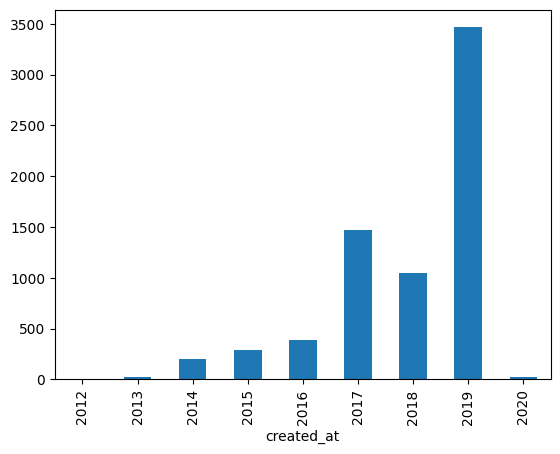

1
3273


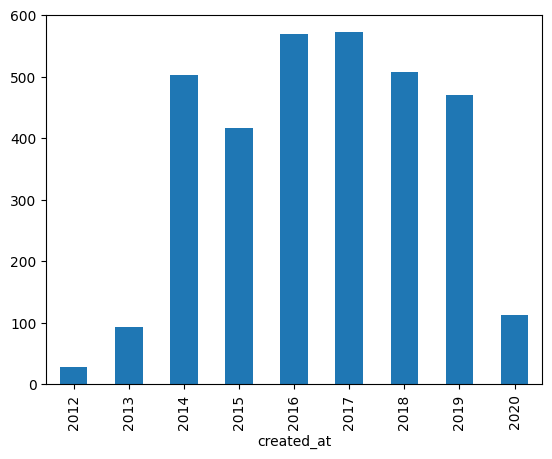

2
1320


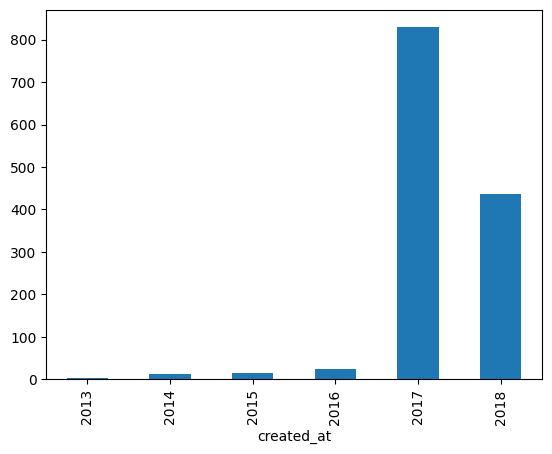

In [33]:
plot_date_feature_clusters(df_cat, res_cluster.labels_, 3)

#### Distribution of Numerical Features per Cluster

We will plot the distribution of the variables in the original space (removing the normalization) and the variables removing log transformation, plotting the boxplots and histogram of each numerical feature for each discovered cluster.

We can see that the distribution of the features are different for each cluster. The Cluster of non-bot majority has more compact features (in log scale).

cluster 0:


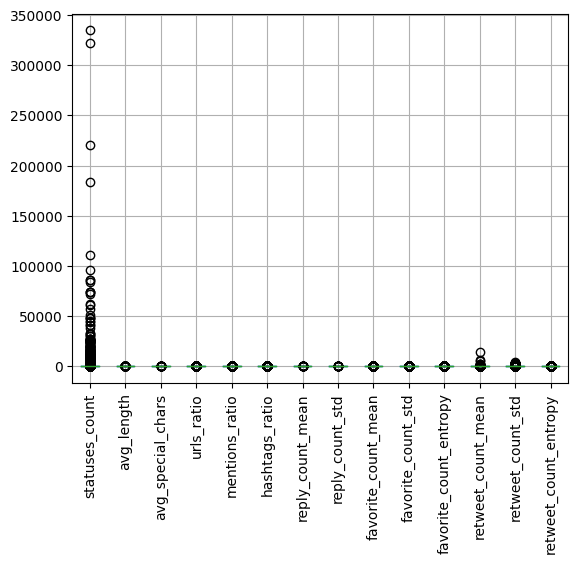

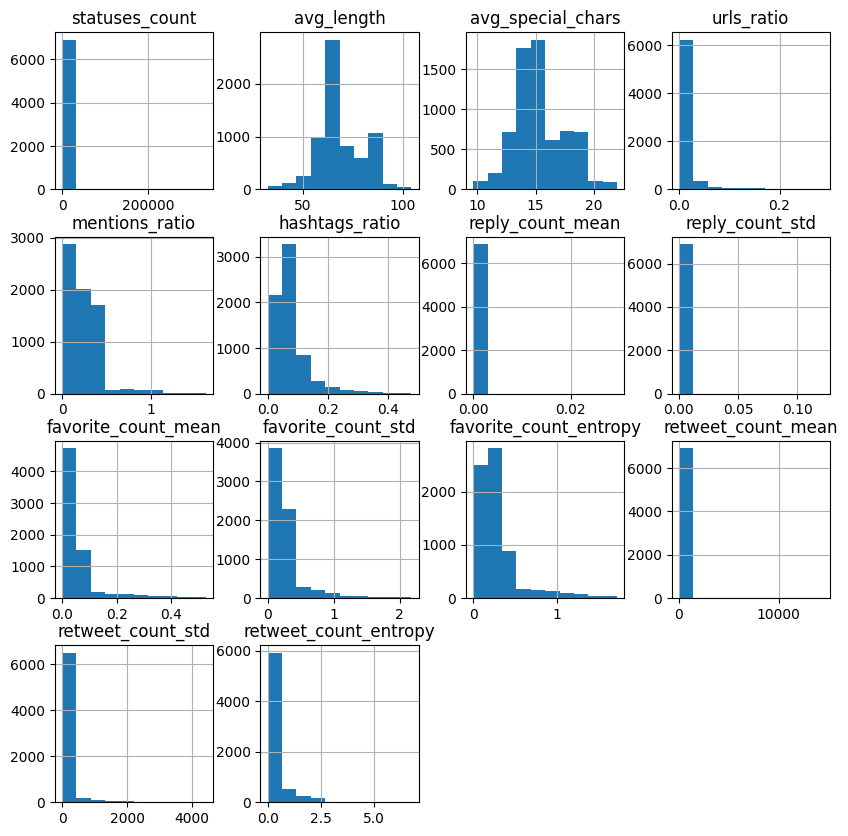

cluster 1:


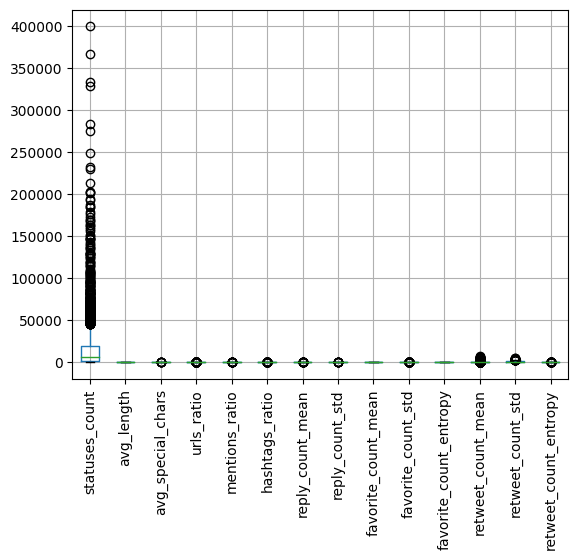

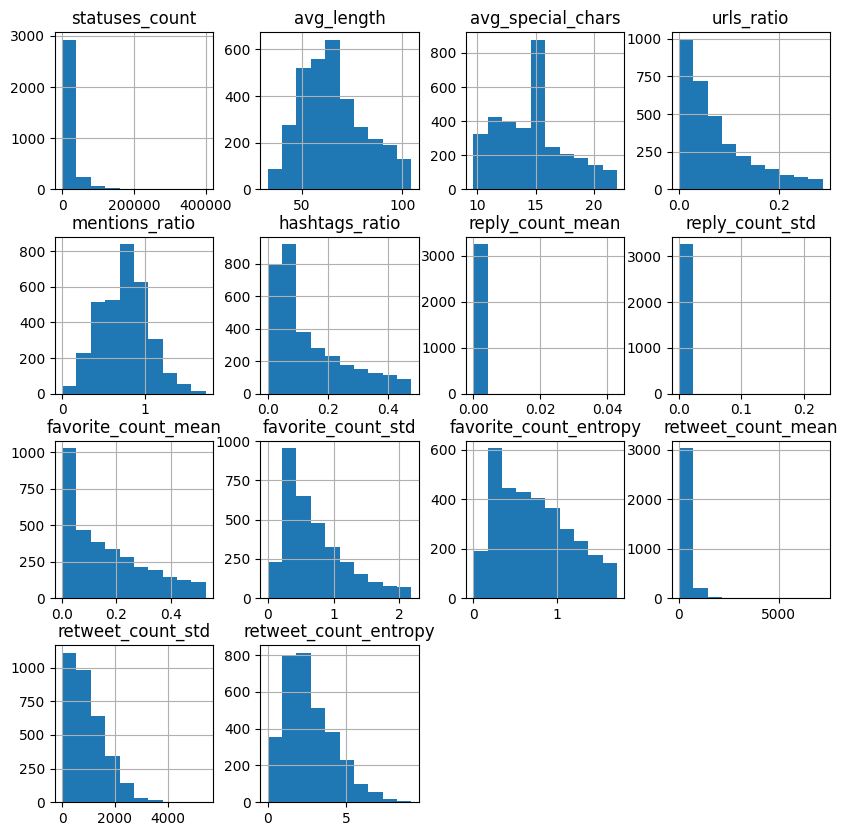

cluster 2:


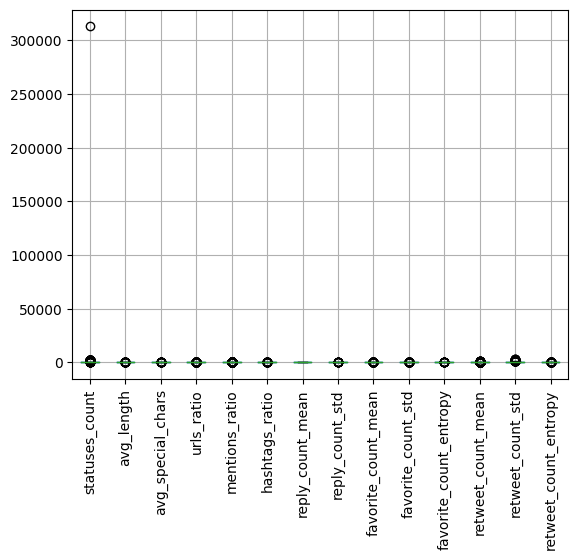

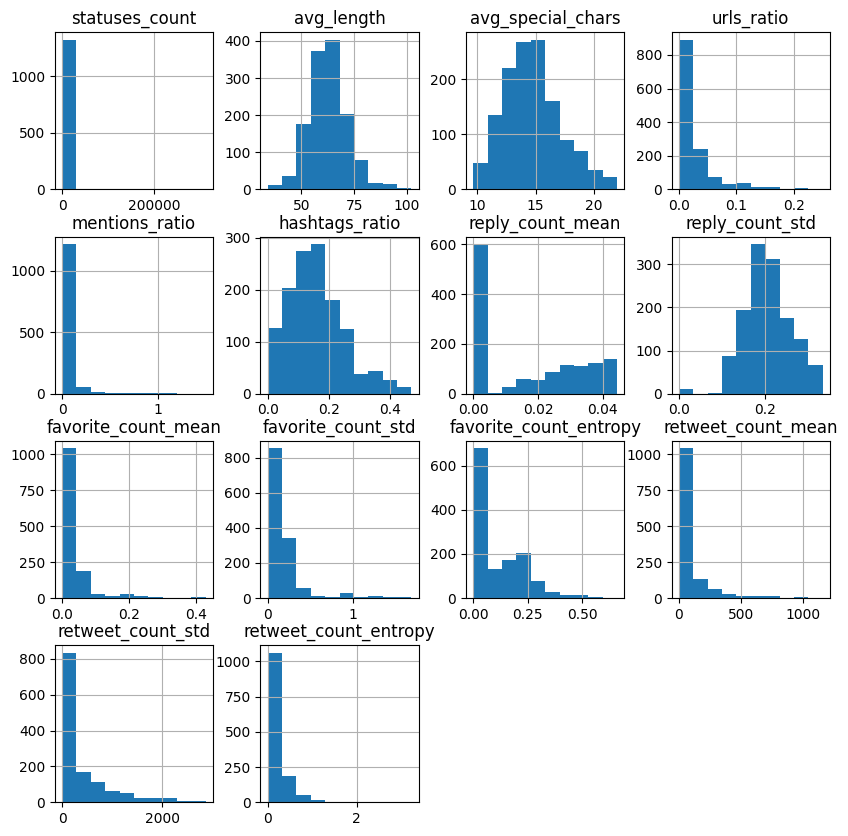

In [34]:
plot_numerical_features_clusters(df_num, res_cluster.labels_, 3)

cluster 0:


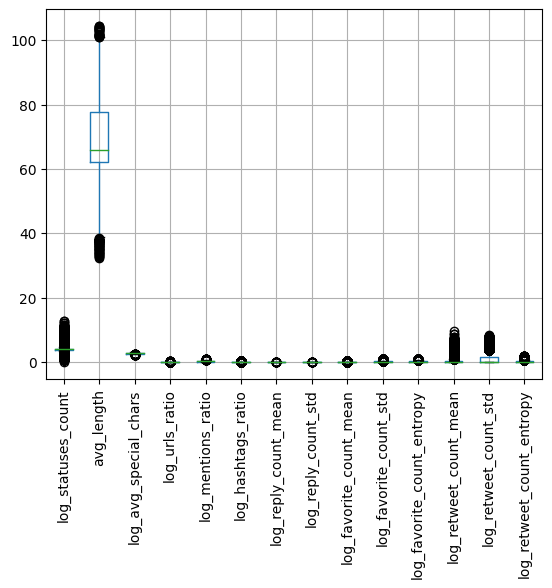

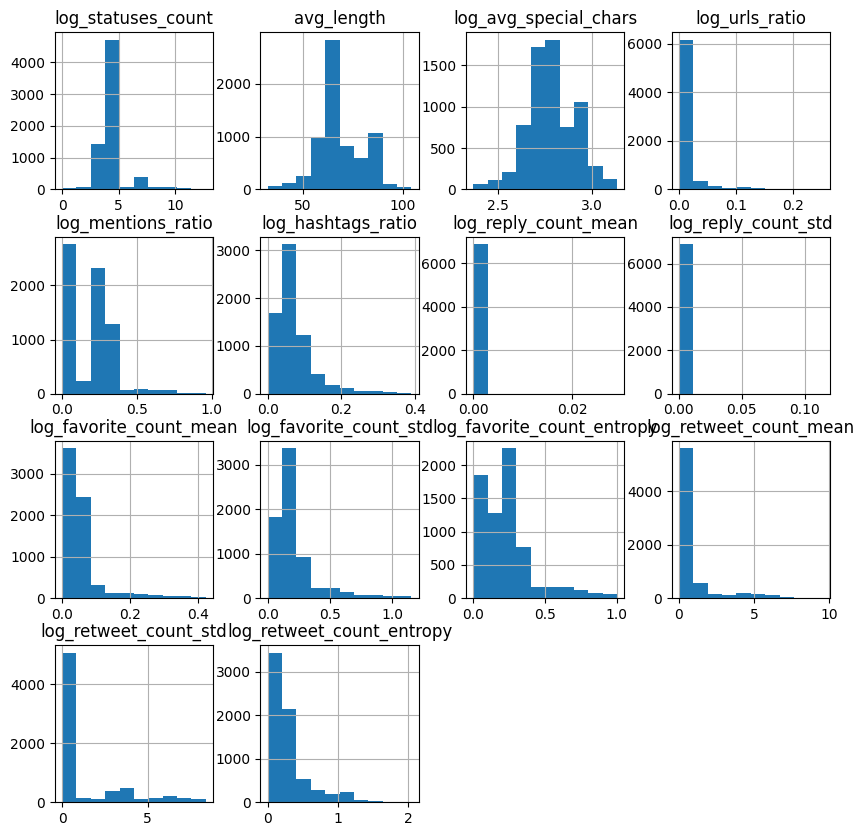

cluster 1:


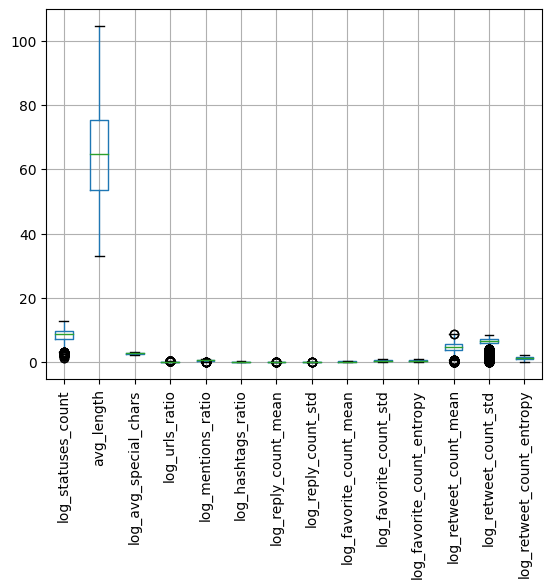

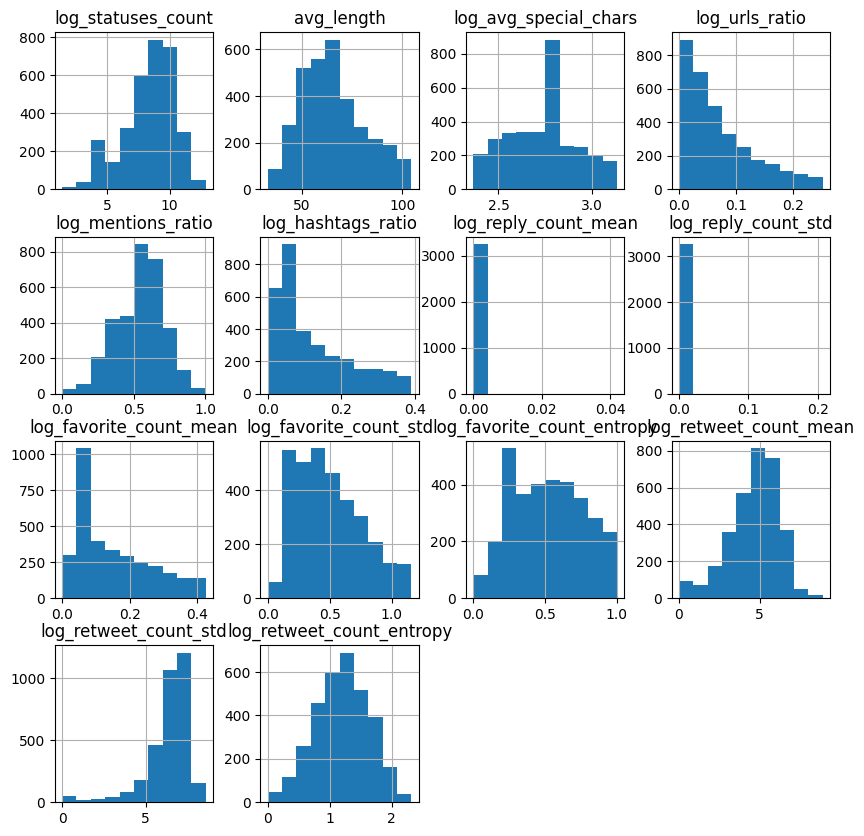

cluster 2:


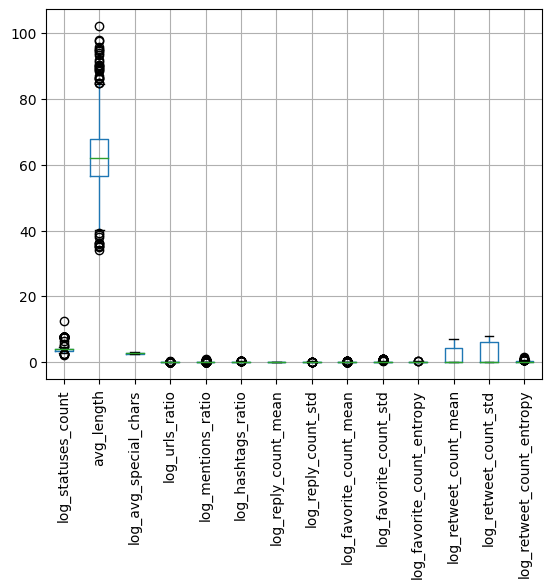

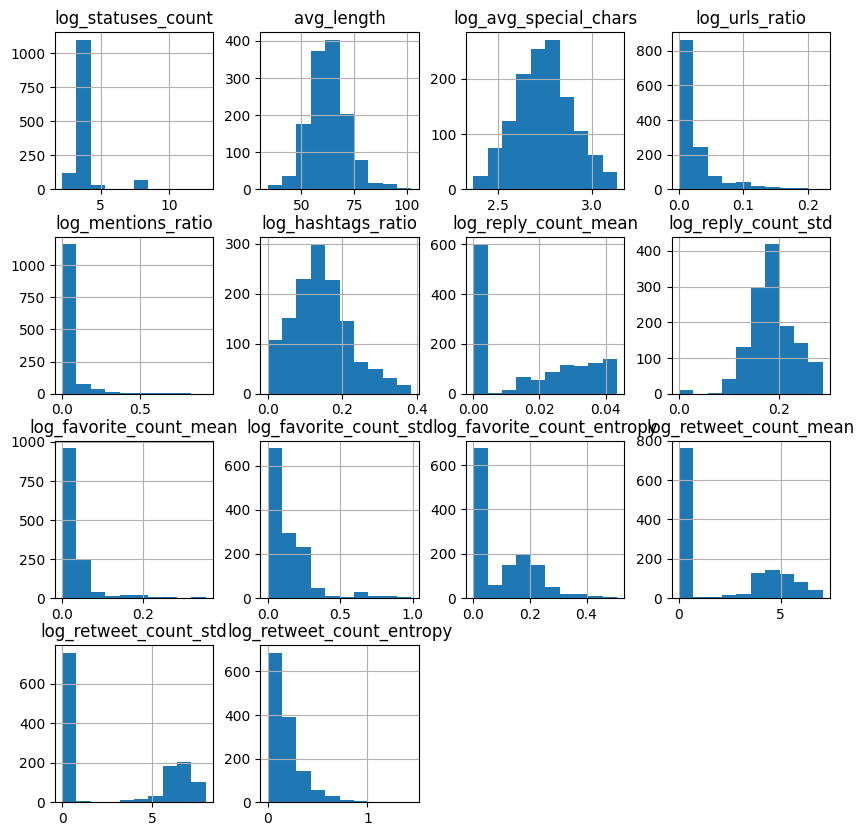

In [35]:
plot_numerical_features_clusters(df_num_not_skewed, res_cluster.labels_, 3)

### Report statistics of each cluster

First print out the std and mean of all the dataset

In [36]:
df_num_not_skewed.describe().loc[["std", "mean"]]

,log_statuses_count,avg_length,log_avg_special_chars,log_urls_ratio,log_mentions_ratio,log_hashtags_ratio,log_reply_count_mean,log_reply_count_std,log_favorite_count_mean,log_favorite_count_std,log_favorite_count_entropy,log_retweet_count_mean,log_retweet_count_std,log_retweet_count_entropy
std,2.397867,12.755296,0.152799,0.048971,0.238413,0.080162,0.007662,0.061613,0.092640,0.250592,0.249932,2.390933,3.053982,0.542972
mean,5.405772,67.100135,2.763813,0.029329,0.268662,0.093713,0.001935,0.021654,0.076374,0.276514,0.292324,1.946724,2.877939,0.525887


Then print out the std and mean of data grouped in clusters

In [37]:
for i in range(3):
    print()
    print(f"cluster {i}:")
    i_samples = res_cluster.labels_==i
    print(df_num_not_skewed[i_samples].describe().loc[["std", "mean"]])
    print()
    print()


cluster 0:
      log_statuses_count  avg_length  log_avg_special_chars  log_urls_ratio  \
std             1.303182   11.326924               0.131452        0.027722   
mean            4.297195   68.657308               2.784357        0.010968   

      log_mentions_ratio  log_hashtags_ratio  log_reply_count_mean  \
std             0.160307            0.056432              0.000663   
mean            0.180798            0.069345              0.000030   

      log_reply_count_std  log_favorite_count_mean  log_favorite_count_std  \
std              0.003849                 0.064704                0.182636   
mean             0.000187                 0.051341                0.200710   

      log_favorite_count_entropy  log_retweet_count_mean  \
std                     0.190918                1.438226   
mean                    0.223172                0.646564   

      log_retweet_count_std  log_retweet_count_entropy  
std                2.058407                   0.299143  
mean     

### Scatter Plots

Plotting the scatter plot of each pair of numerical features, coloring out the points with respect the cluster number of each sample

statuses_count - avg_length


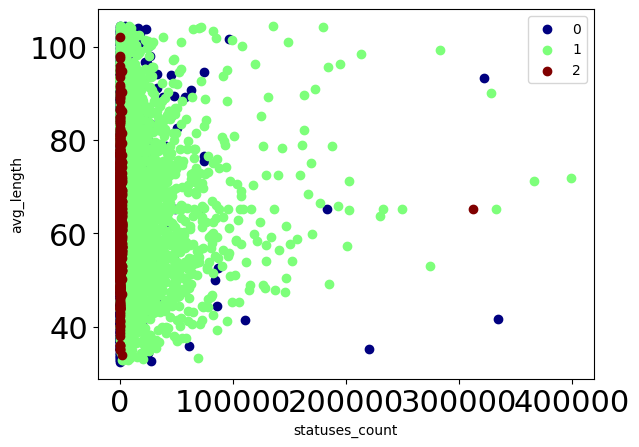

statuses_count - avg_special_chars


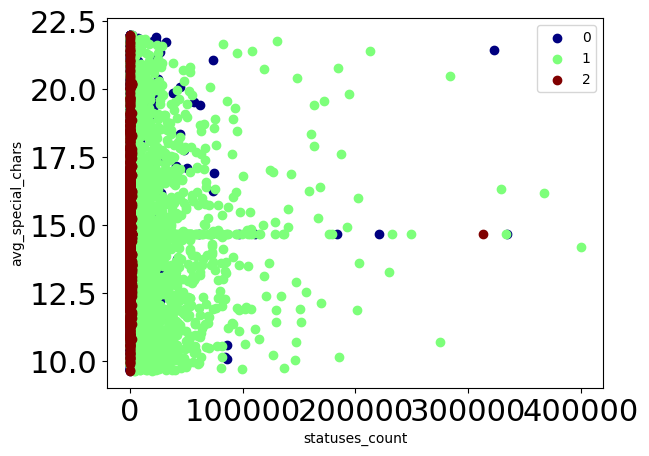

statuses_count - urls_ratio


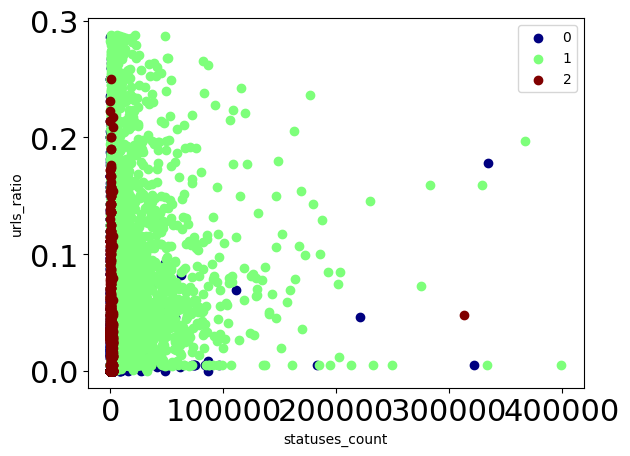

statuses_count - mentions_ratio


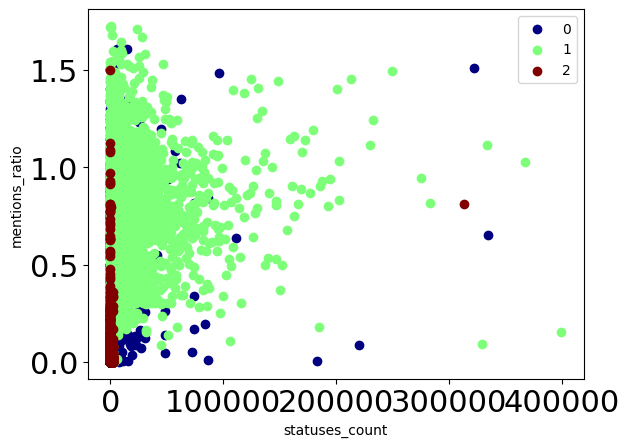

statuses_count - hashtags_ratio


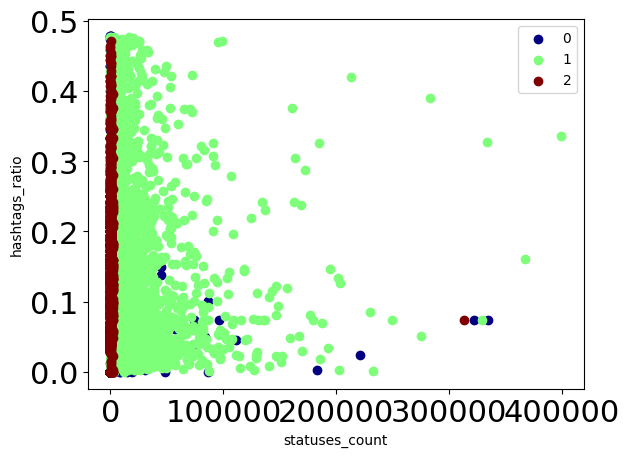

statuses_count - reply_count_mean


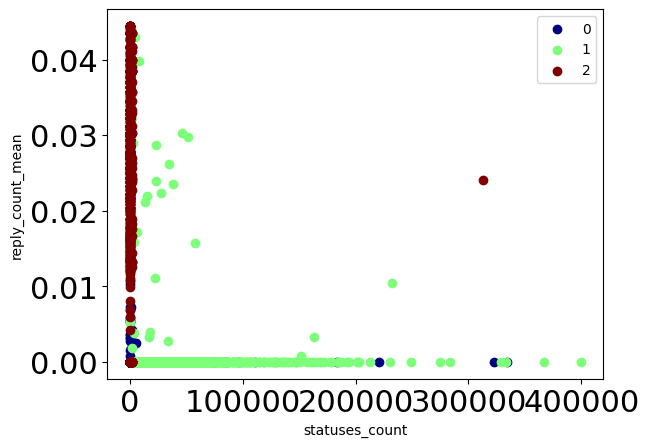

statuses_count - reply_count_std


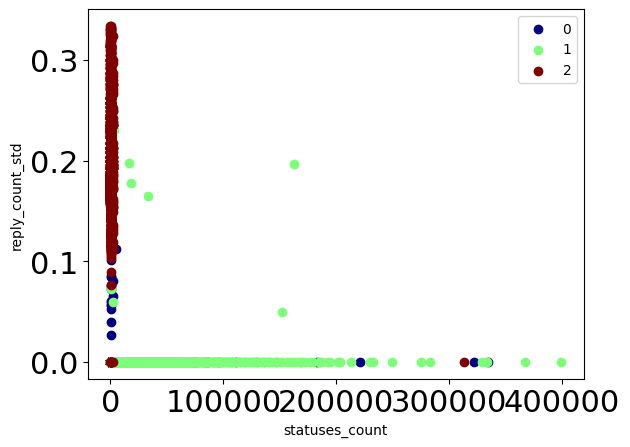

statuses_count - favorite_count_mean


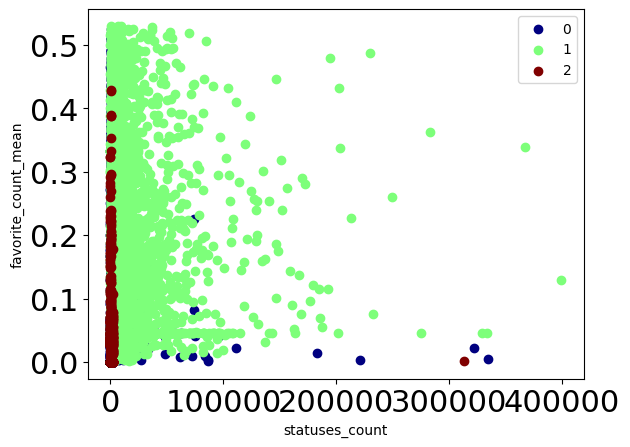

statuses_count - favorite_count_std


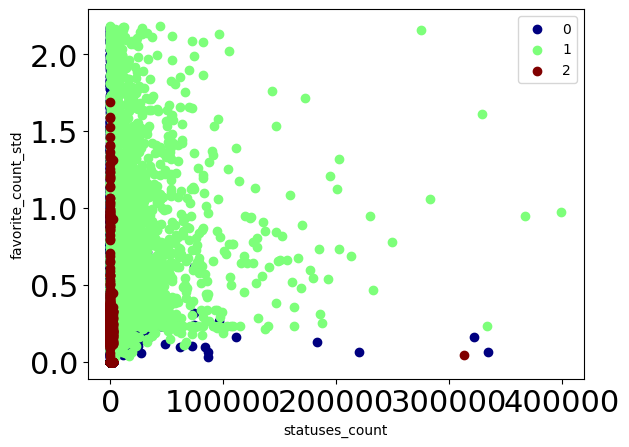

statuses_count - favorite_count_entropy


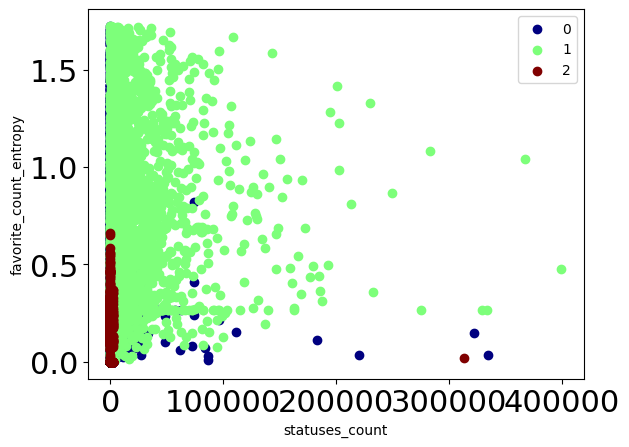

statuses_count - retweet_count_mean


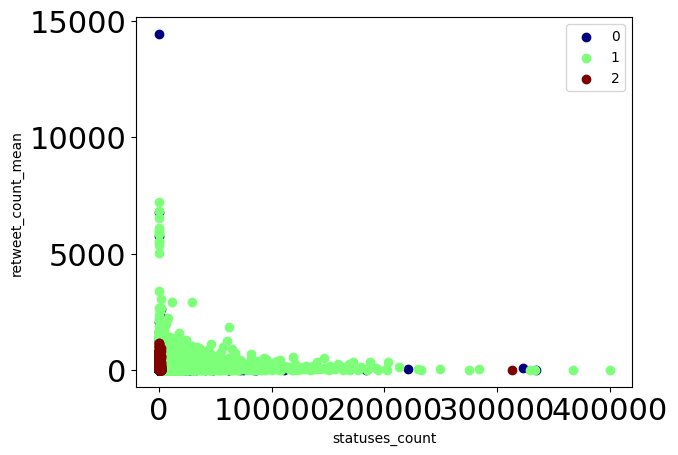

statuses_count - retweet_count_std


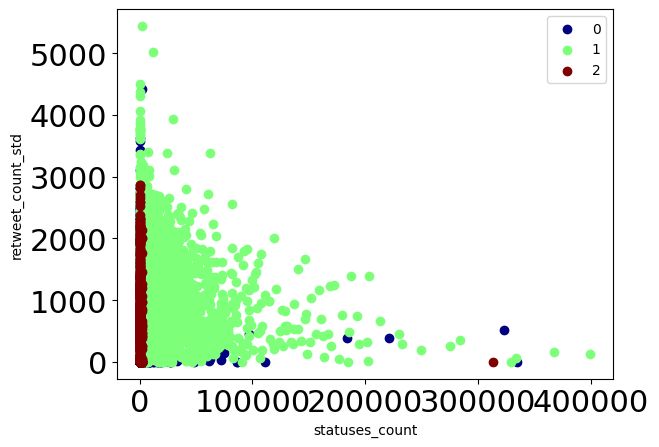

statuses_count - retweet_count_entropy


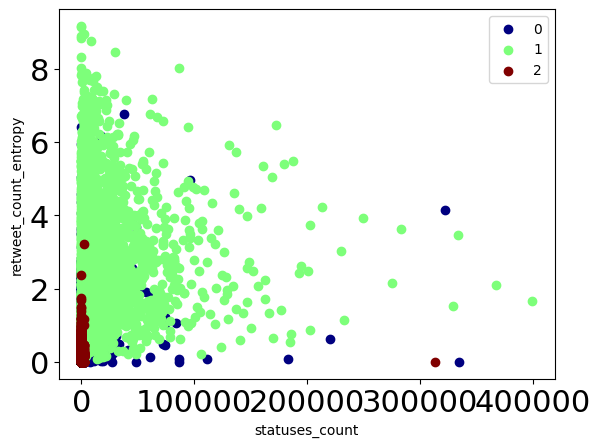

avg_length - avg_special_chars


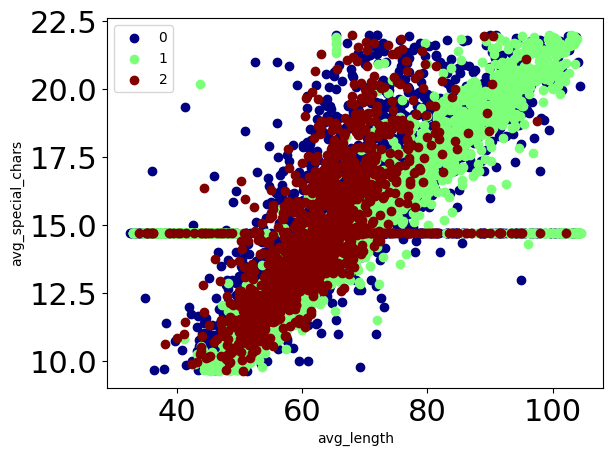

avg_length - urls_ratio


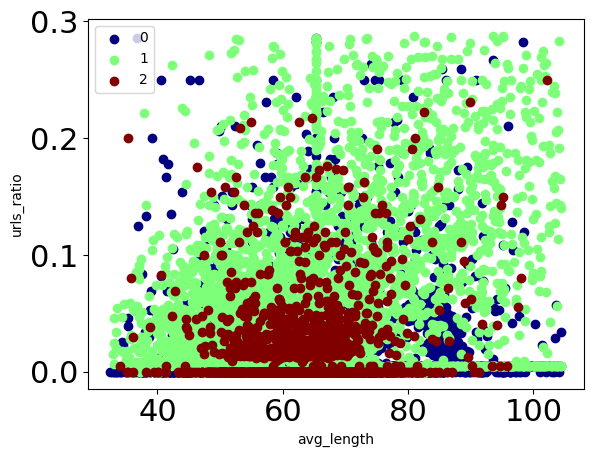

avg_length - mentions_ratio


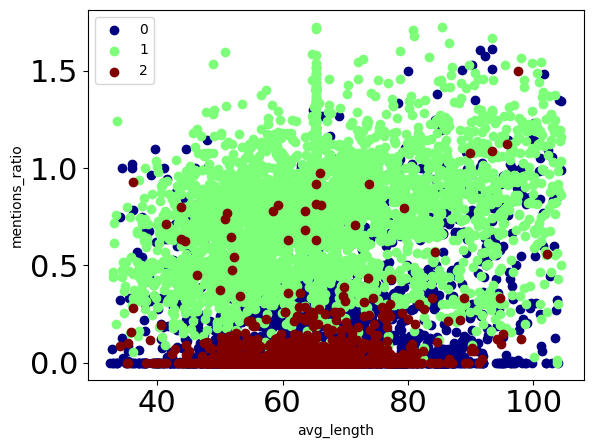

avg_length - hashtags_ratio


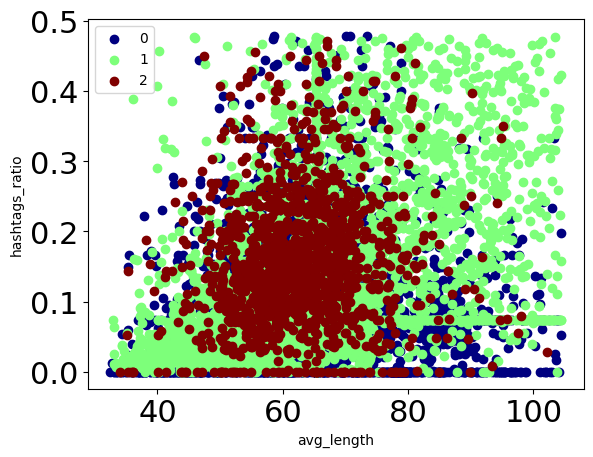

avg_length - reply_count_mean


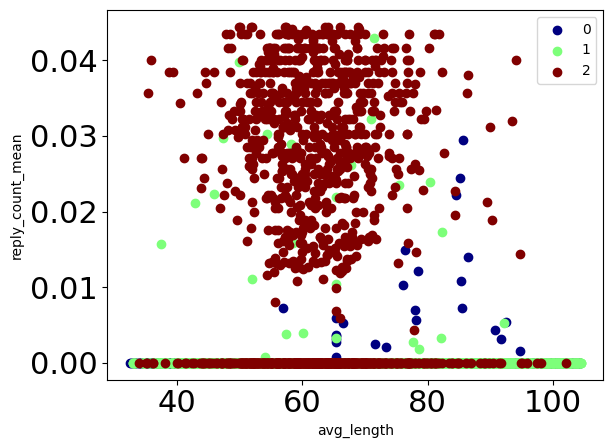

avg_length - reply_count_std


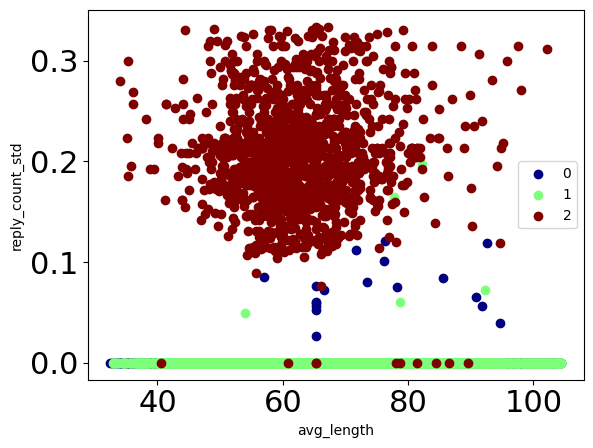

avg_length - favorite_count_mean


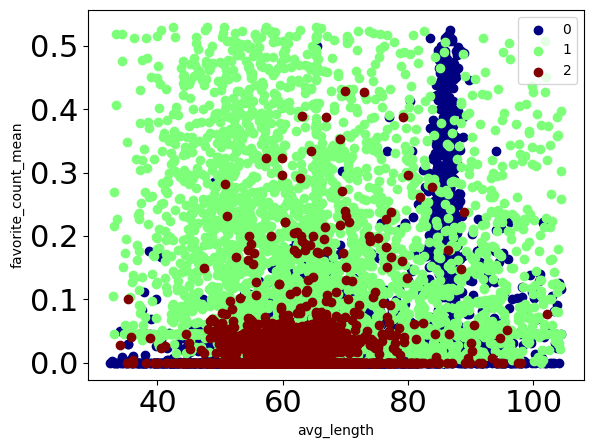

avg_length - favorite_count_std


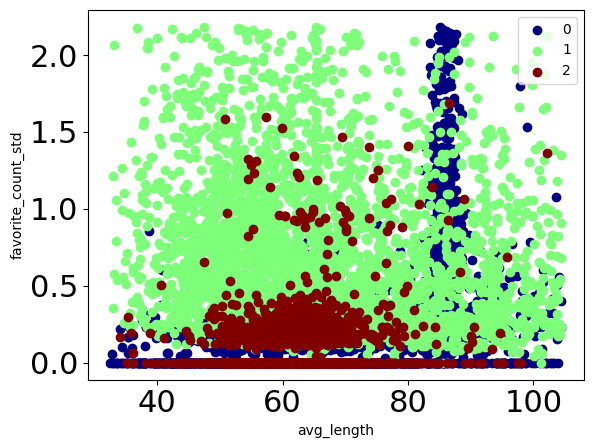

avg_length - favorite_count_entropy


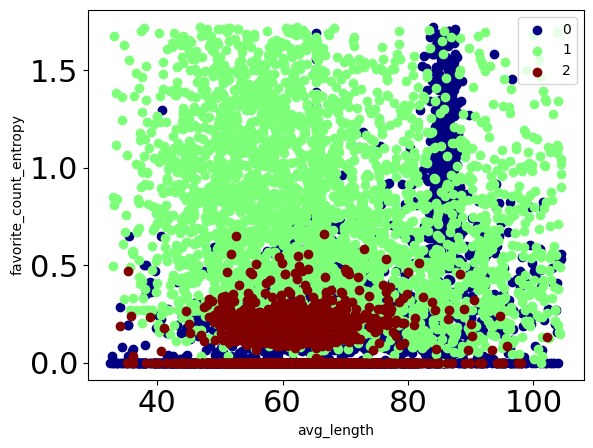

avg_length - retweet_count_mean


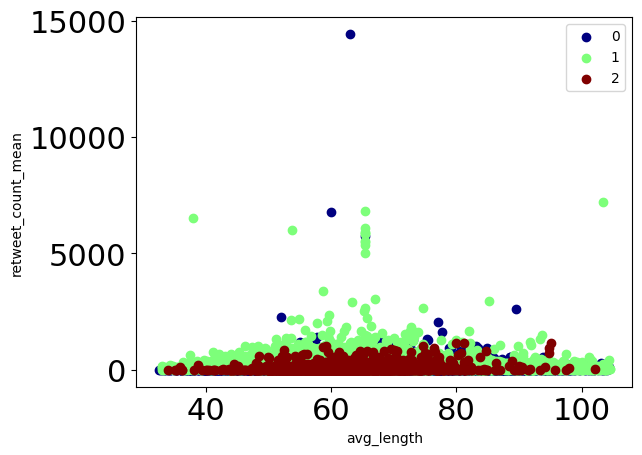

avg_length - retweet_count_std


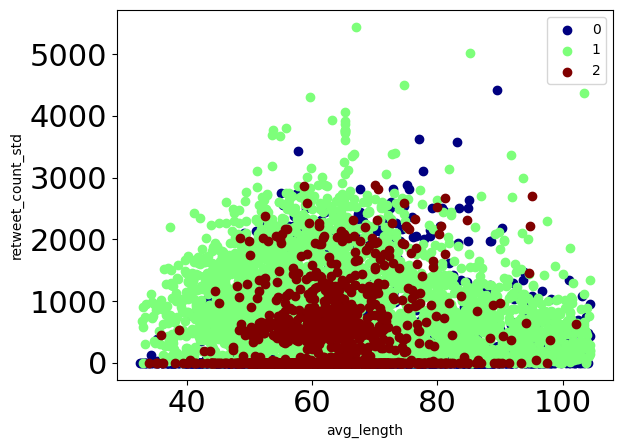

avg_length - retweet_count_entropy


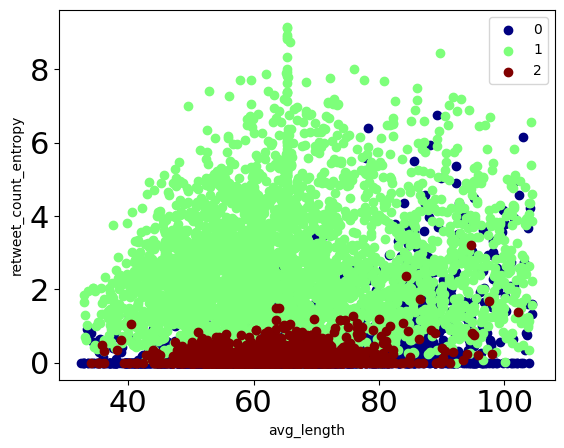

avg_special_chars - urls_ratio


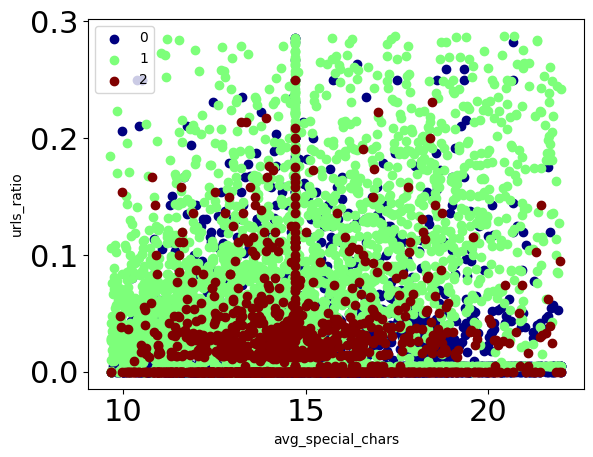

avg_special_chars - mentions_ratio


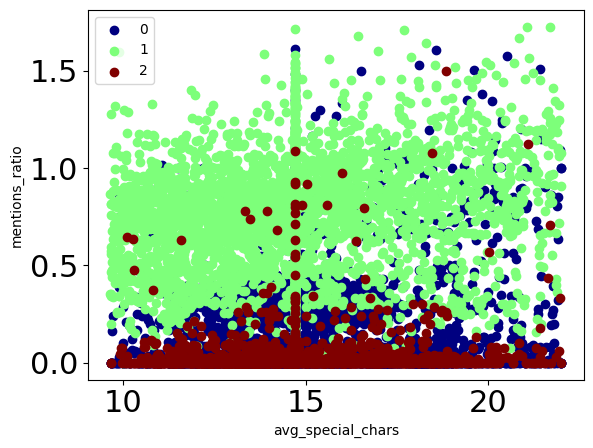

avg_special_chars - hashtags_ratio


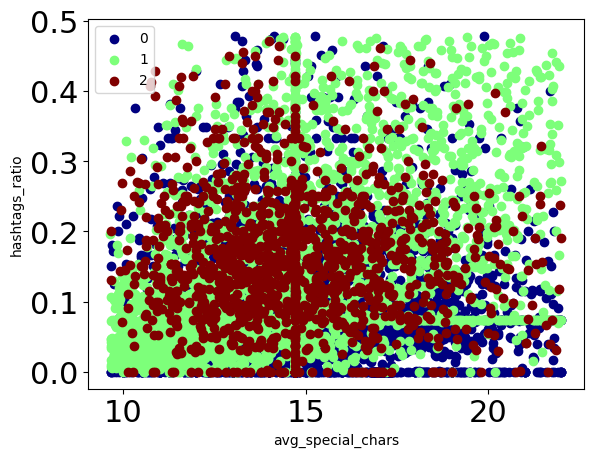

avg_special_chars - reply_count_mean


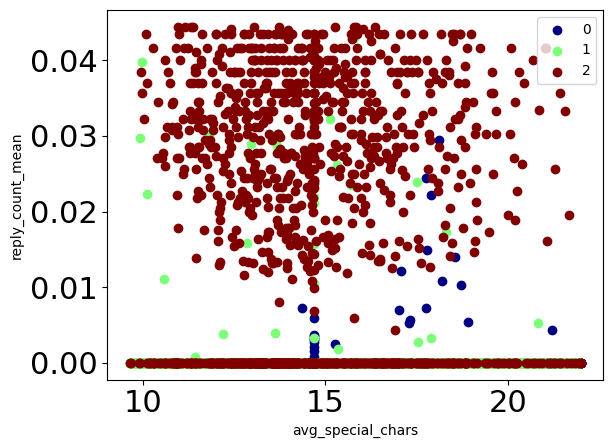

avg_special_chars - reply_count_std


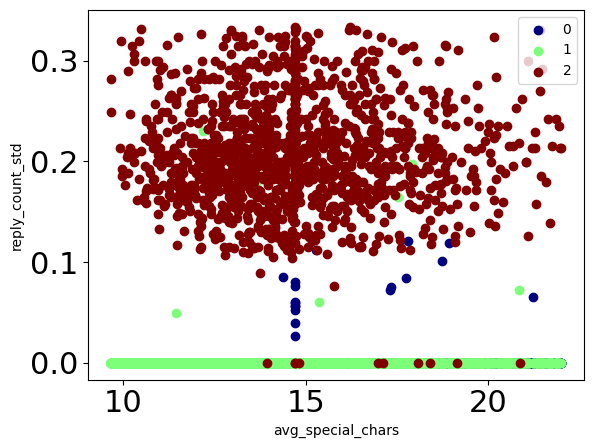

avg_special_chars - favorite_count_mean


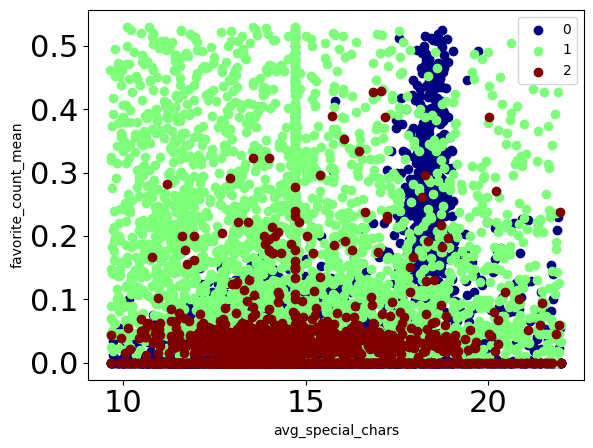

avg_special_chars - favorite_count_std


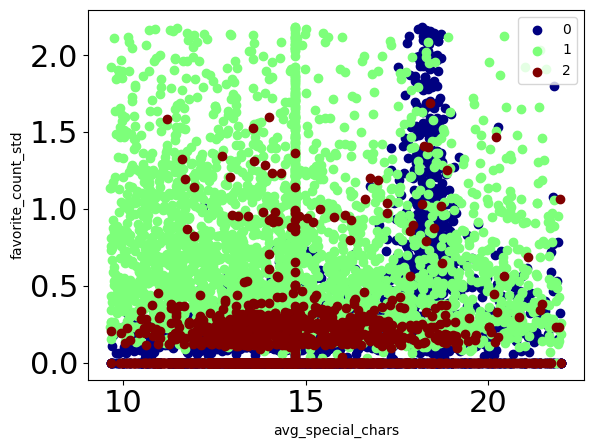

avg_special_chars - favorite_count_entropy


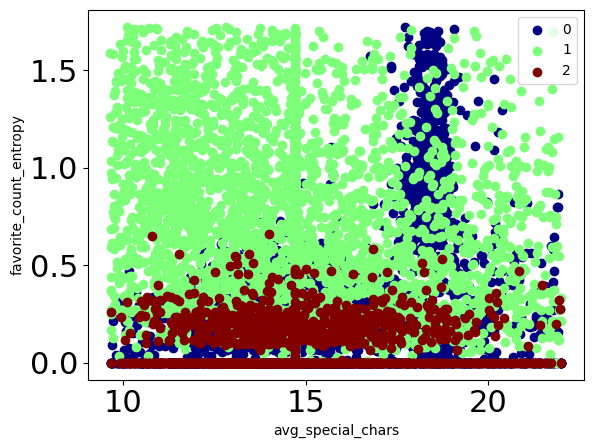

avg_special_chars - retweet_count_mean


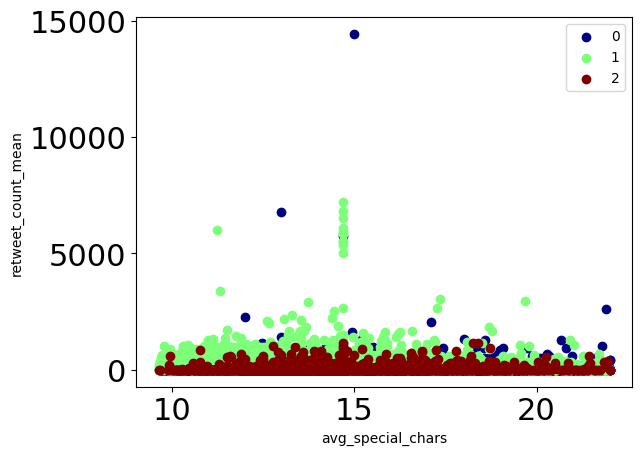

avg_special_chars - retweet_count_std


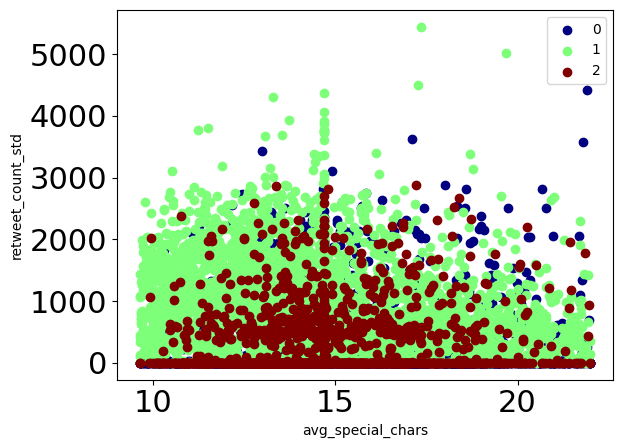

avg_special_chars - retweet_count_entropy


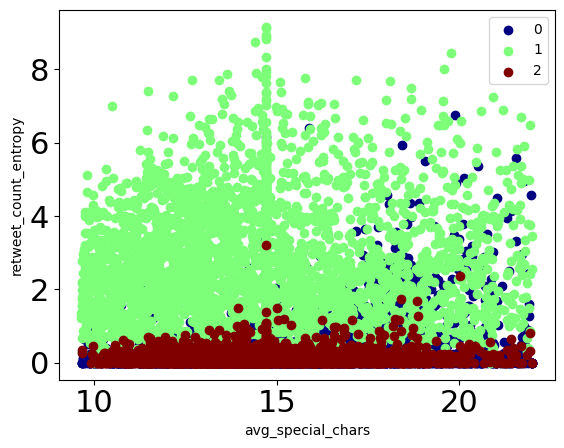

urls_ratio - mentions_ratio


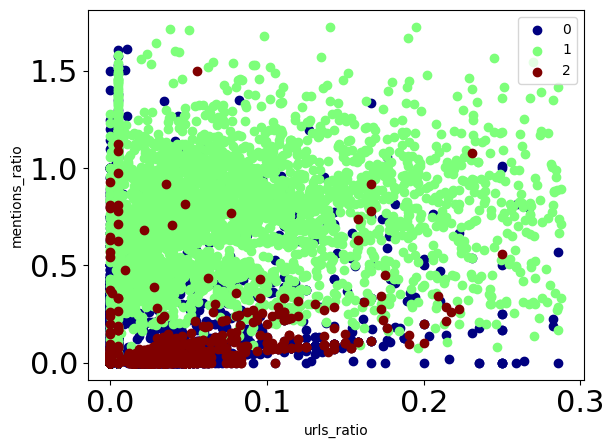

urls_ratio - hashtags_ratio


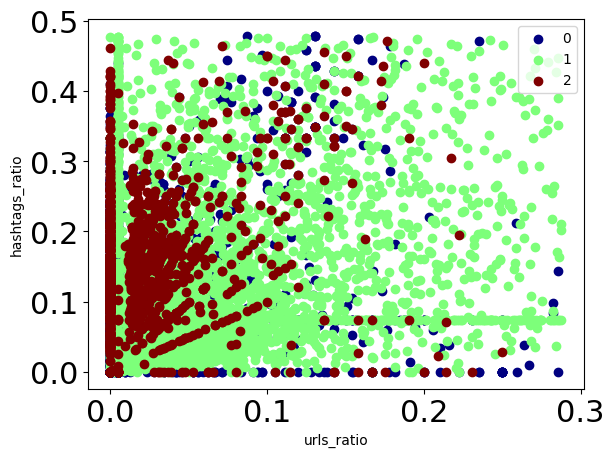

urls_ratio - reply_count_mean


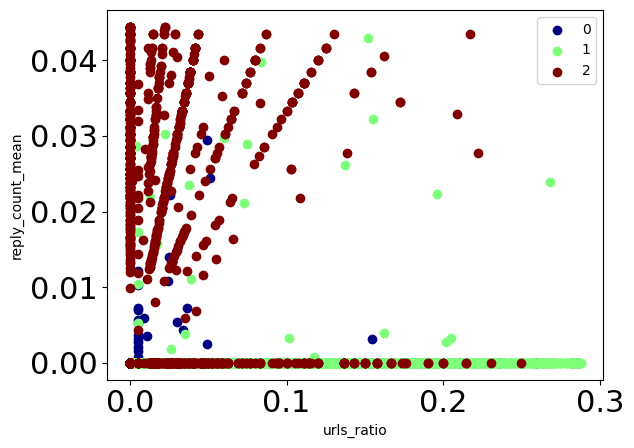

urls_ratio - reply_count_std


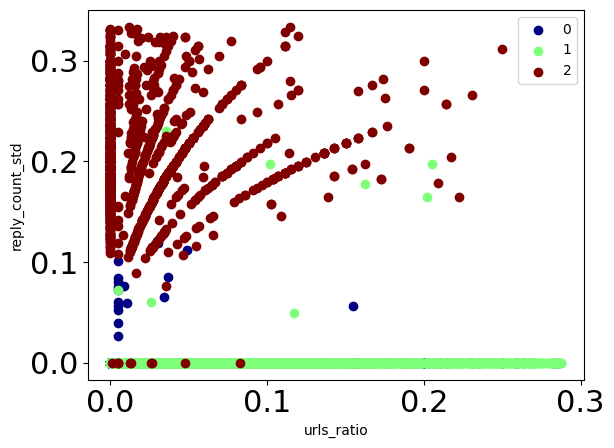

urls_ratio - favorite_count_mean


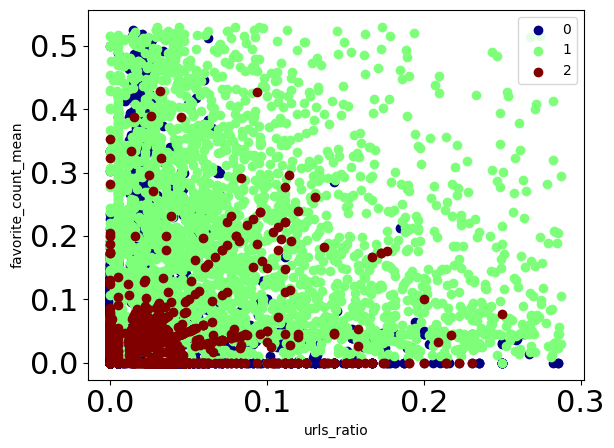

urls_ratio - favorite_count_std


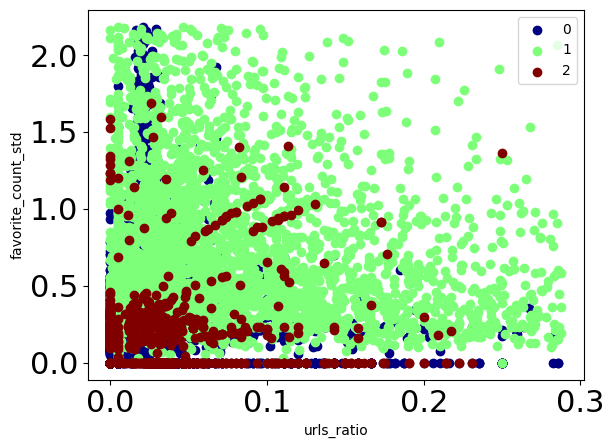

urls_ratio - favorite_count_entropy


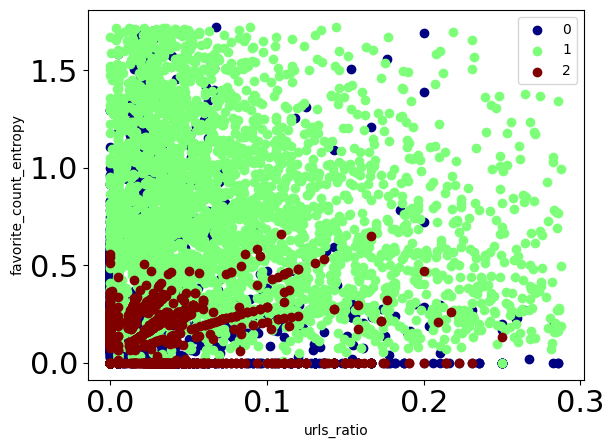

urls_ratio - retweet_count_mean


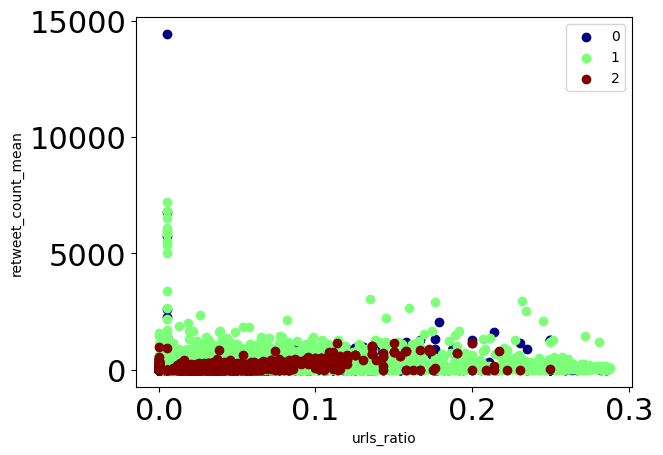

urls_ratio - retweet_count_std


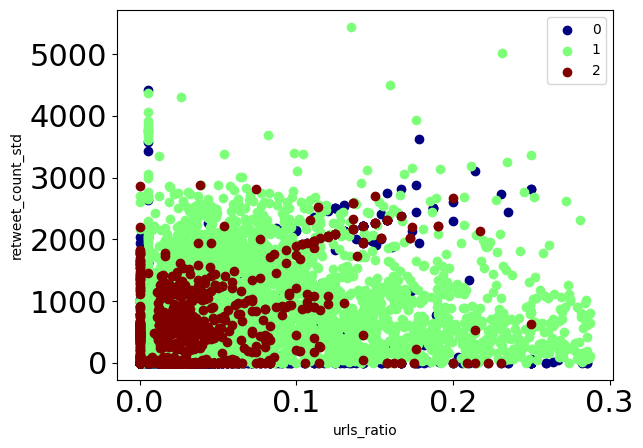

urls_ratio - retweet_count_entropy


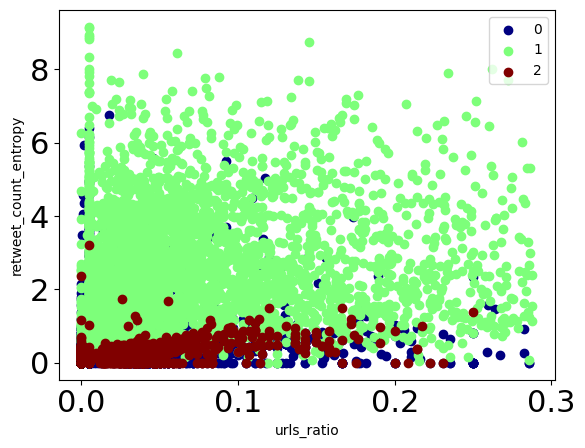

mentions_ratio - hashtags_ratio


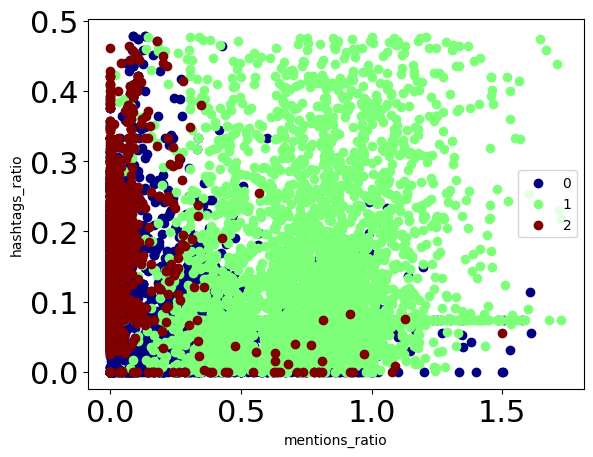

mentions_ratio - reply_count_mean


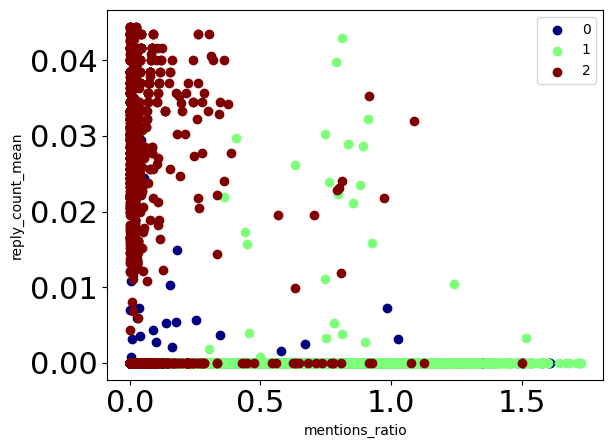

mentions_ratio - reply_count_std


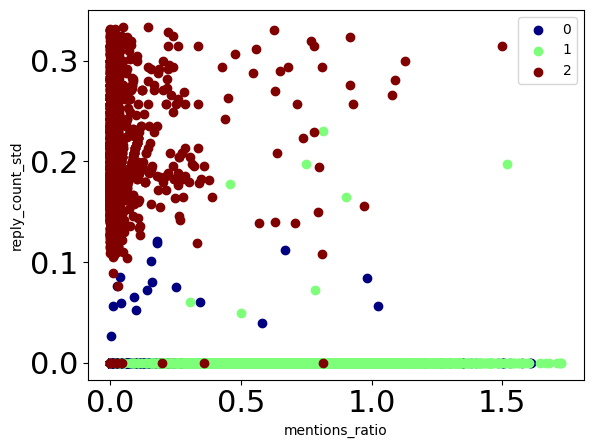

mentions_ratio - favorite_count_mean


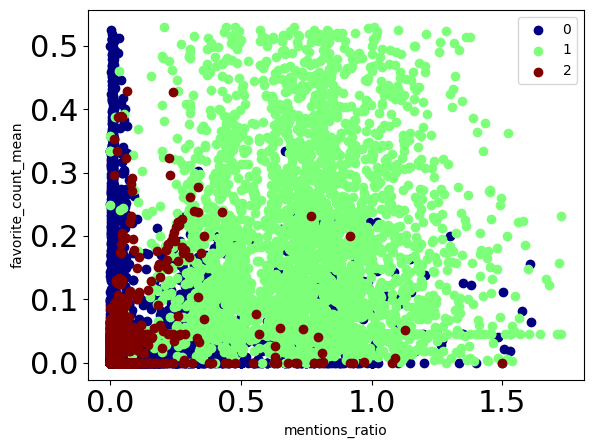

mentions_ratio - favorite_count_std


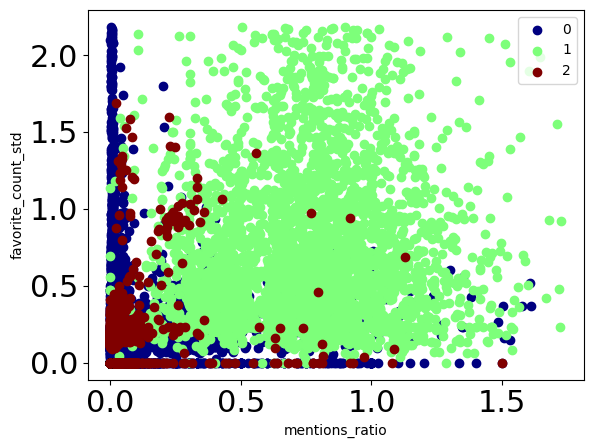

mentions_ratio - favorite_count_entropy


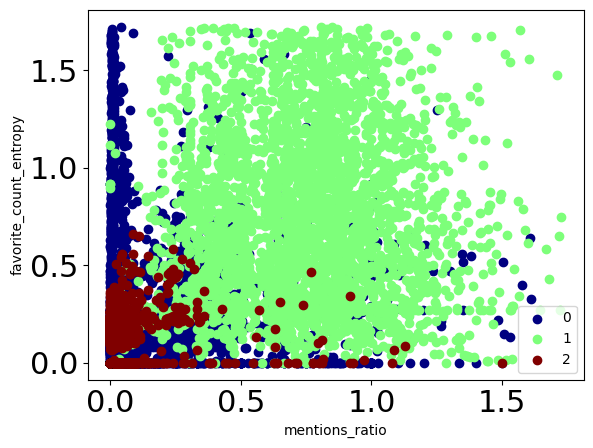

mentions_ratio - retweet_count_mean


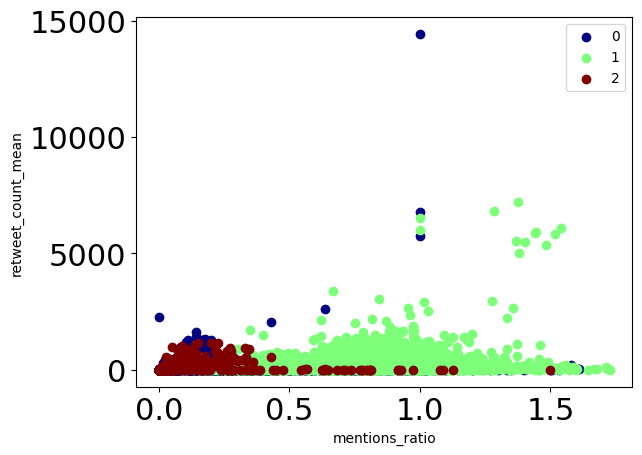

mentions_ratio - retweet_count_std


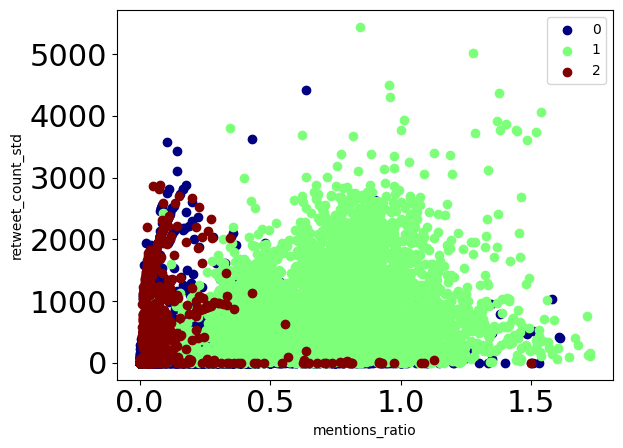

mentions_ratio - retweet_count_entropy


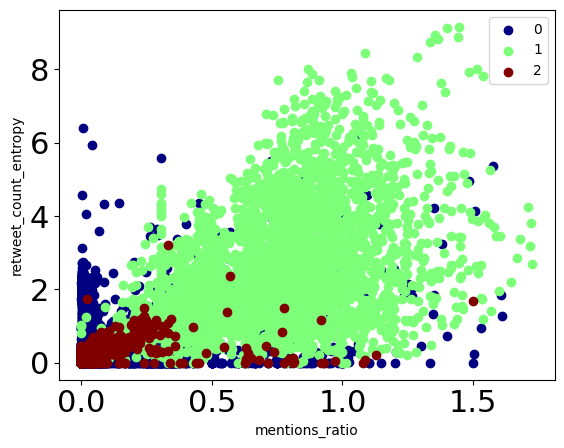

hashtags_ratio - reply_count_mean


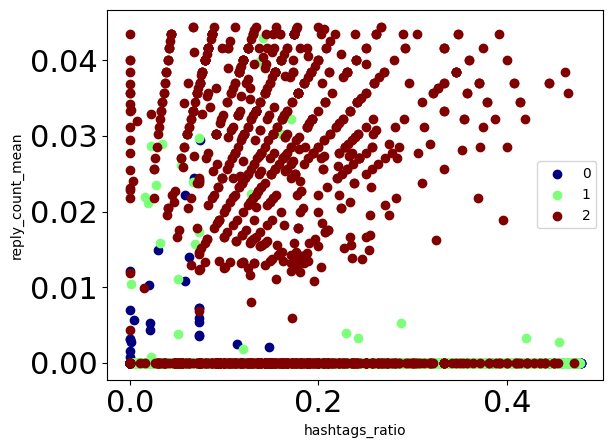

hashtags_ratio - reply_count_std


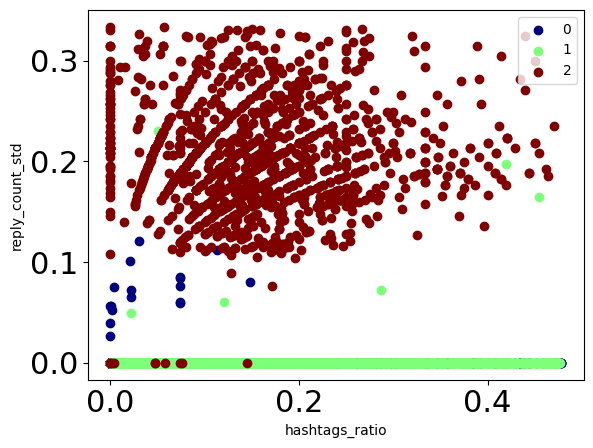

hashtags_ratio - favorite_count_mean


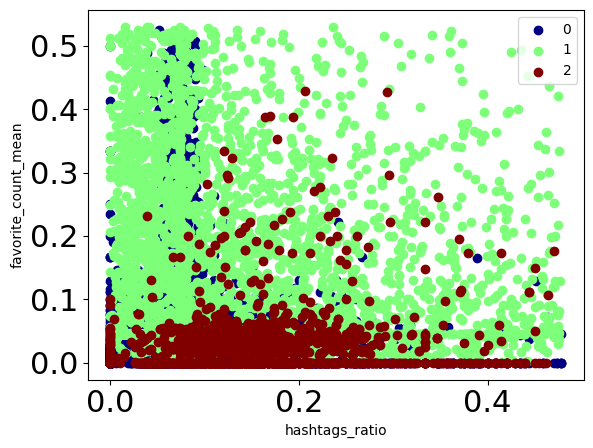

hashtags_ratio - favorite_count_std


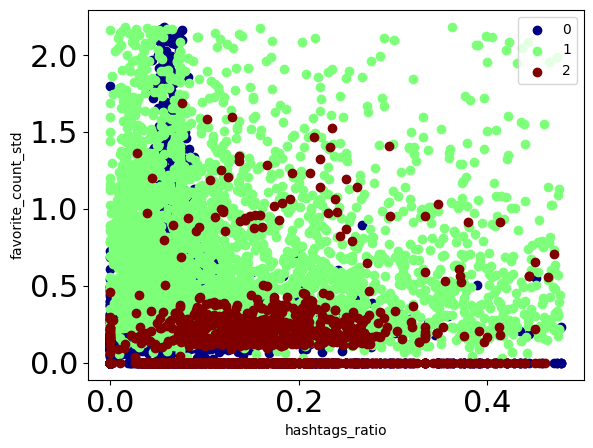

hashtags_ratio - favorite_count_entropy


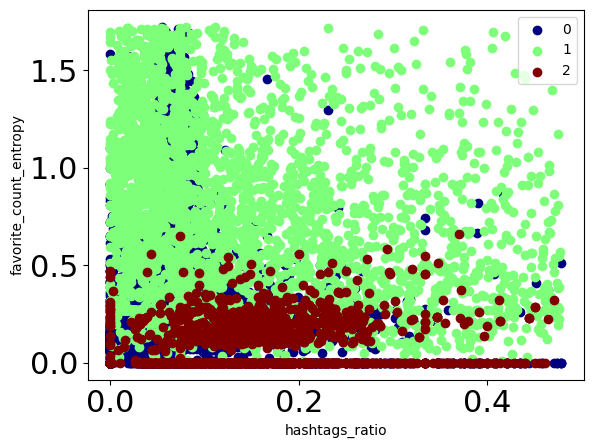

hashtags_ratio - retweet_count_mean


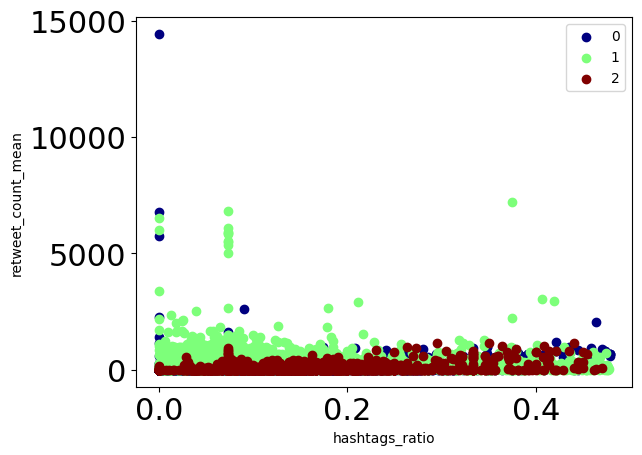

hashtags_ratio - retweet_count_std


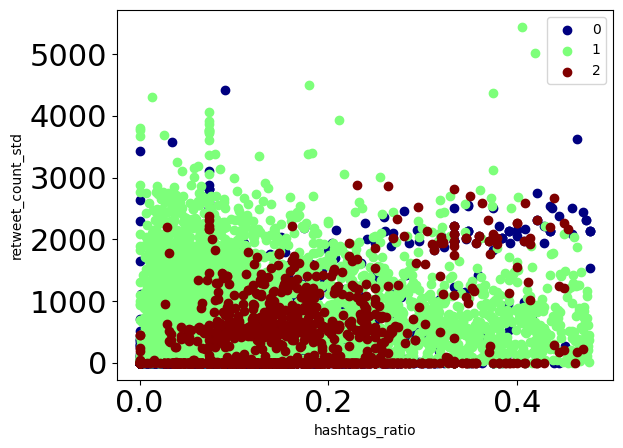

hashtags_ratio - retweet_count_entropy


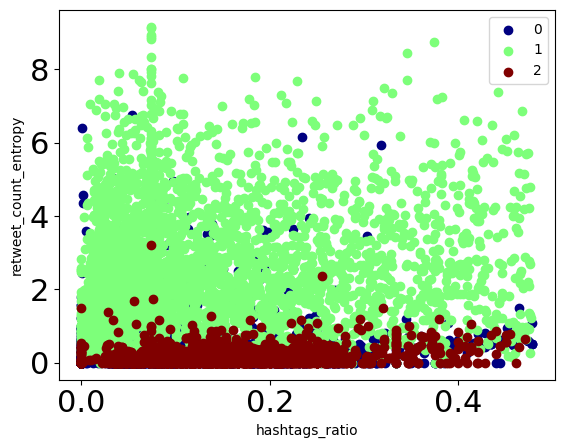

reply_count_mean - reply_count_std


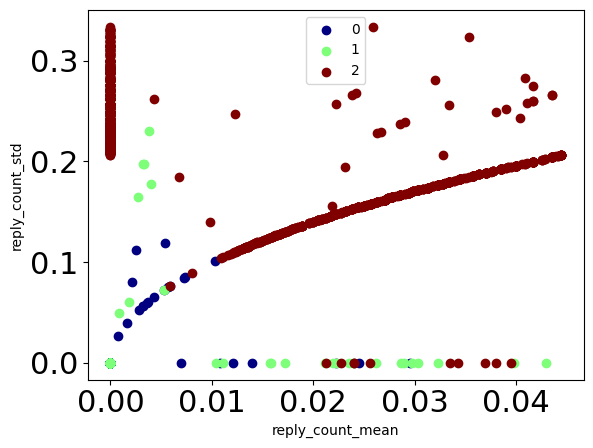

reply_count_mean - favorite_count_mean


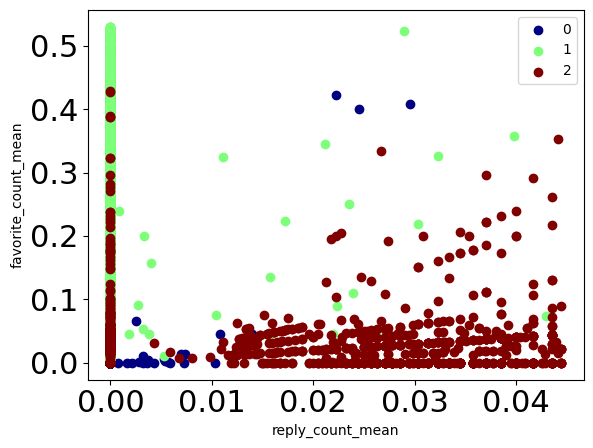

reply_count_mean - favorite_count_std


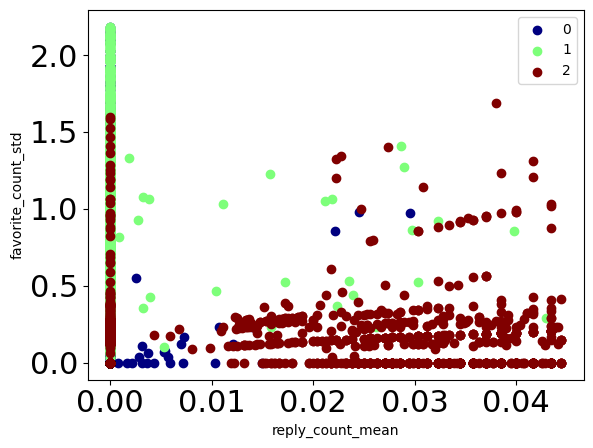

reply_count_mean - favorite_count_entropy


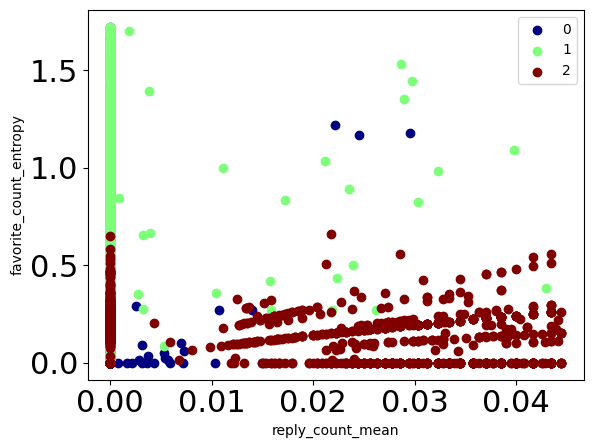

reply_count_mean - retweet_count_mean


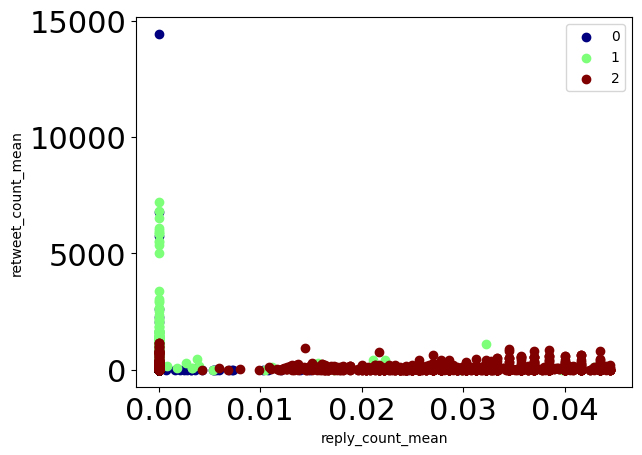

reply_count_mean - retweet_count_std


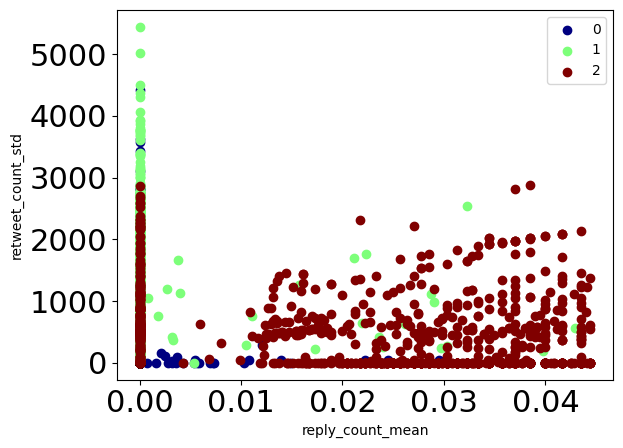

reply_count_mean - retweet_count_entropy


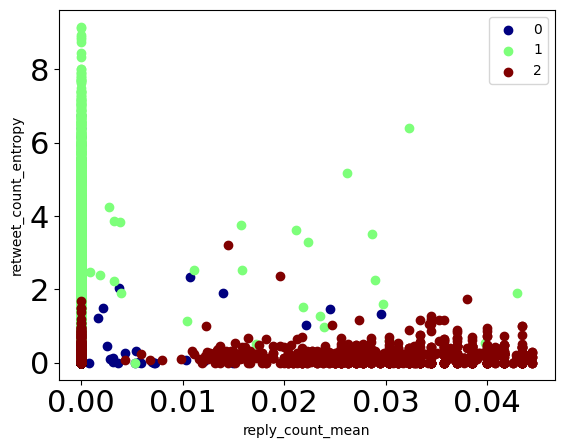

reply_count_std - favorite_count_mean


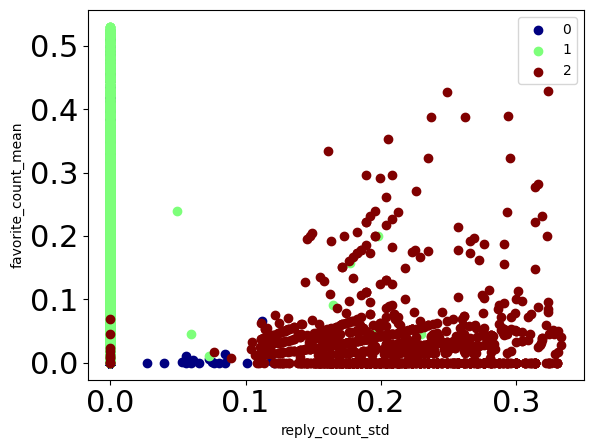

reply_count_std - favorite_count_std


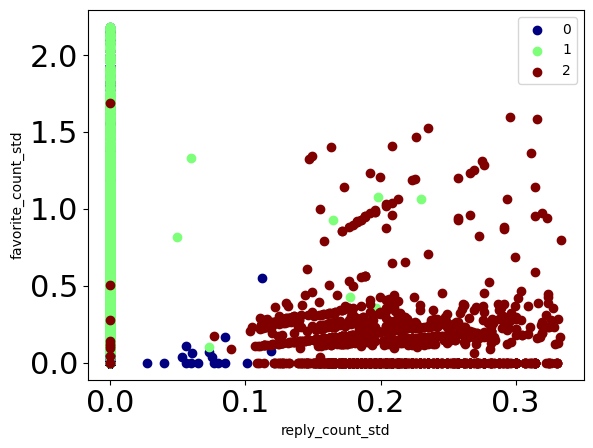

reply_count_std - favorite_count_entropy


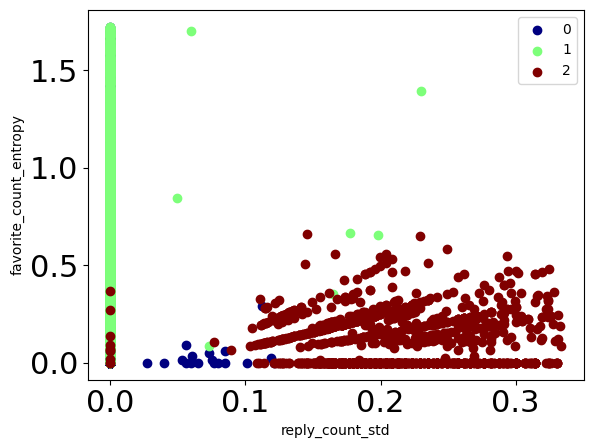

reply_count_std - retweet_count_mean


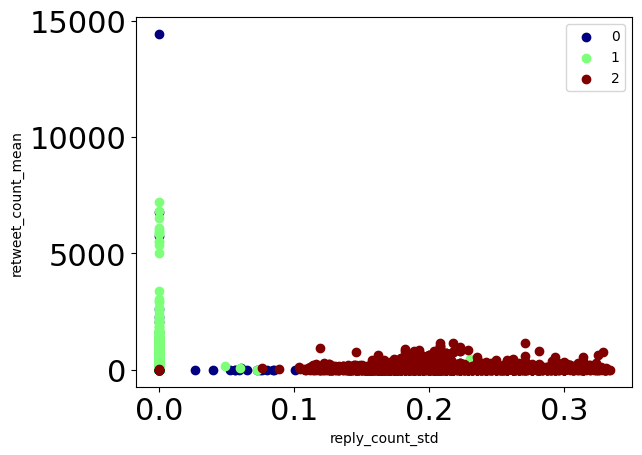

reply_count_std - retweet_count_std


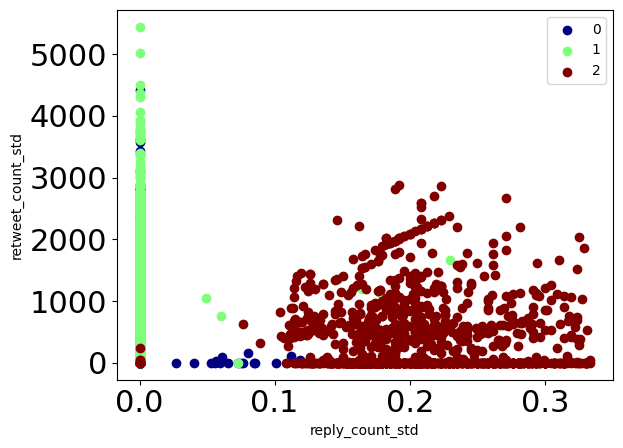

reply_count_std - retweet_count_entropy


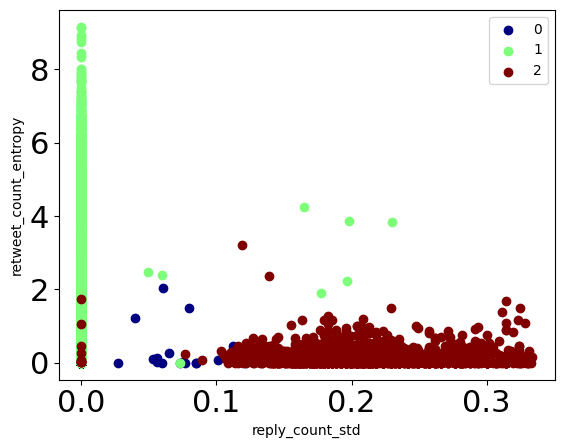

favorite_count_mean - favorite_count_std


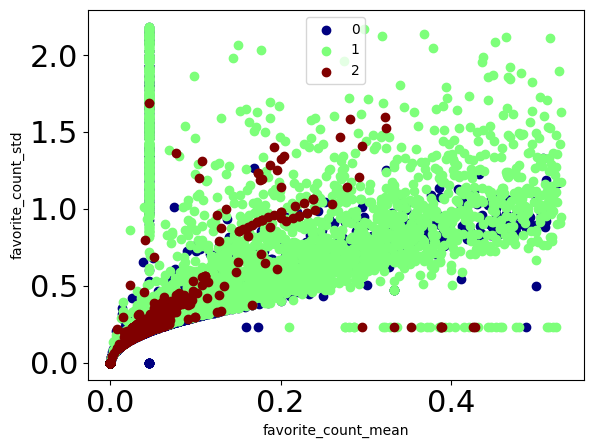

favorite_count_mean - favorite_count_entropy


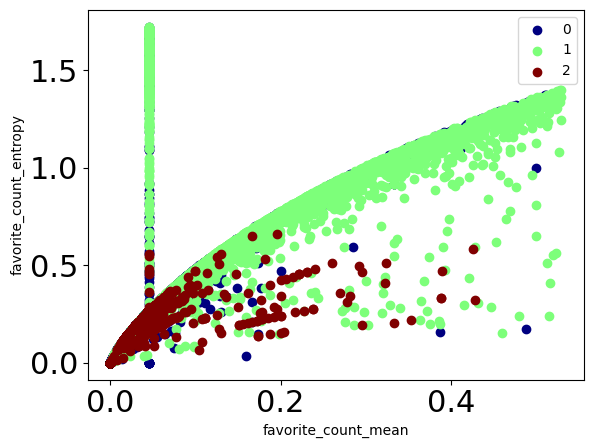

favorite_count_mean - retweet_count_mean


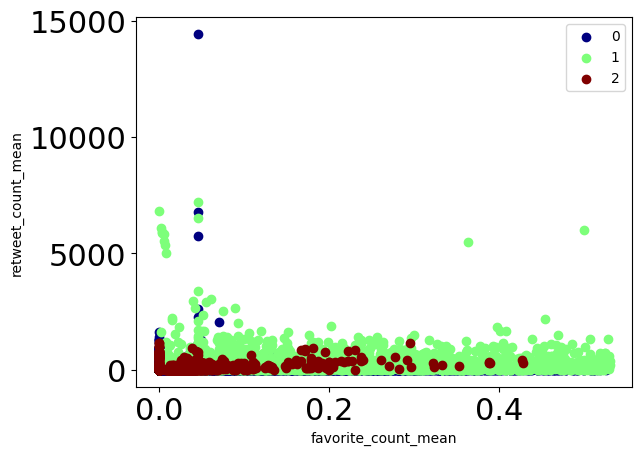

favorite_count_mean - retweet_count_std


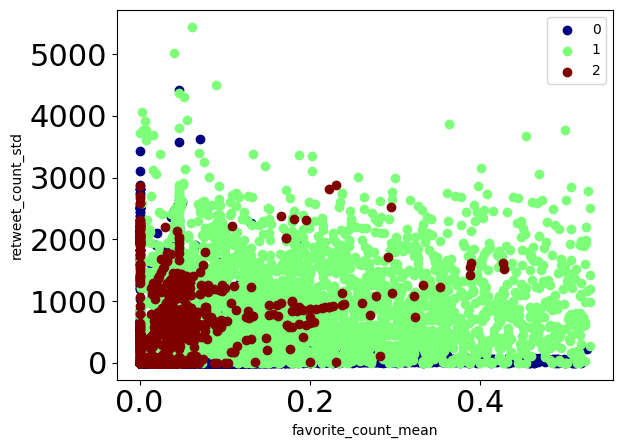

favorite_count_mean - retweet_count_entropy


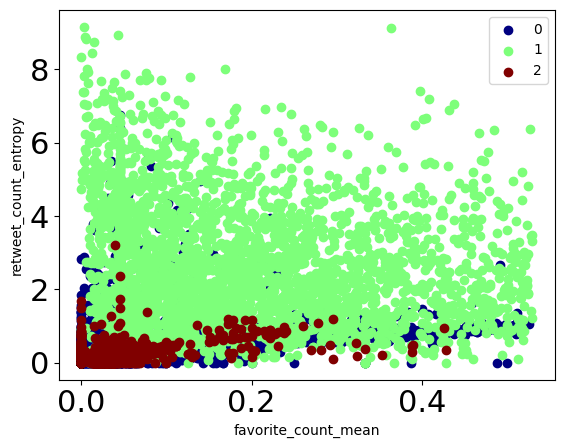

favorite_count_std - favorite_count_entropy


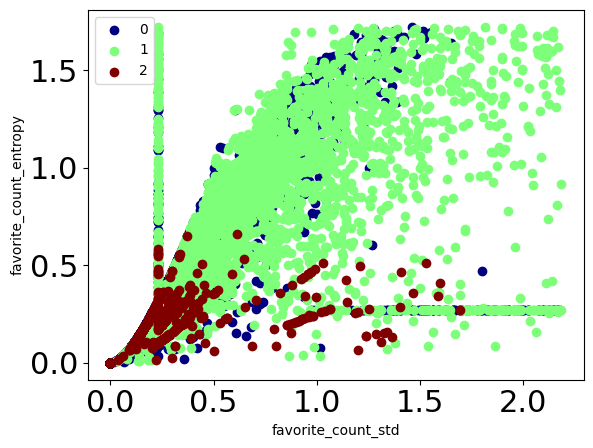

favorite_count_std - retweet_count_mean


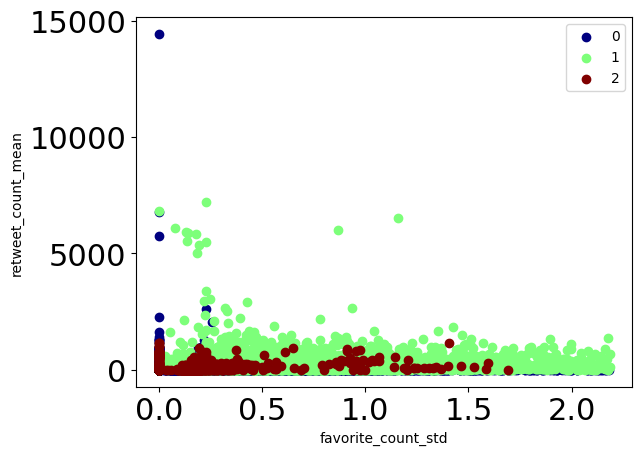

favorite_count_std - retweet_count_std


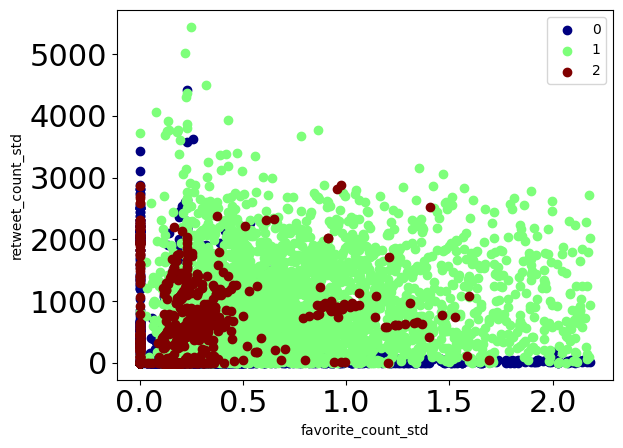

favorite_count_std - retweet_count_entropy


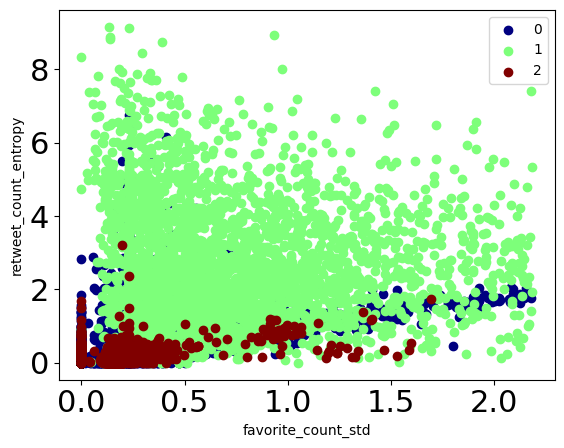

favorite_count_entropy - retweet_count_mean


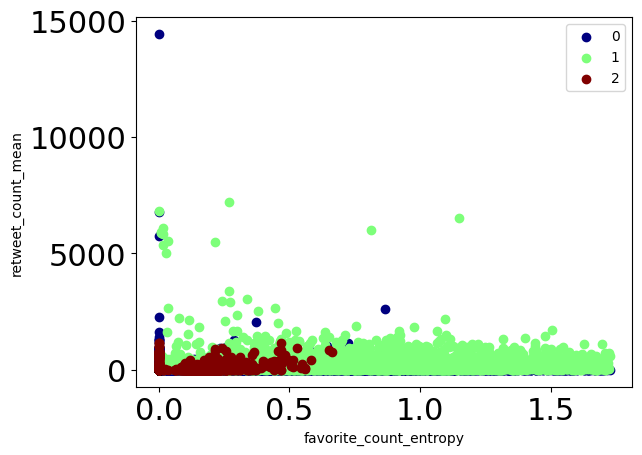

favorite_count_entropy - retweet_count_std


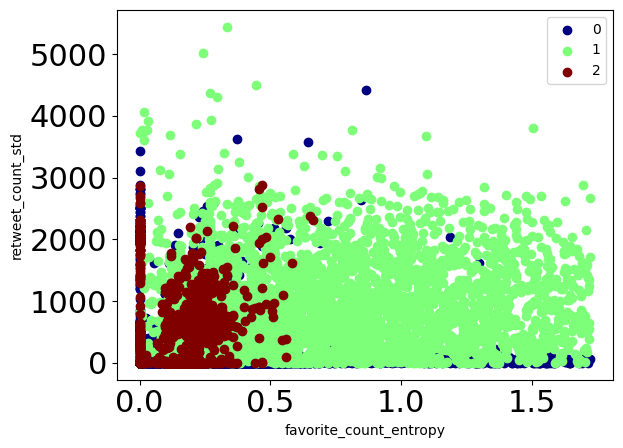

favorite_count_entropy - retweet_count_entropy


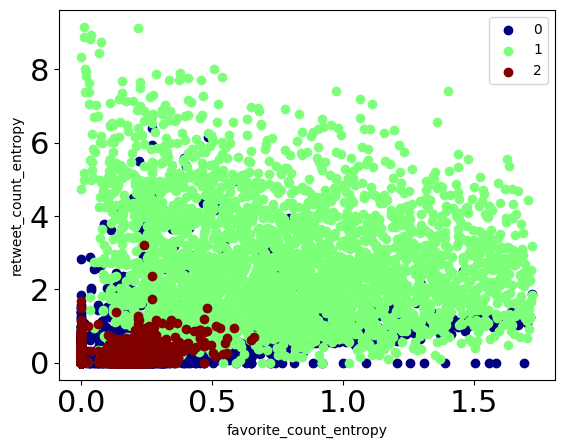

retweet_count_mean - retweet_count_std


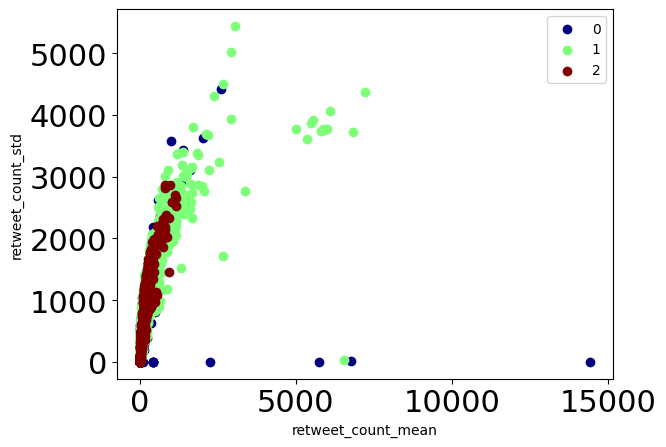

retweet_count_mean - retweet_count_entropy


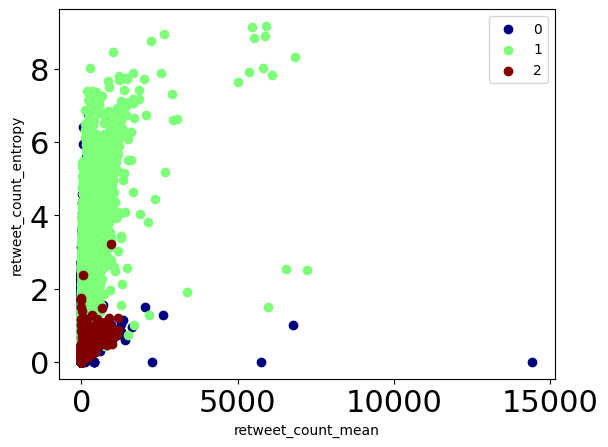

retweet_count_std - retweet_count_entropy


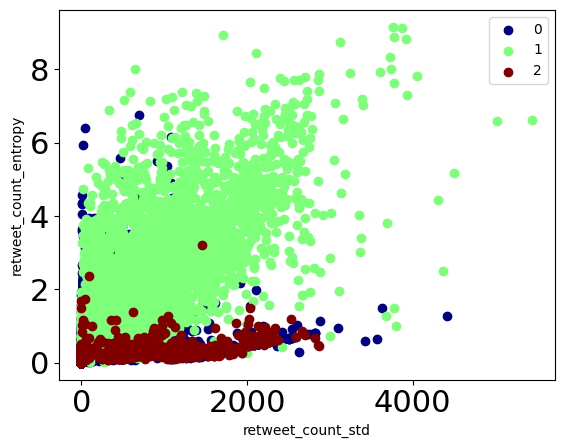

In [38]:
scatter_features_clusters(df_num, res_cluster.labels_)

log_statuses_count - avg_length


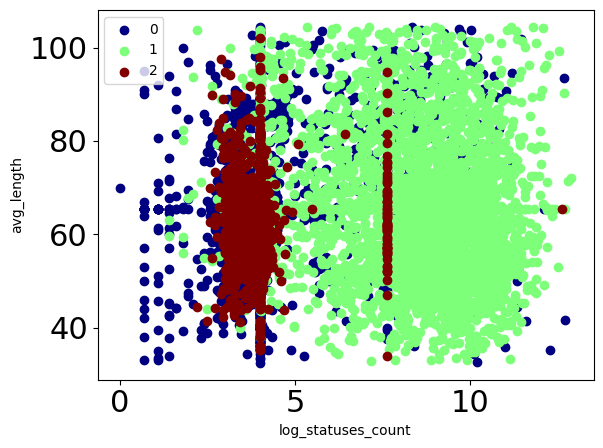

log_statuses_count - log_avg_special_chars


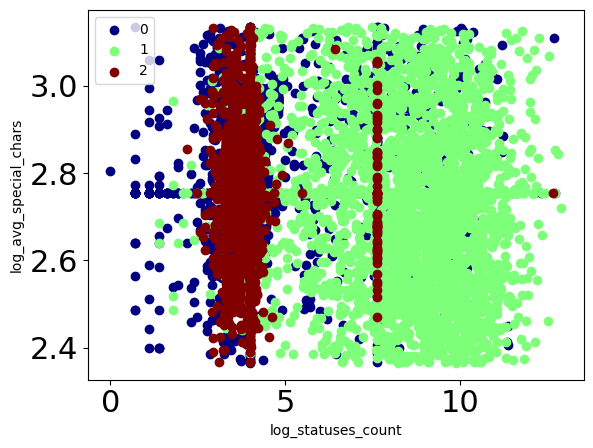

log_statuses_count - log_urls_ratio


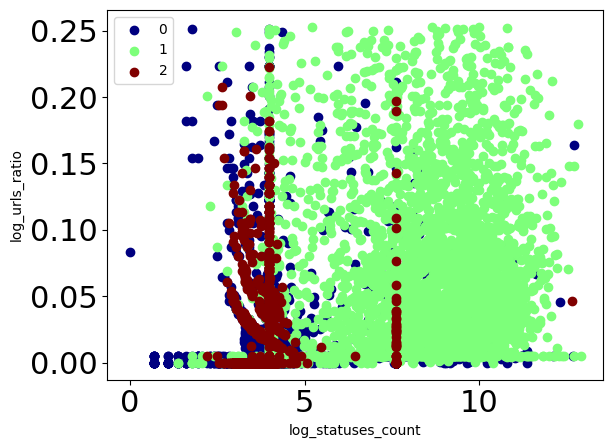

log_statuses_count - log_mentions_ratio


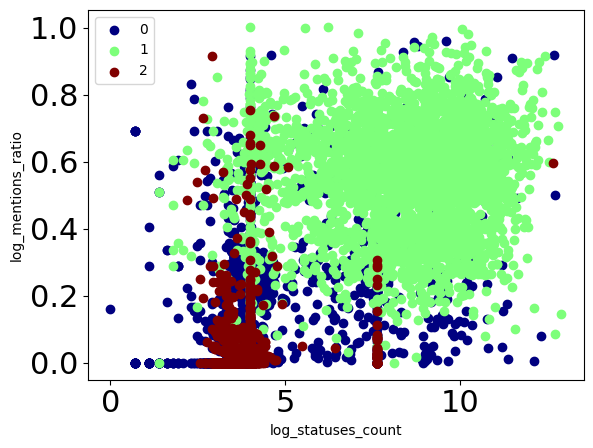

log_statuses_count - log_hashtags_ratio


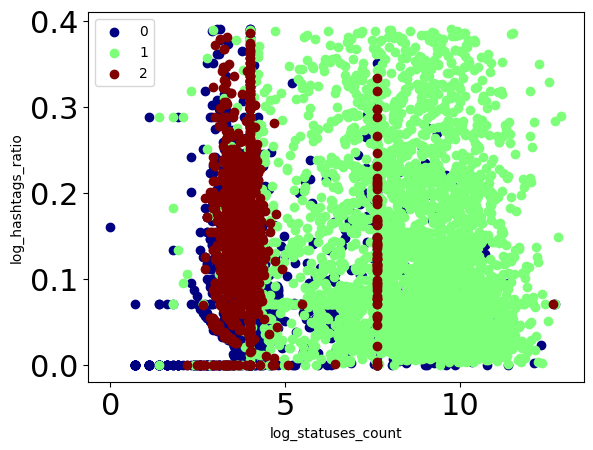

log_statuses_count - log_reply_count_mean


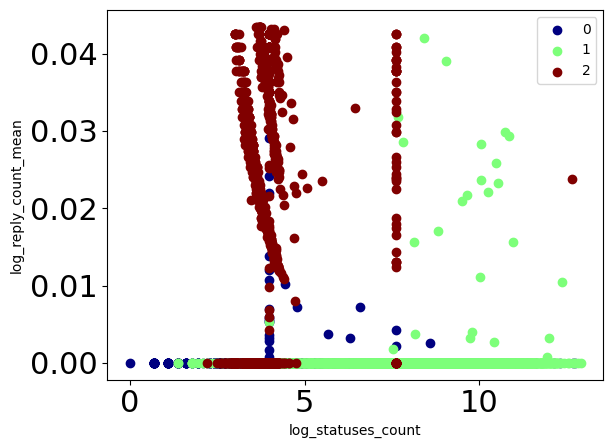

log_statuses_count - log_reply_count_std


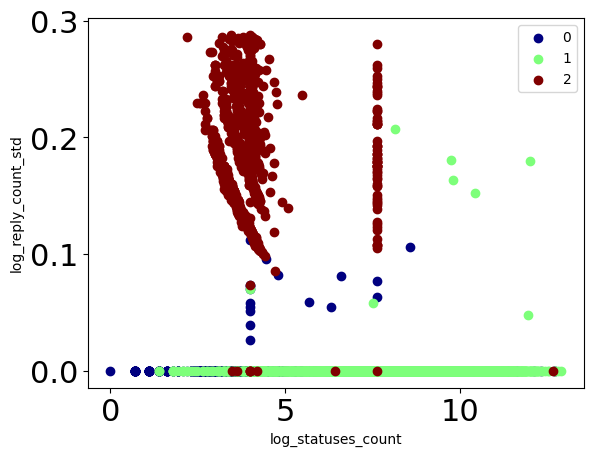

log_statuses_count - log_favorite_count_mean


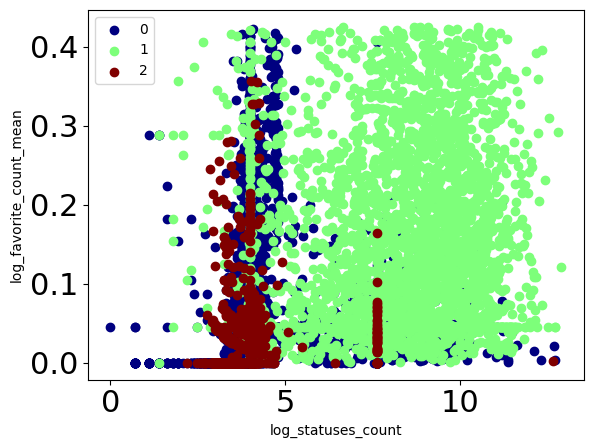

log_statuses_count - log_favorite_count_std


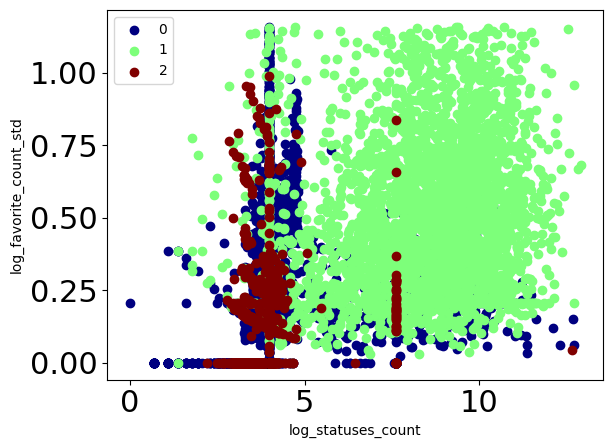

log_statuses_count - log_favorite_count_entropy


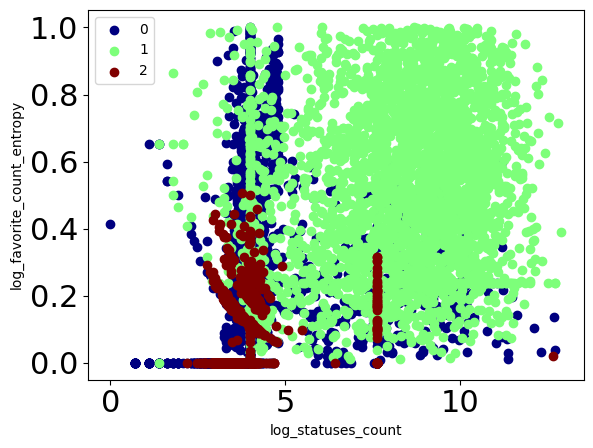

log_statuses_count - log_retweet_count_mean


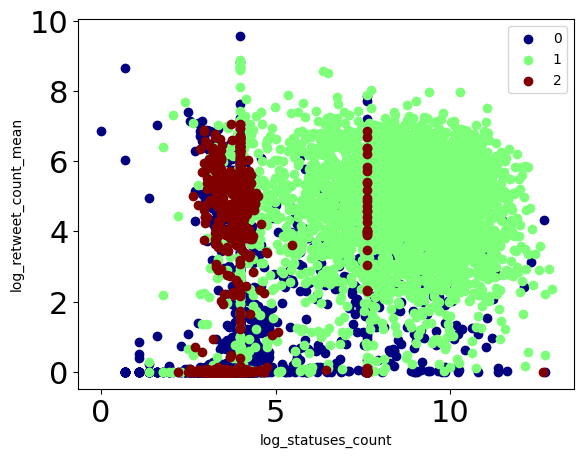

log_statuses_count - log_retweet_count_std


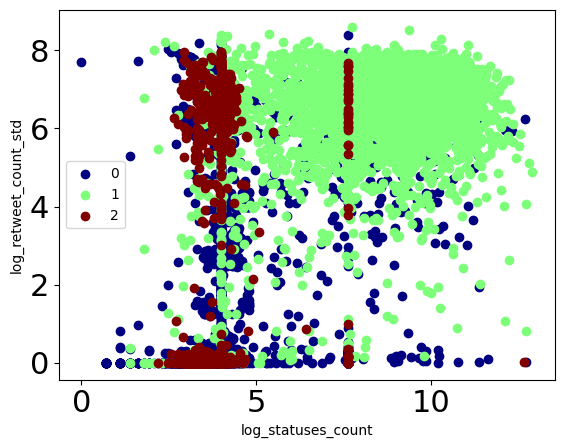

log_statuses_count - log_retweet_count_entropy


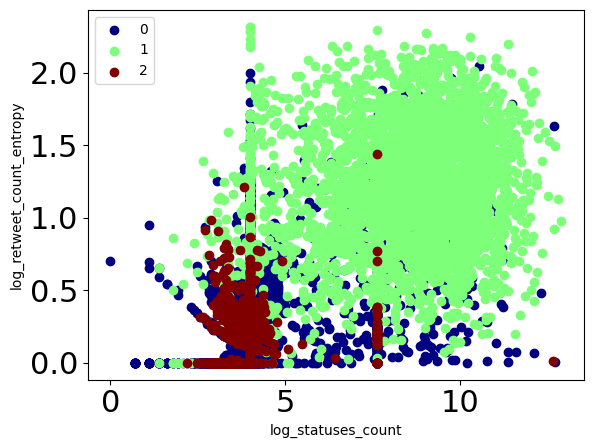

avg_length - log_avg_special_chars


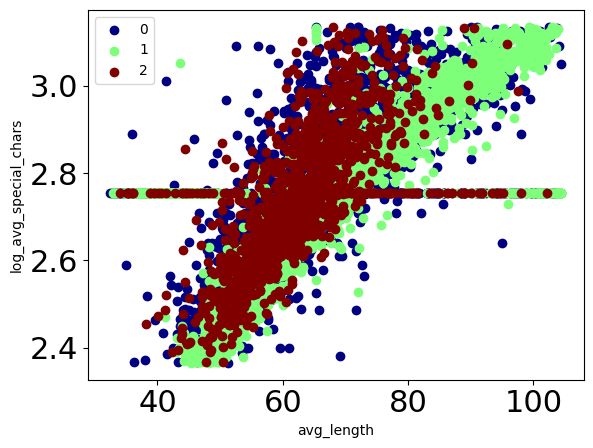

avg_length - log_urls_ratio


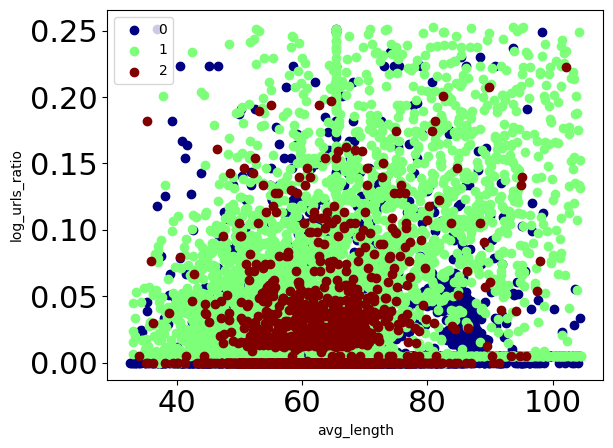

avg_length - log_mentions_ratio


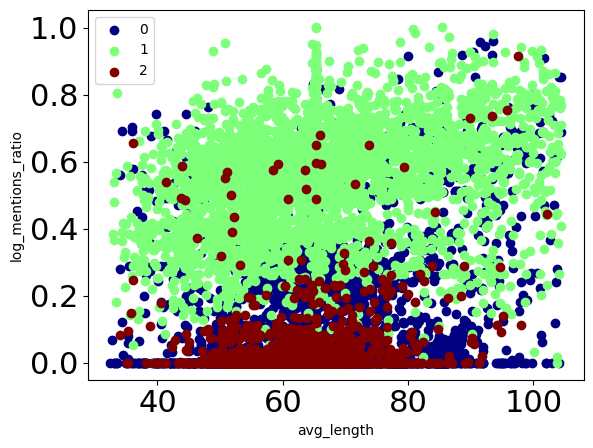

avg_length - log_hashtags_ratio


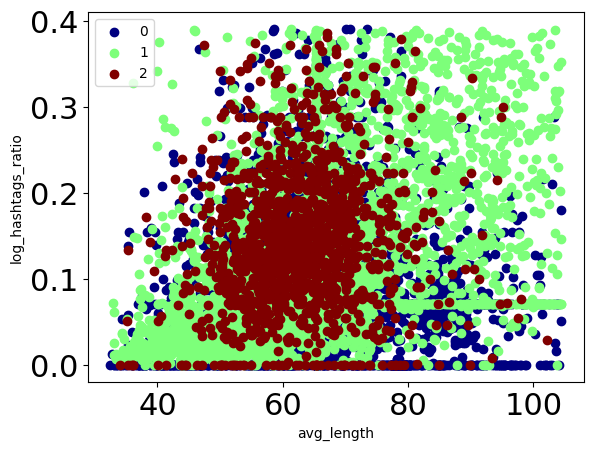

avg_length - log_reply_count_mean


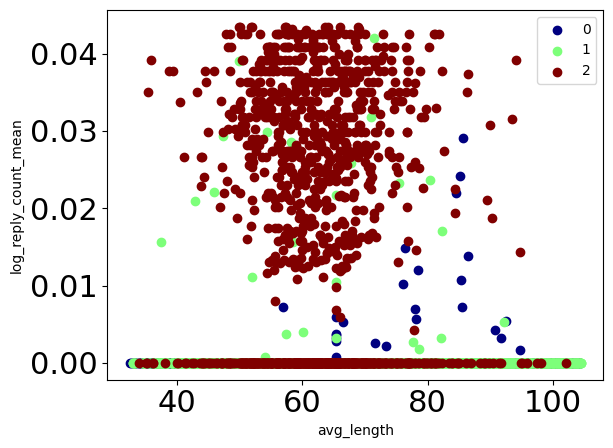

avg_length - log_reply_count_std


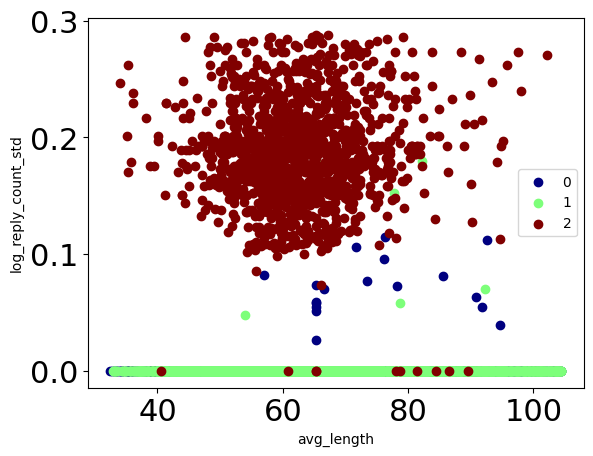

avg_length - log_favorite_count_mean


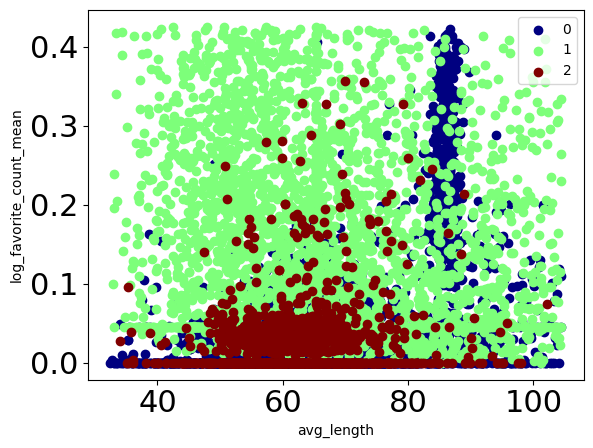

avg_length - log_favorite_count_std


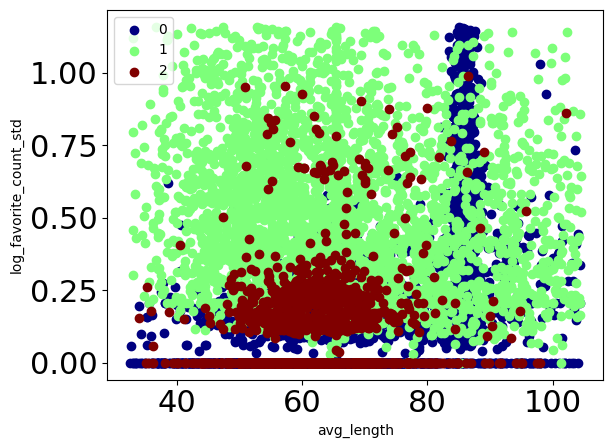

avg_length - log_favorite_count_entropy


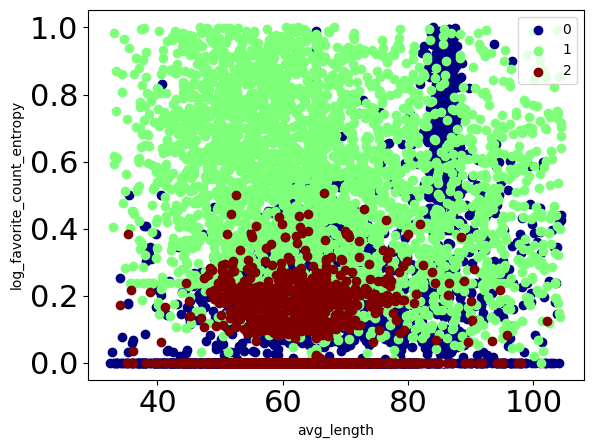

avg_length - log_retweet_count_mean


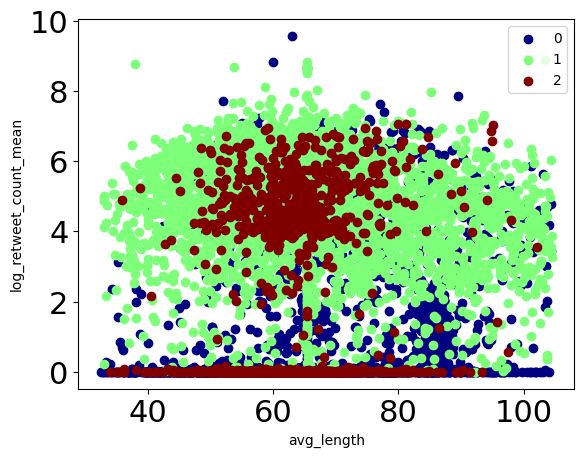

avg_length - log_retweet_count_std


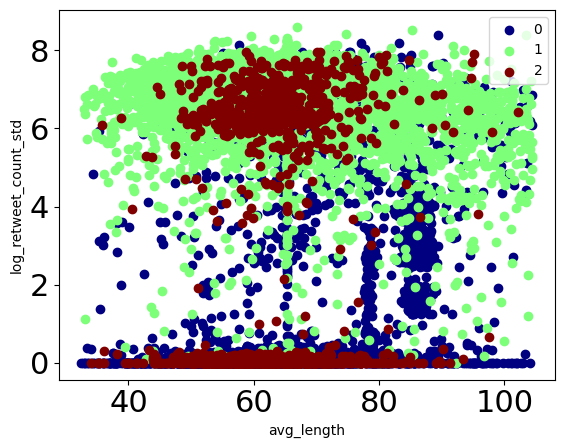

avg_length - log_retweet_count_entropy


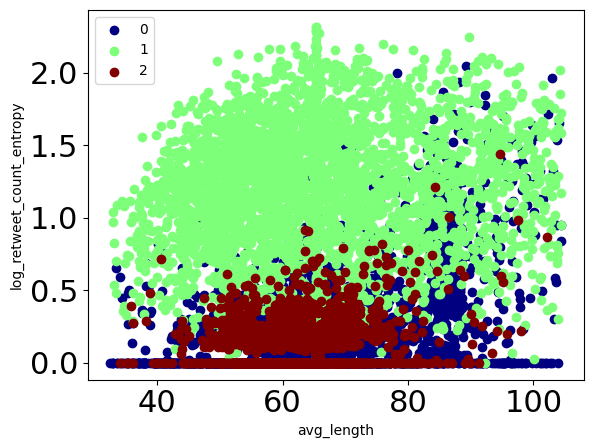

log_avg_special_chars - log_urls_ratio


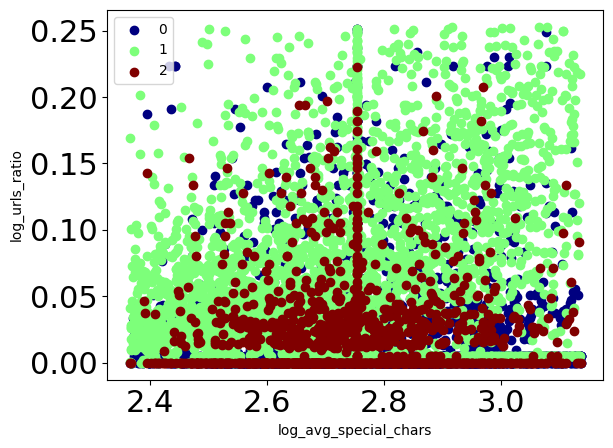

log_avg_special_chars - log_mentions_ratio


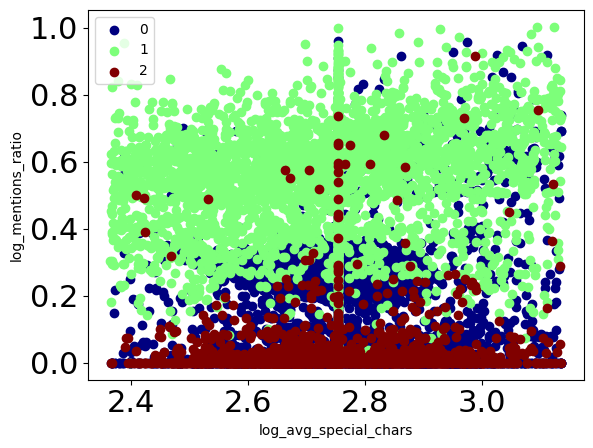

log_avg_special_chars - log_hashtags_ratio


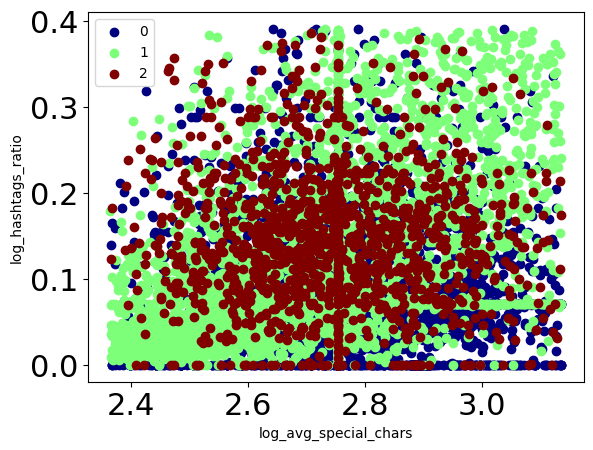

log_avg_special_chars - log_reply_count_mean


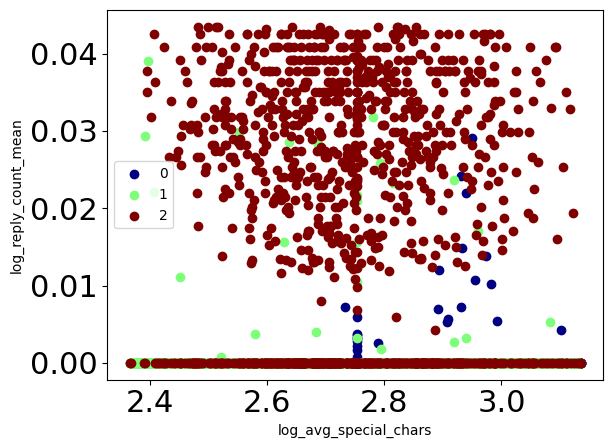

log_avg_special_chars - log_reply_count_std


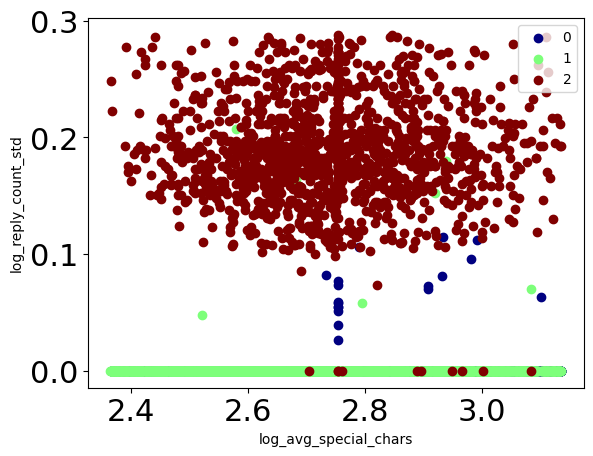

log_avg_special_chars - log_favorite_count_mean


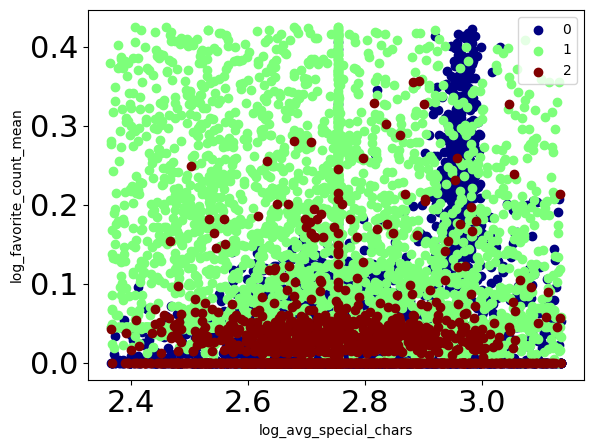

log_avg_special_chars - log_favorite_count_std


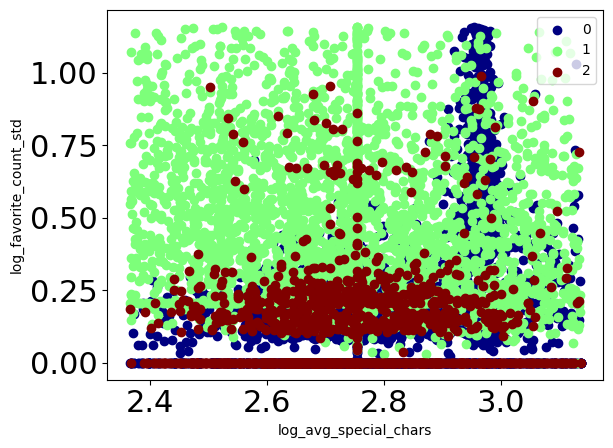

log_avg_special_chars - log_favorite_count_entropy


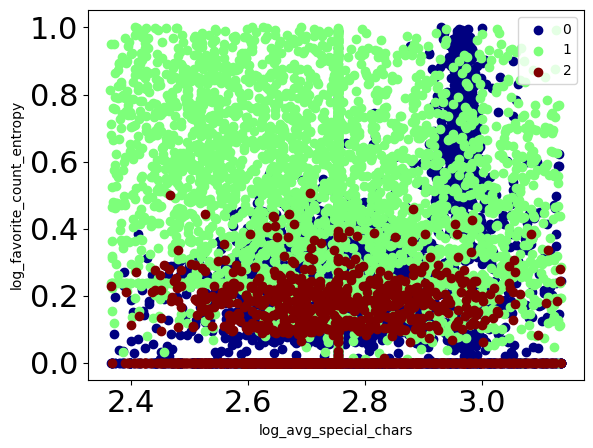

log_avg_special_chars - log_retweet_count_mean


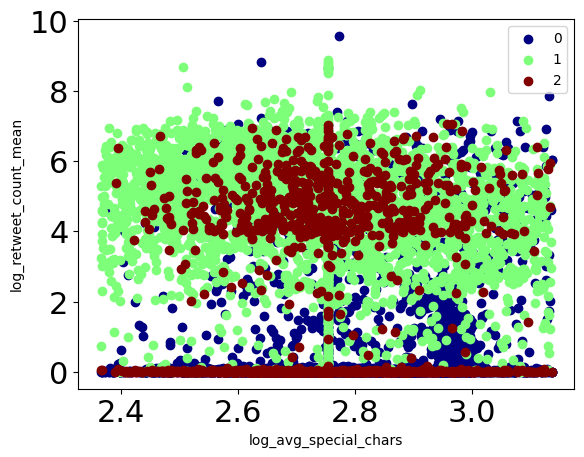

log_avg_special_chars - log_retweet_count_std


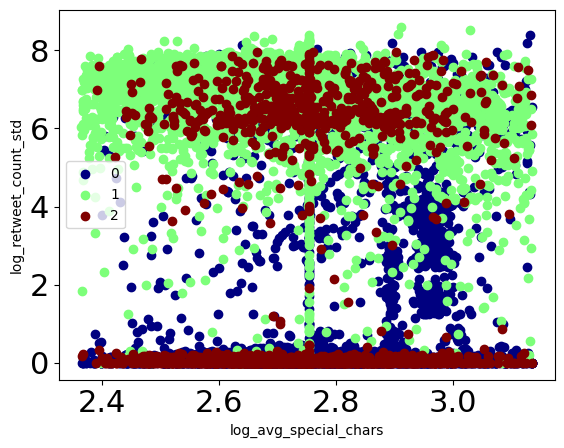

log_avg_special_chars - log_retweet_count_entropy


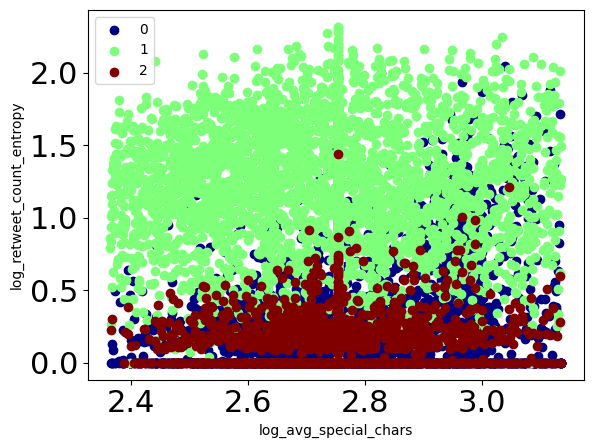

log_urls_ratio - log_mentions_ratio


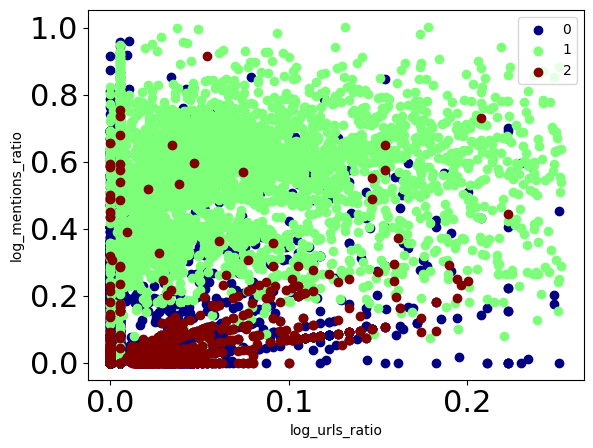

log_urls_ratio - log_hashtags_ratio


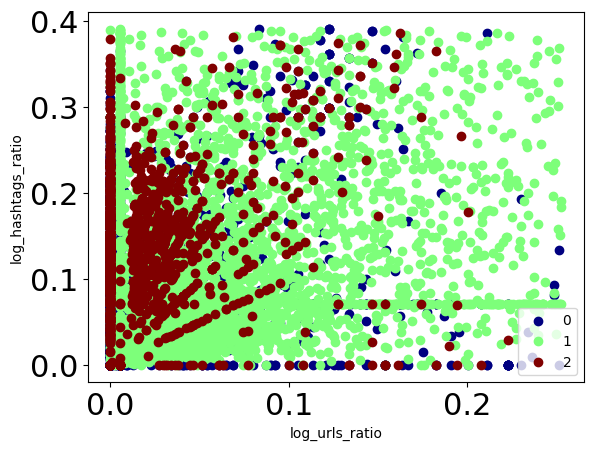

log_urls_ratio - log_reply_count_mean


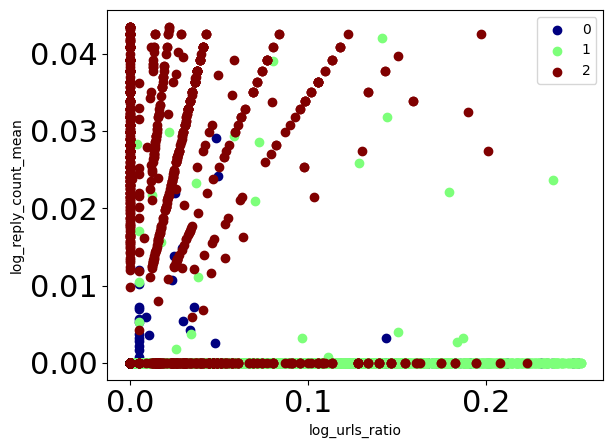

log_urls_ratio - log_reply_count_std


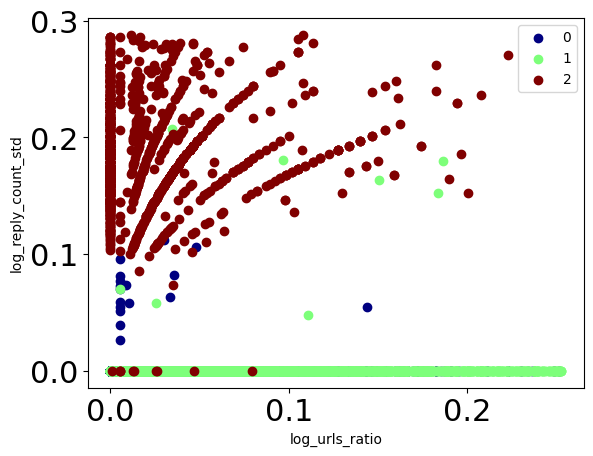

log_urls_ratio - log_favorite_count_mean


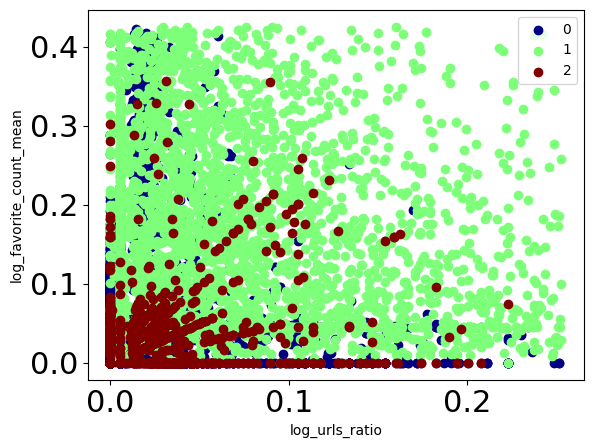

log_urls_ratio - log_favorite_count_std


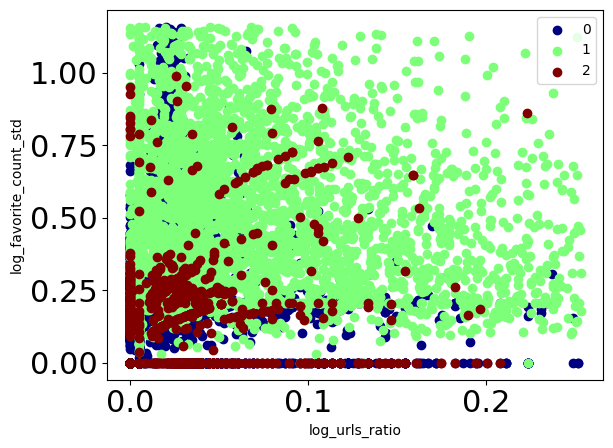

log_urls_ratio - log_favorite_count_entropy


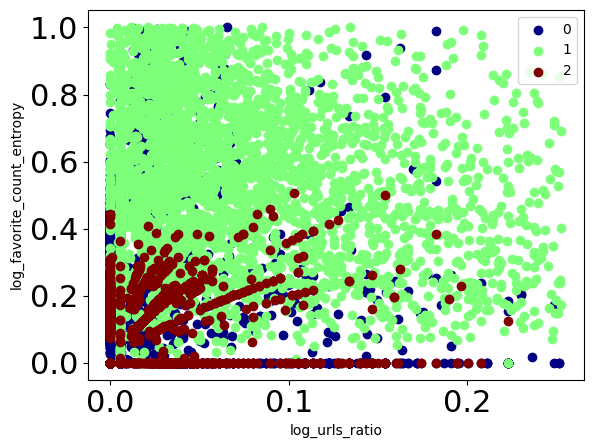

log_urls_ratio - log_retweet_count_mean


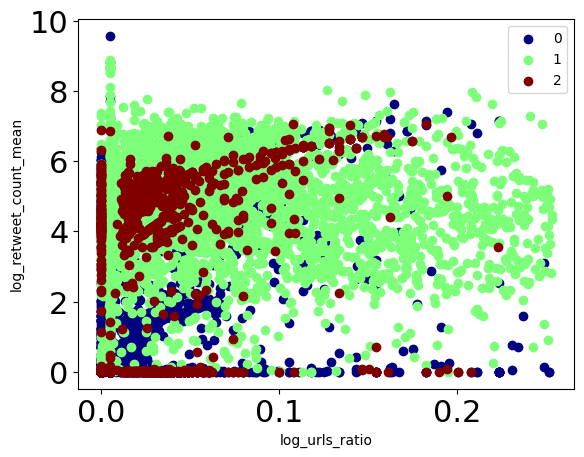

log_urls_ratio - log_retweet_count_std


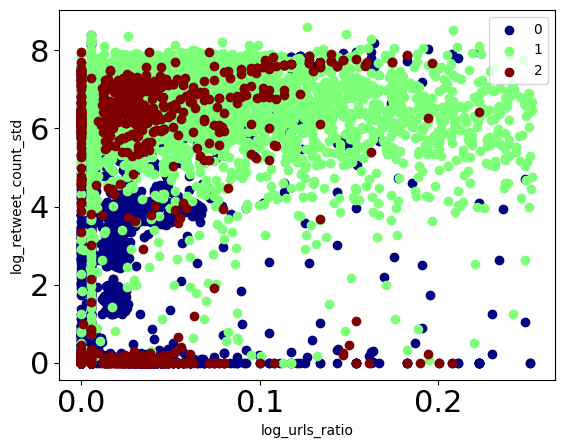

log_urls_ratio - log_retweet_count_entropy


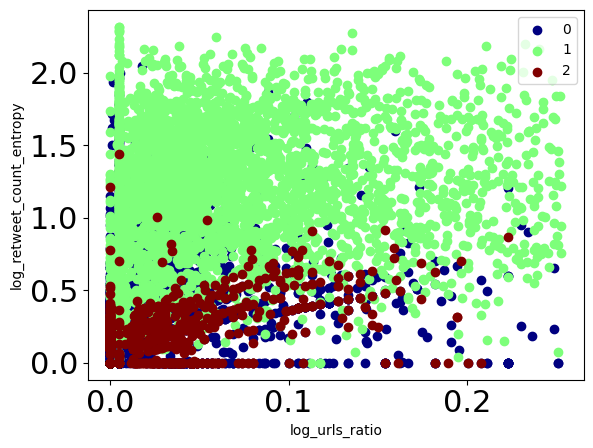

log_mentions_ratio - log_hashtags_ratio


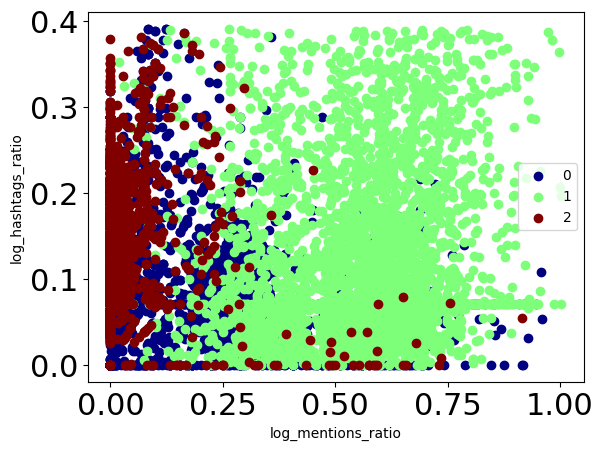

log_mentions_ratio - log_reply_count_mean


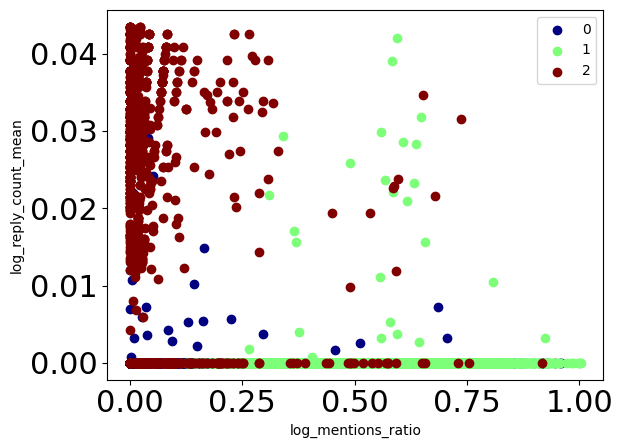

log_mentions_ratio - log_reply_count_std


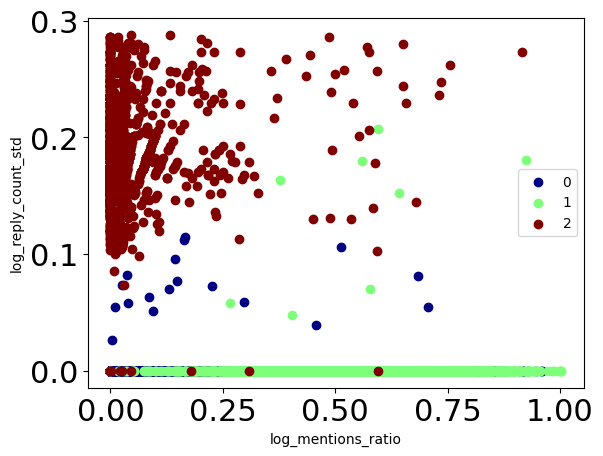

log_mentions_ratio - log_favorite_count_mean


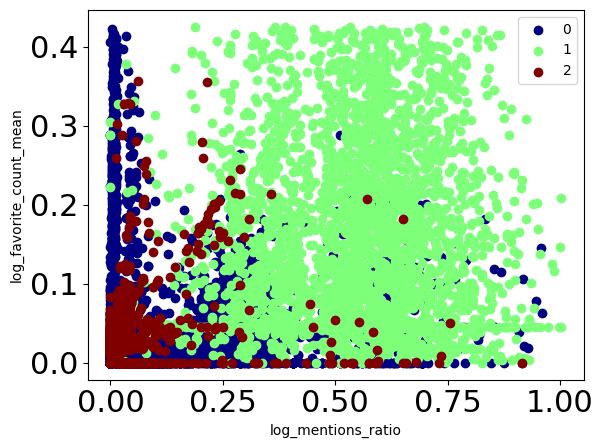

log_mentions_ratio - log_favorite_count_std


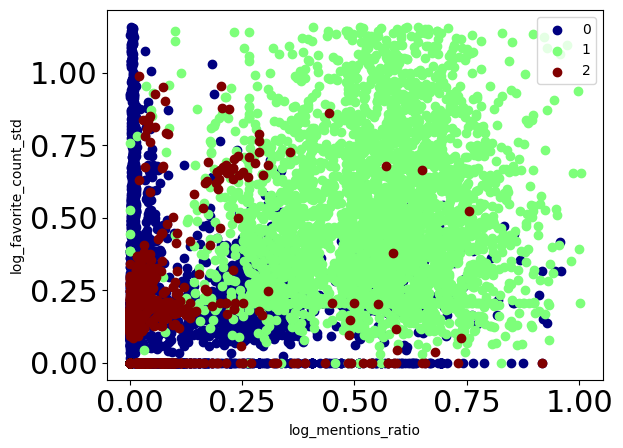

log_mentions_ratio - log_favorite_count_entropy


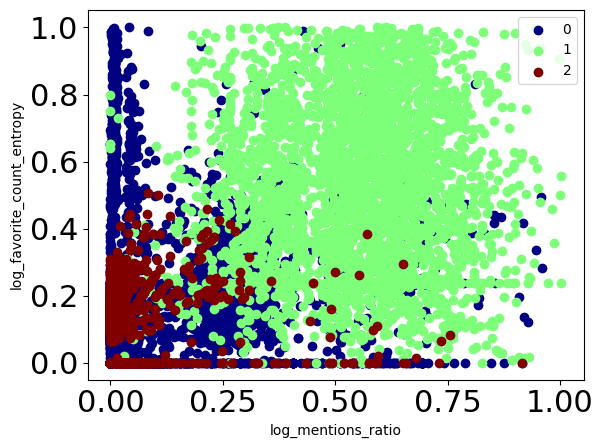

log_mentions_ratio - log_retweet_count_mean


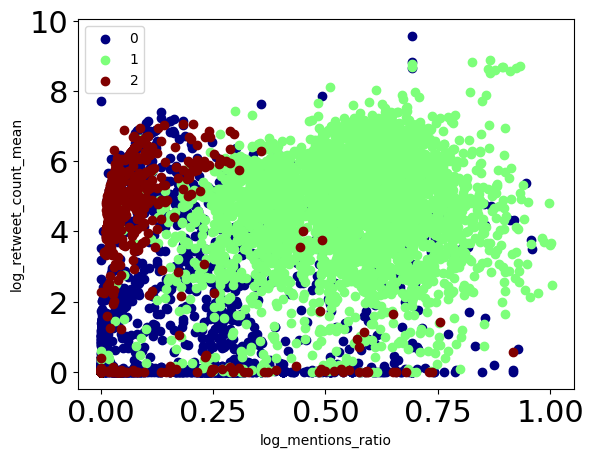

log_mentions_ratio - log_retweet_count_std


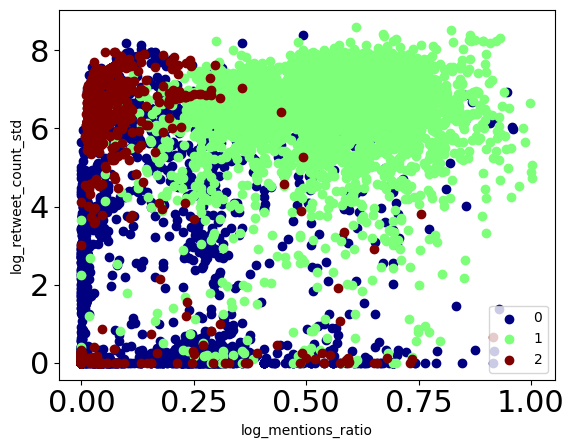

log_mentions_ratio - log_retweet_count_entropy


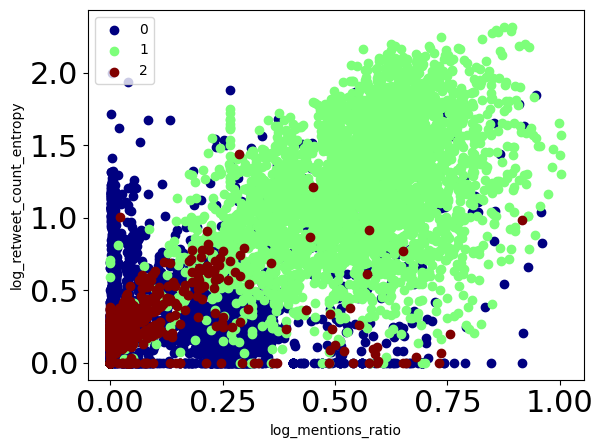

log_hashtags_ratio - log_reply_count_mean


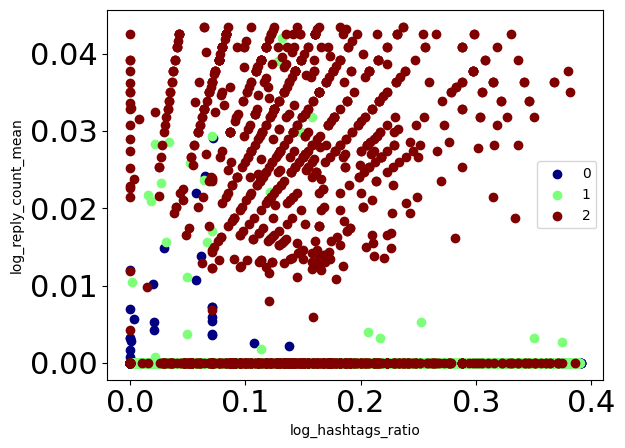

log_hashtags_ratio - log_reply_count_std


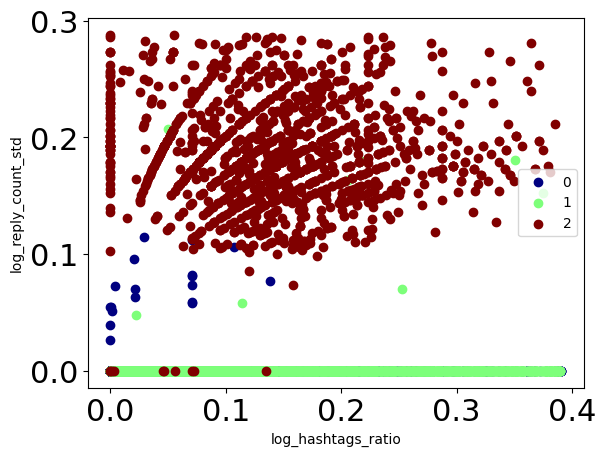

log_hashtags_ratio - log_favorite_count_mean


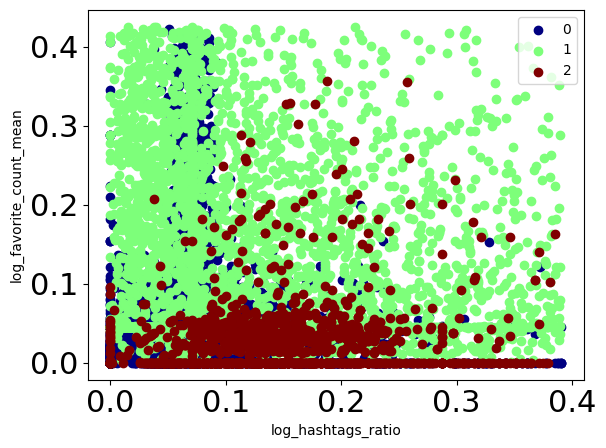

log_hashtags_ratio - log_favorite_count_std


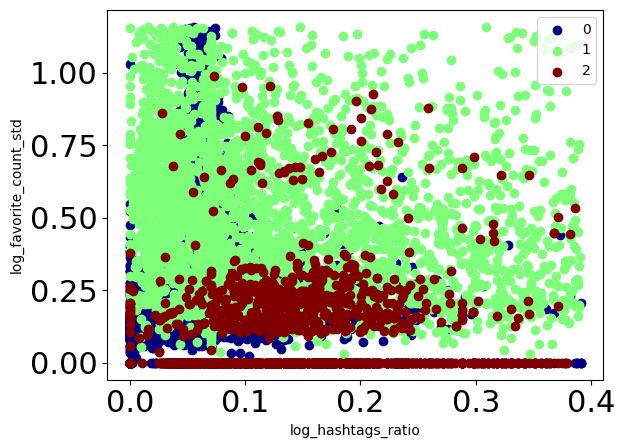

log_hashtags_ratio - log_favorite_count_entropy


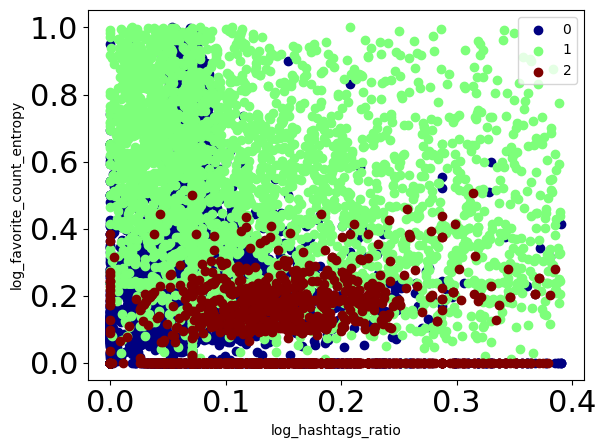

log_hashtags_ratio - log_retweet_count_mean


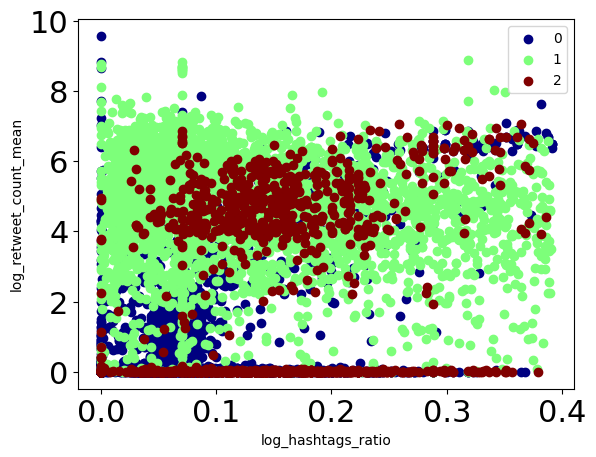

log_hashtags_ratio - log_retweet_count_std


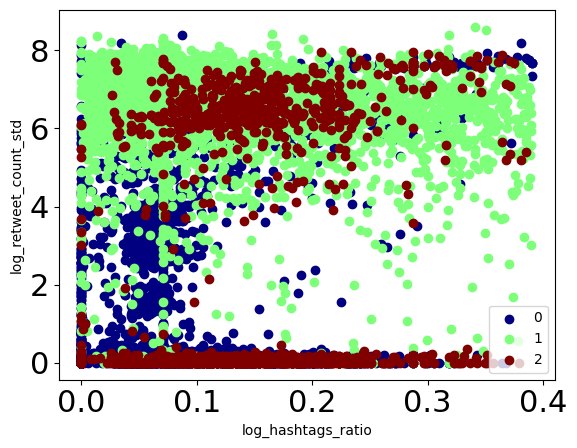

log_hashtags_ratio - log_retweet_count_entropy


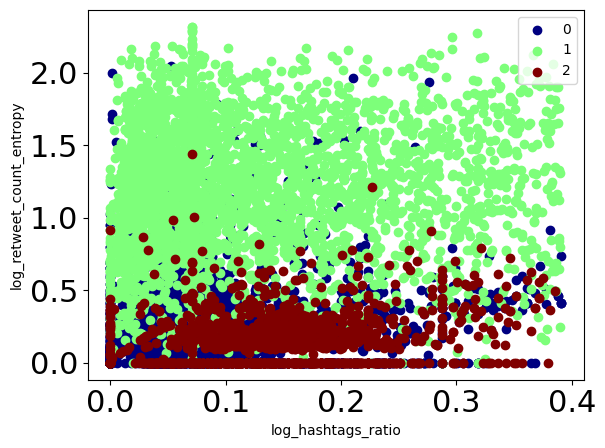

log_reply_count_mean - log_reply_count_std


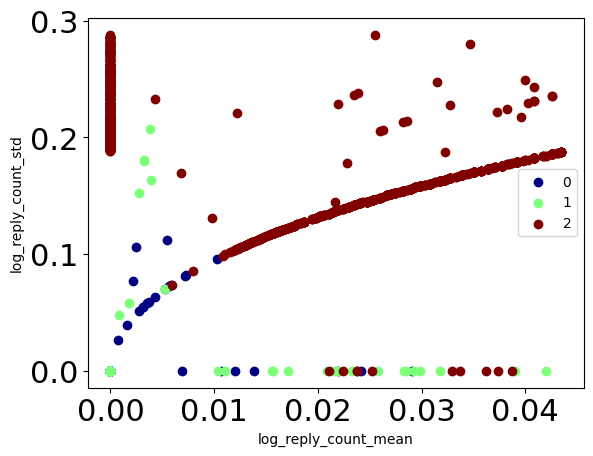

log_reply_count_mean - log_favorite_count_mean


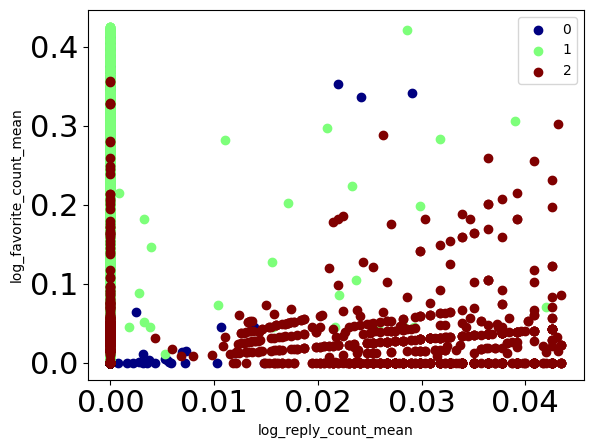

log_reply_count_mean - log_favorite_count_std


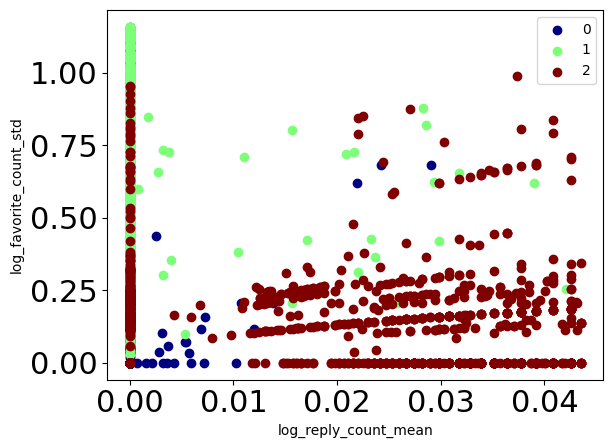

log_reply_count_mean - log_favorite_count_entropy


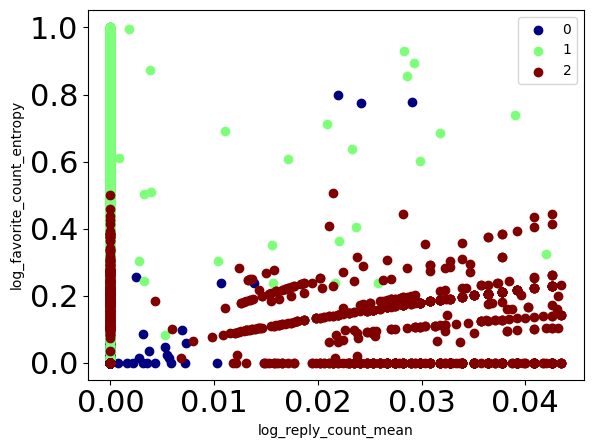

log_reply_count_mean - log_retweet_count_mean


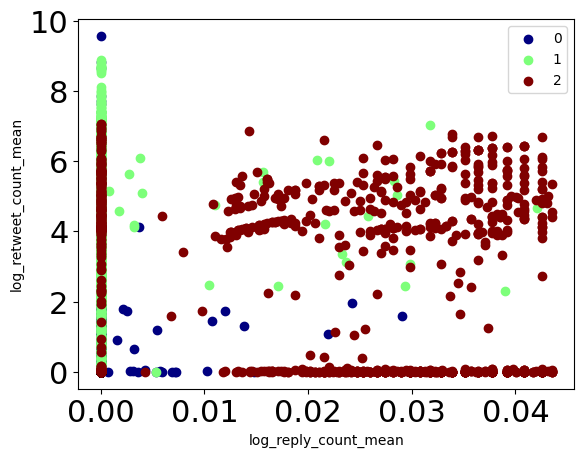

log_reply_count_mean - log_retweet_count_std


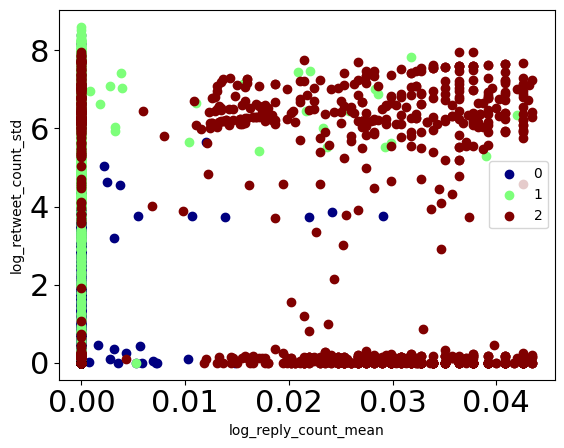

log_reply_count_mean - log_retweet_count_entropy


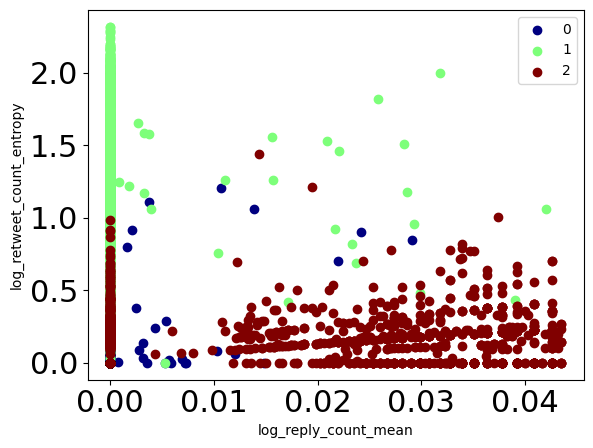

log_reply_count_std - log_favorite_count_mean


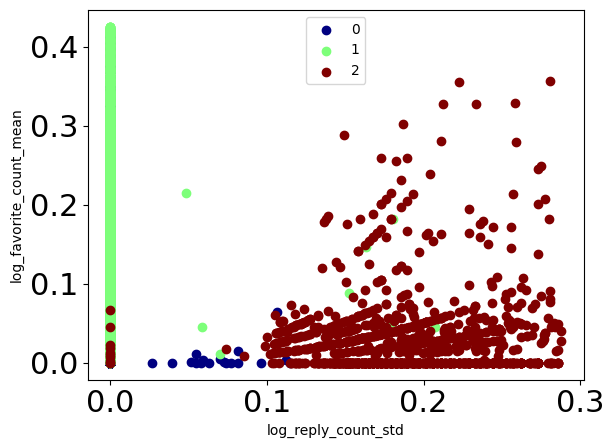

log_reply_count_std - log_favorite_count_std


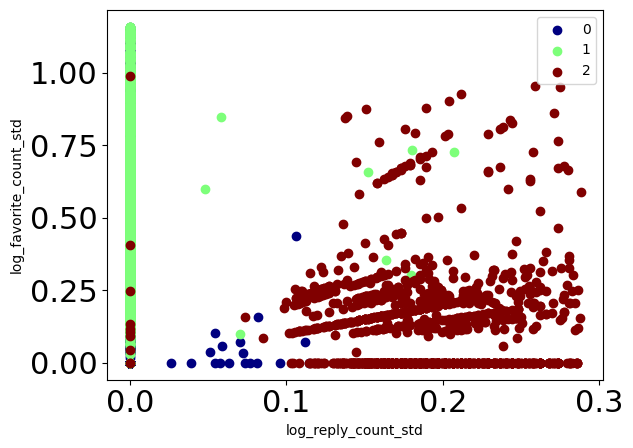

log_reply_count_std - log_favorite_count_entropy


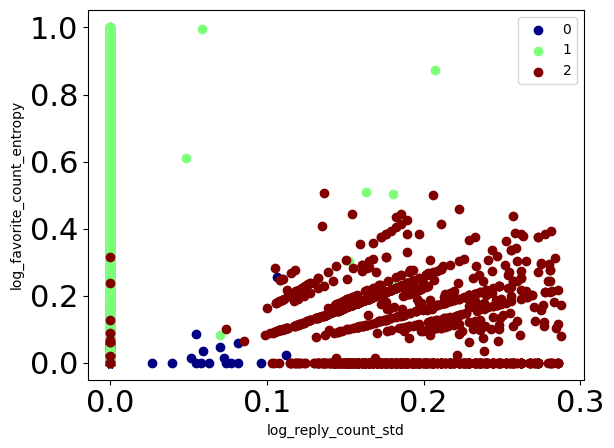

log_reply_count_std - log_retweet_count_mean


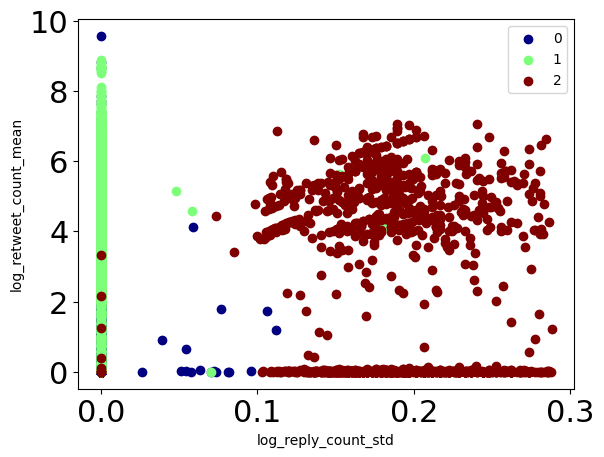

log_reply_count_std - log_retweet_count_std


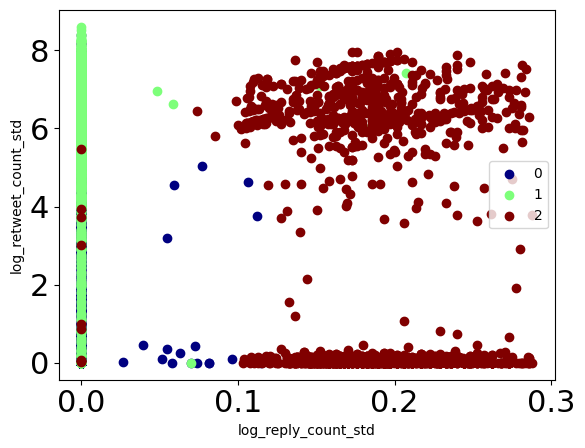

log_reply_count_std - log_retweet_count_entropy


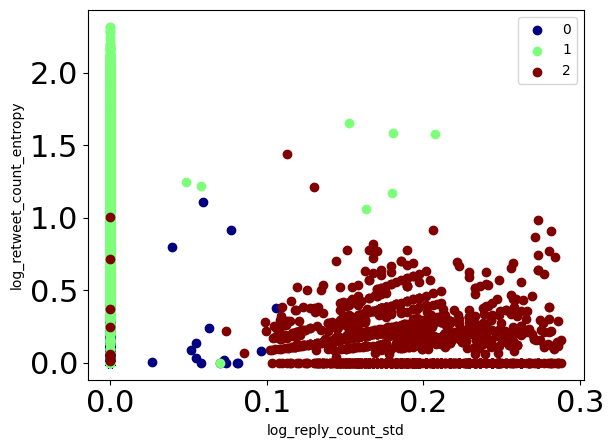

log_favorite_count_mean - log_favorite_count_std


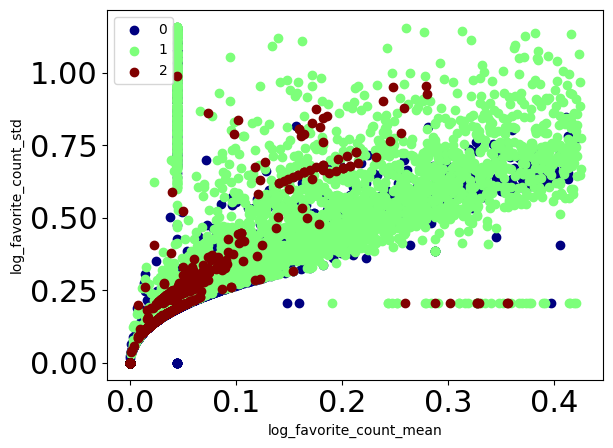

log_favorite_count_mean - log_favorite_count_entropy


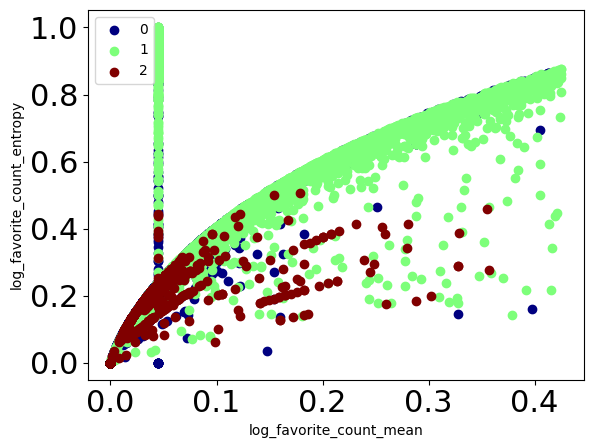

log_favorite_count_mean - log_retweet_count_mean


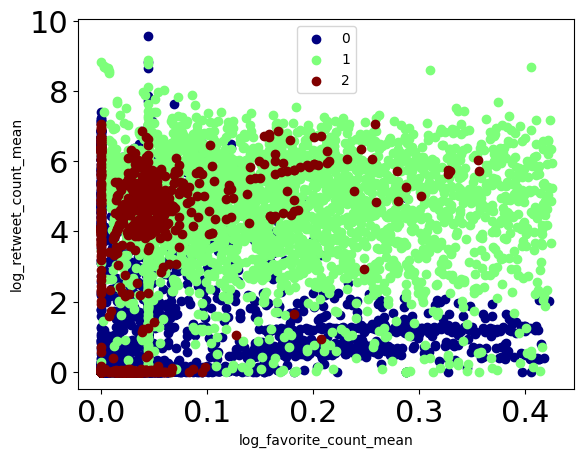

log_favorite_count_mean - log_retweet_count_std


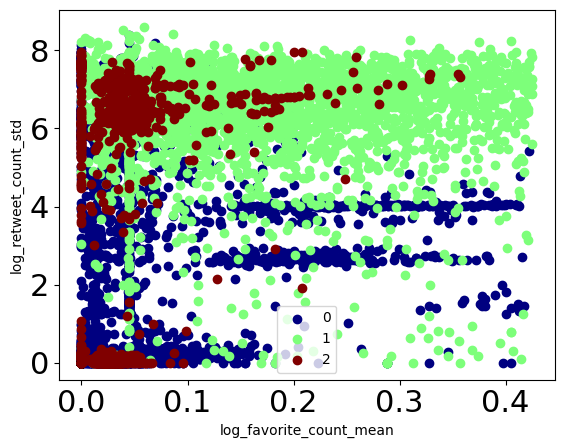

log_favorite_count_mean - log_retweet_count_entropy


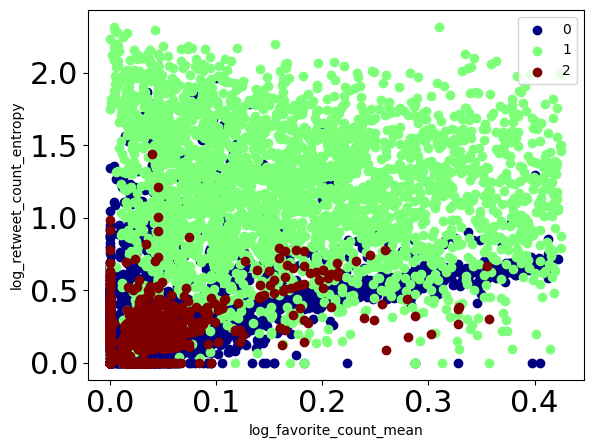

log_favorite_count_std - log_favorite_count_entropy


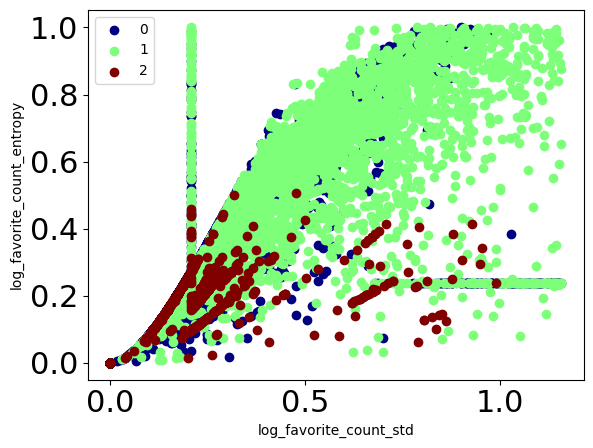

log_favorite_count_std - log_retweet_count_mean


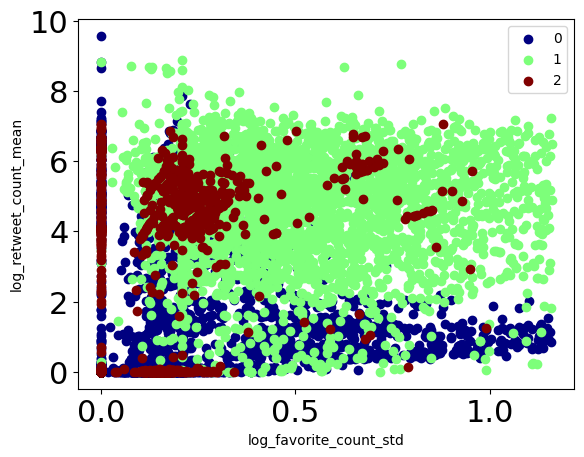

log_favorite_count_std - log_retweet_count_std


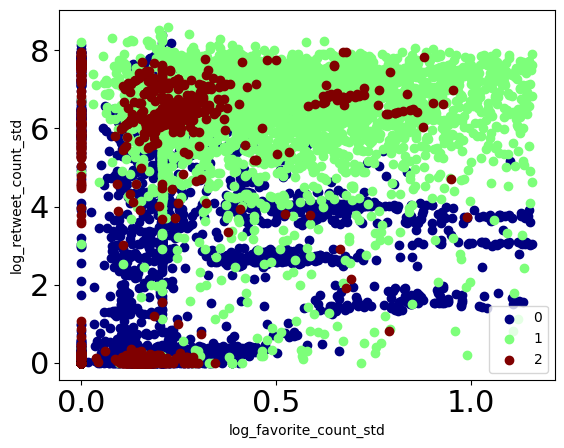

log_favorite_count_std - log_retweet_count_entropy


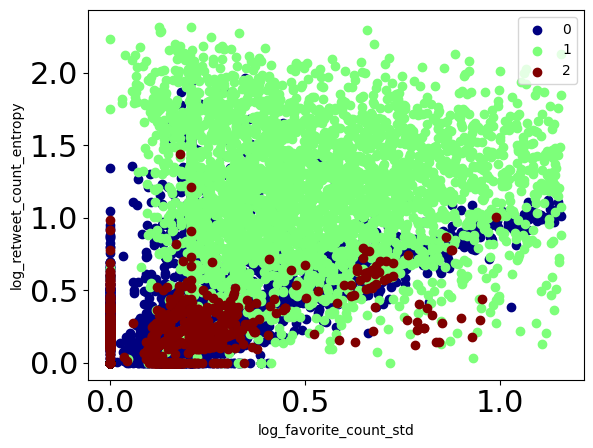

log_favorite_count_entropy - log_retweet_count_mean


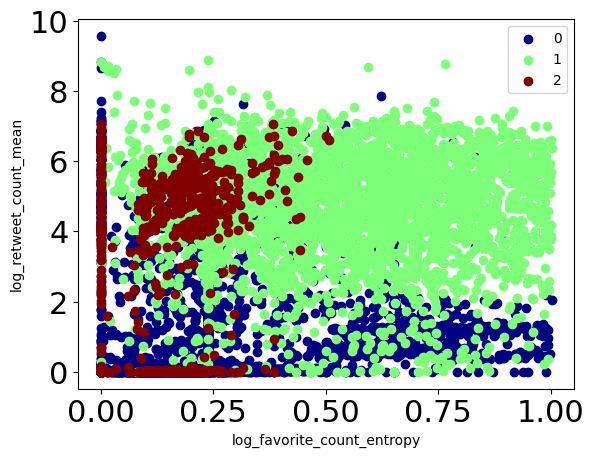

log_favorite_count_entropy - log_retweet_count_std


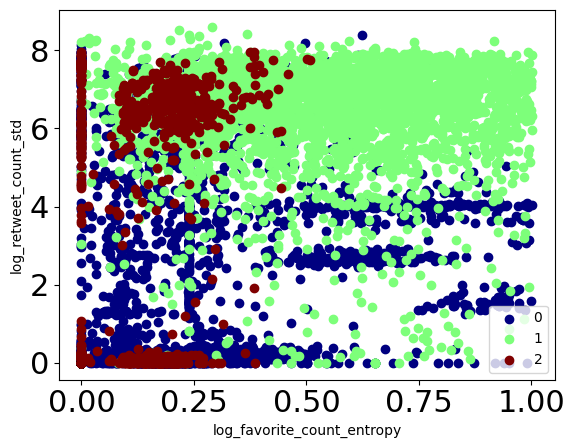

log_favorite_count_entropy - log_retweet_count_entropy


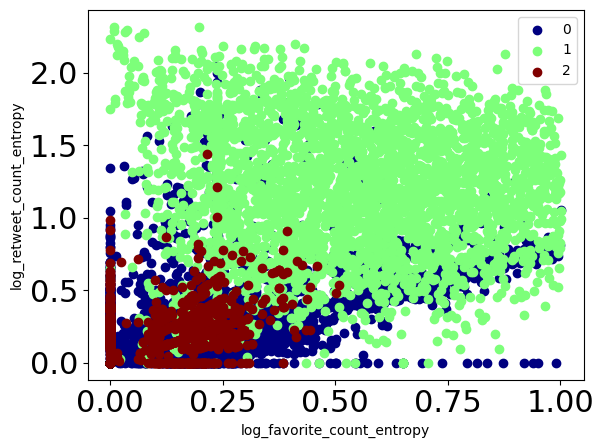

log_retweet_count_mean - log_retweet_count_std


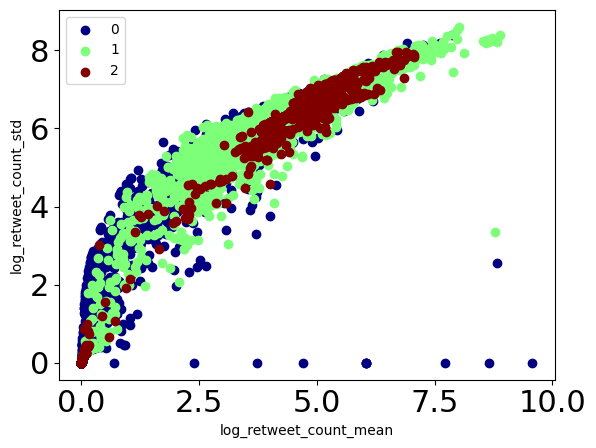

log_retweet_count_mean - log_retweet_count_entropy


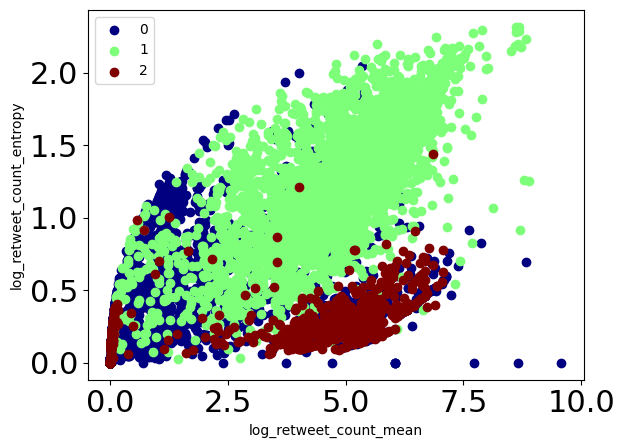

log_retweet_count_std - log_retweet_count_entropy


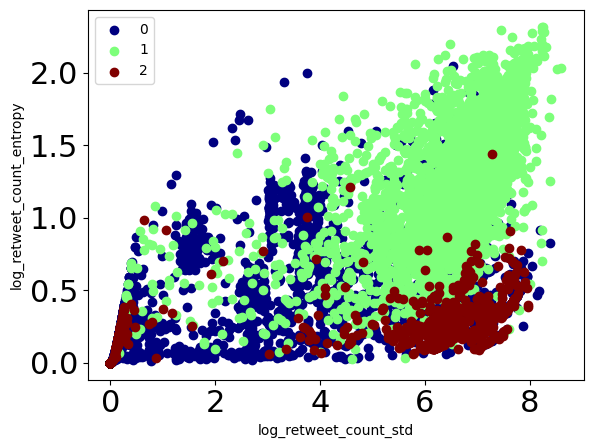

In [39]:
scatter_features_clusters(df_num_not_skewed, res_cluster.labels_)

log_statuses_count - avg_length


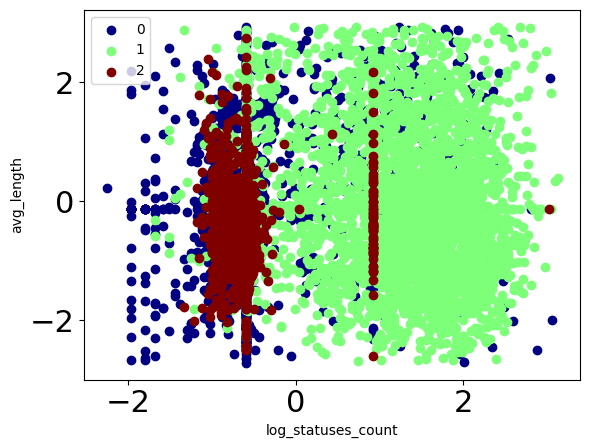

log_statuses_count - log_avg_special_chars


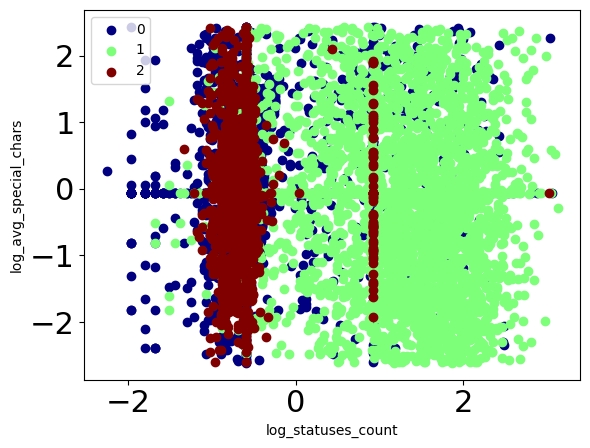

log_statuses_count - log_urls_ratio


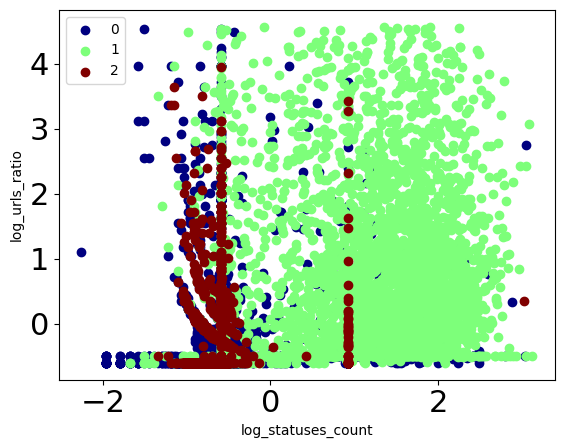

log_statuses_count - log_mentions_ratio


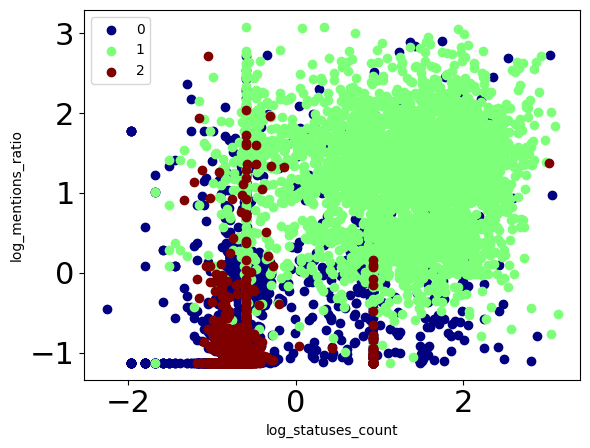

log_statuses_count - log_hashtags_ratio


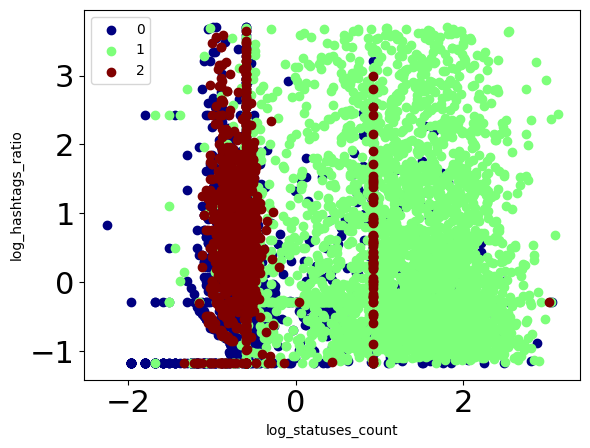

log_statuses_count - log_reply_count_mean


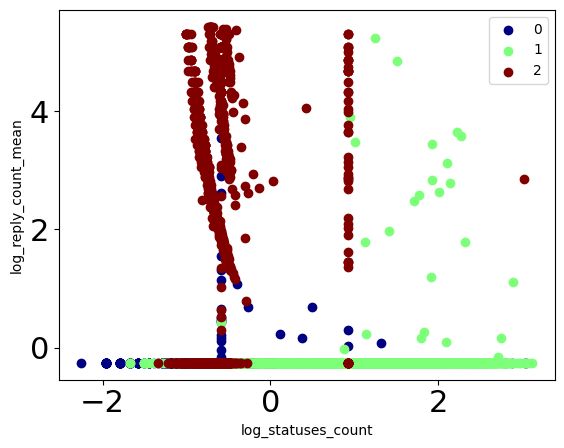

log_statuses_count - log_reply_count_std


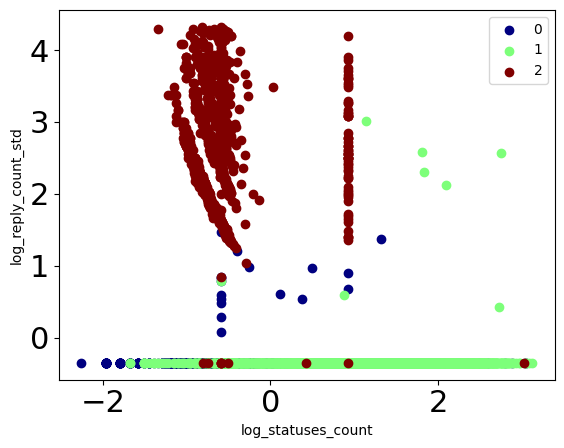

log_statuses_count - log_favorite_count_mean


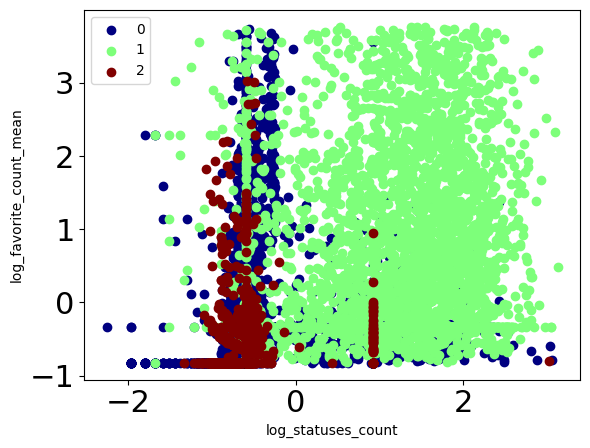

log_statuses_count - log_favorite_count_std


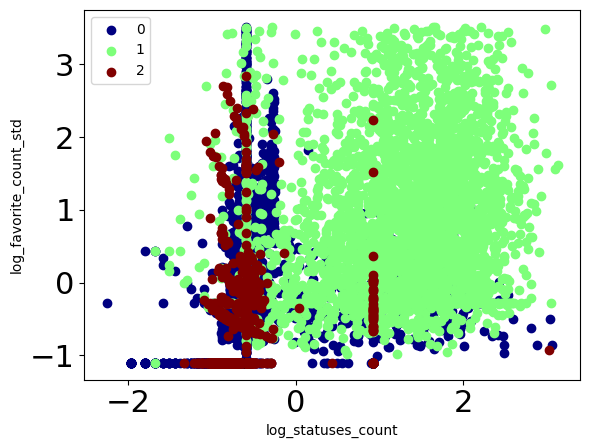

log_statuses_count - log_favorite_count_entropy


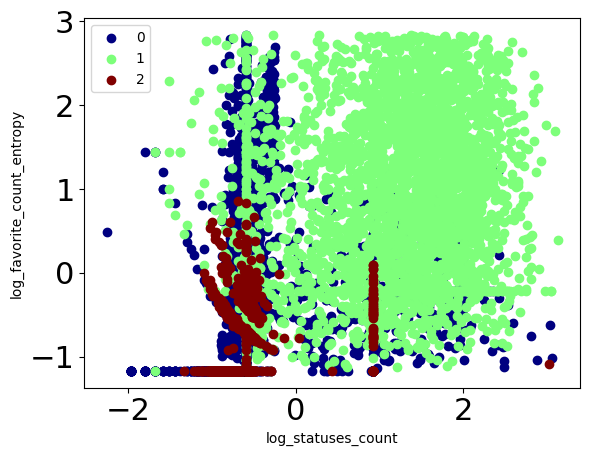

log_statuses_count - log_retweet_count_mean


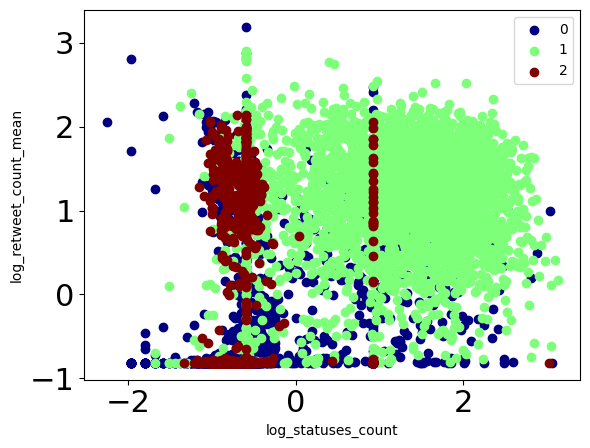

log_statuses_count - log_retweet_count_std


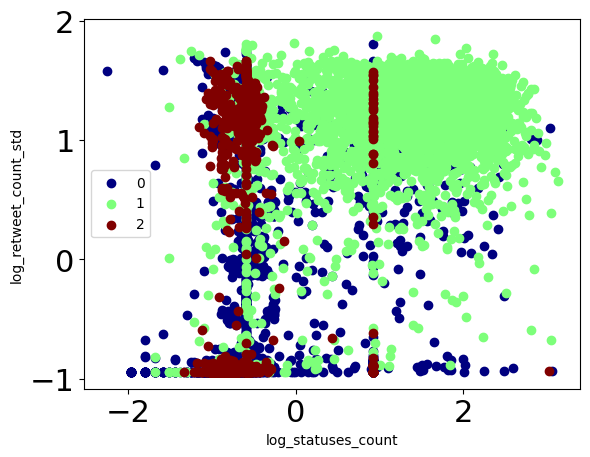

log_statuses_count - log_retweet_count_entropy


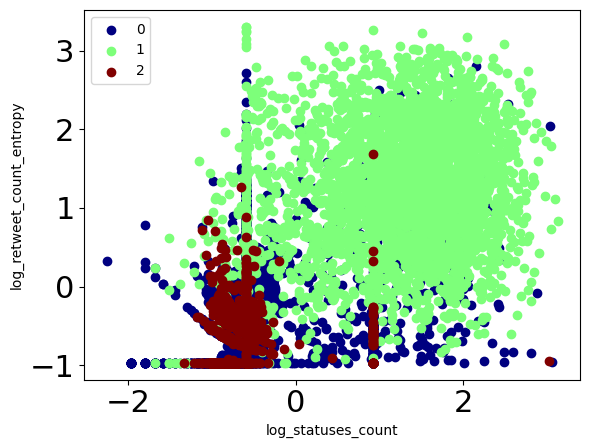

avg_length - log_avg_special_chars


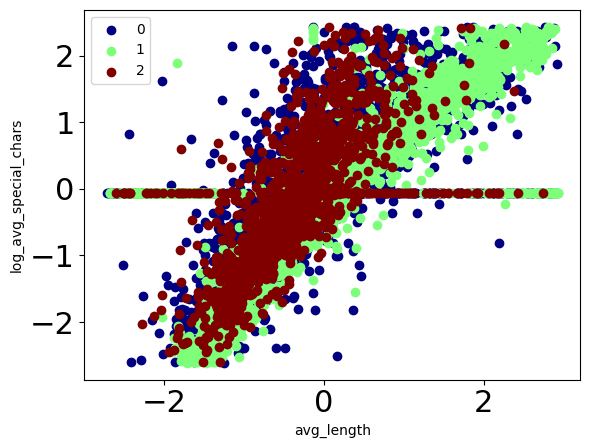

avg_length - log_urls_ratio


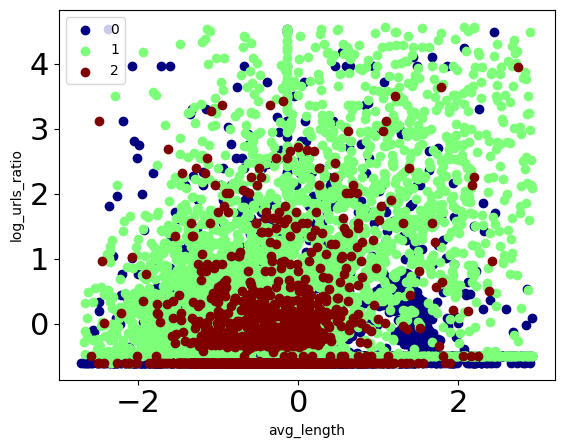

avg_length - log_mentions_ratio


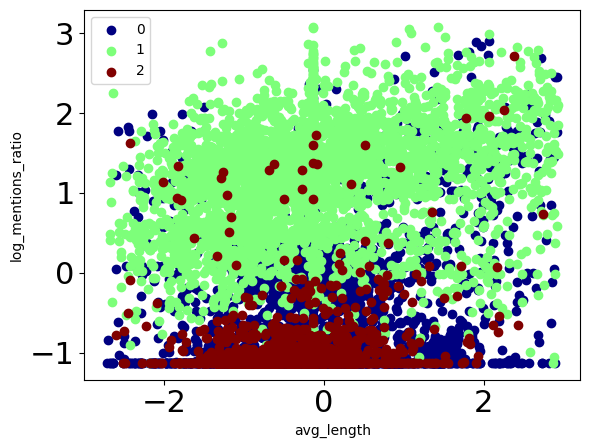

avg_length - log_hashtags_ratio


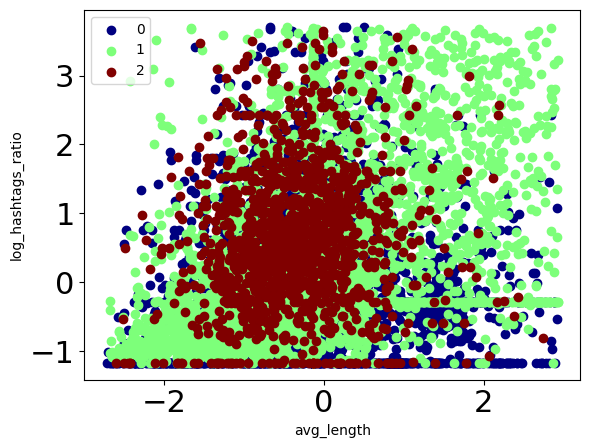

avg_length - log_reply_count_mean


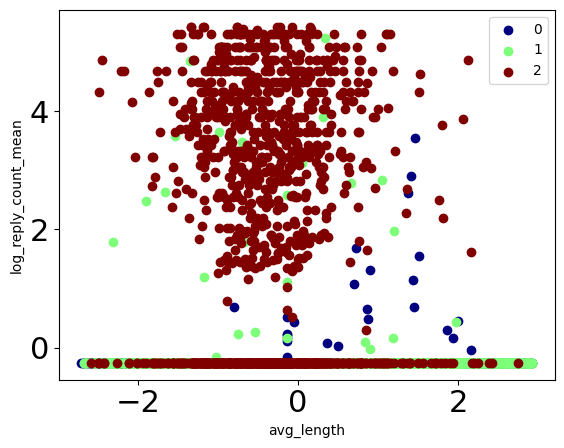

avg_length - log_reply_count_std


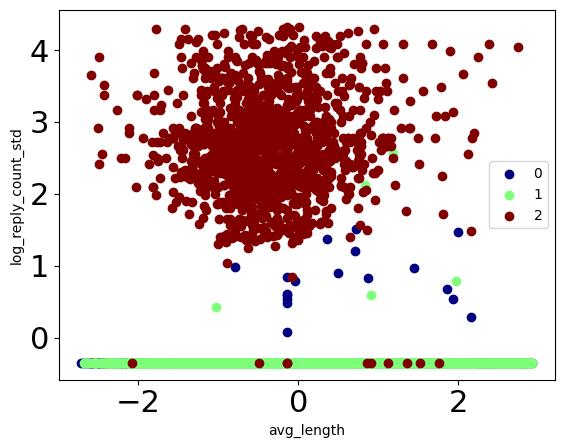

avg_length - log_favorite_count_mean


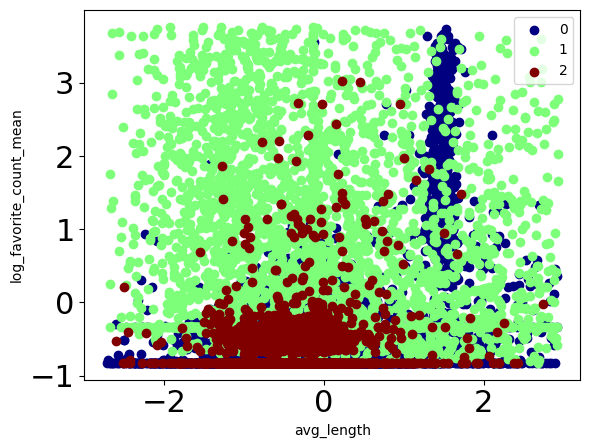

avg_length - log_favorite_count_std


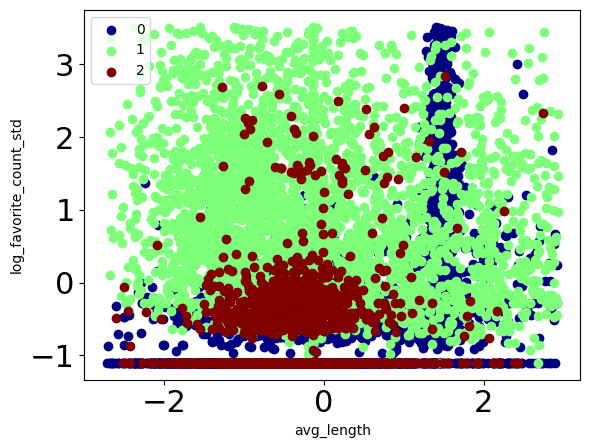

avg_length - log_favorite_count_entropy


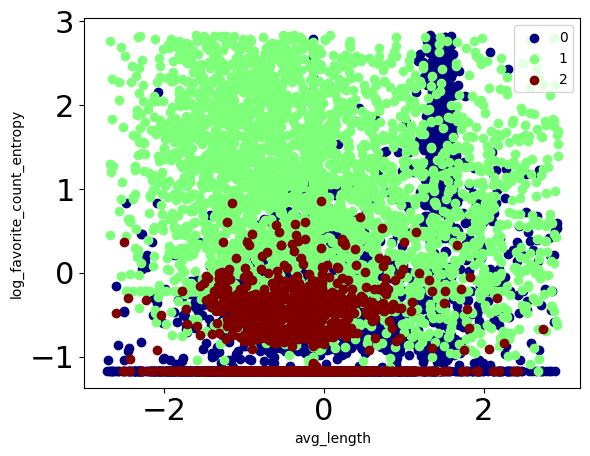

avg_length - log_retweet_count_mean


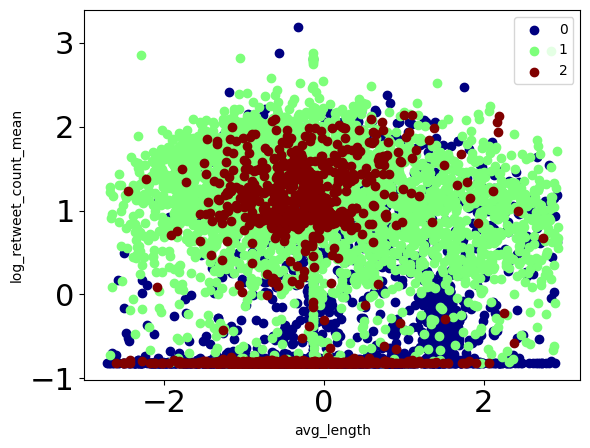

avg_length - log_retweet_count_std


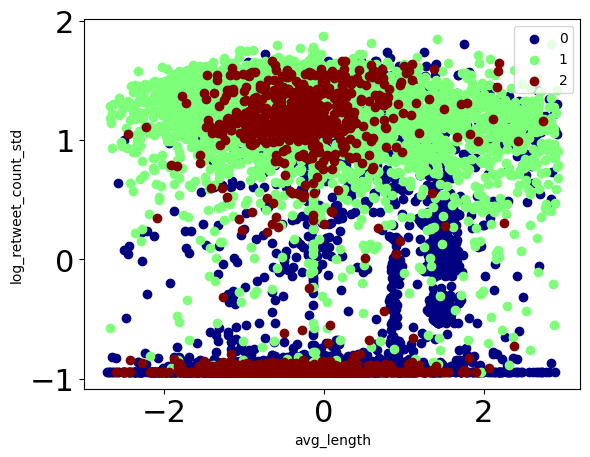

avg_length - log_retweet_count_entropy


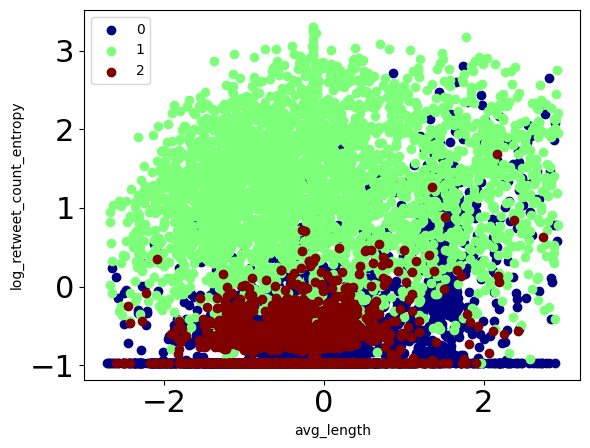

log_avg_special_chars - log_urls_ratio


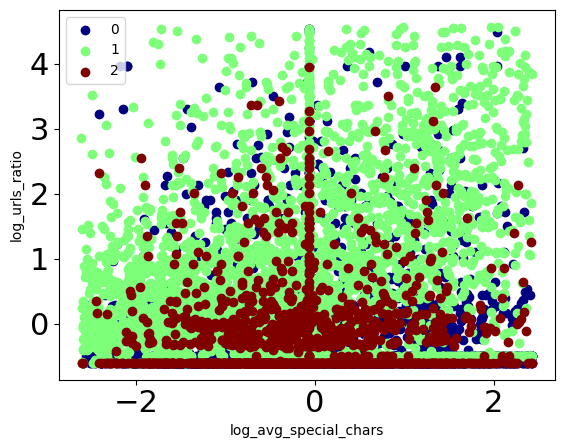

log_avg_special_chars - log_mentions_ratio


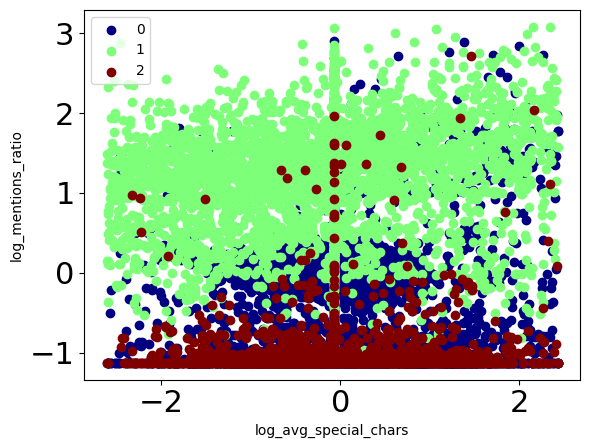

log_avg_special_chars - log_hashtags_ratio


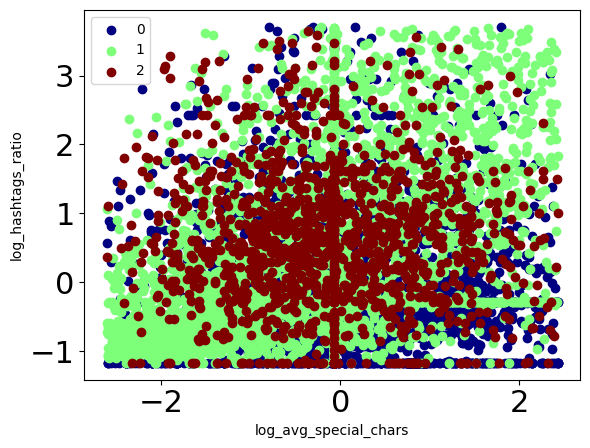

log_avg_special_chars - log_reply_count_mean


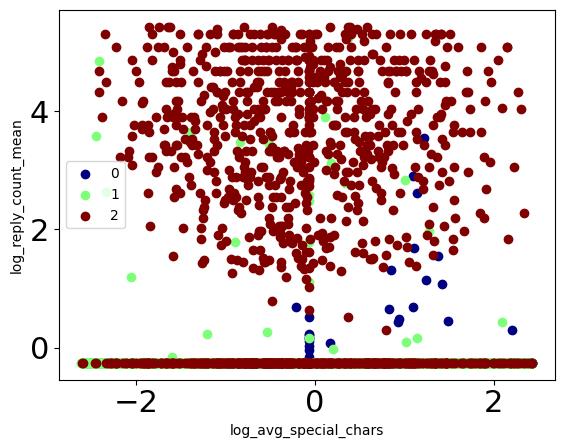

log_avg_special_chars - log_reply_count_std


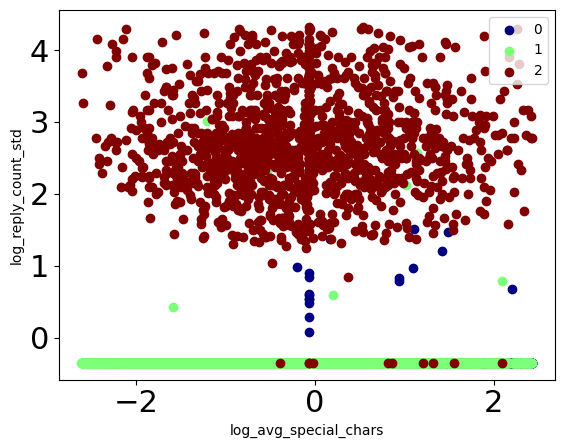

log_avg_special_chars - log_favorite_count_mean


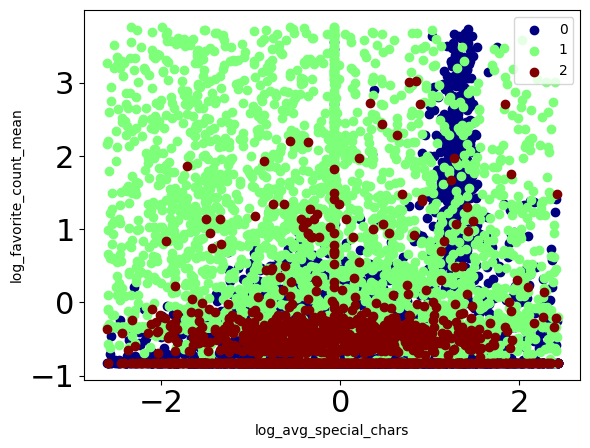

log_avg_special_chars - log_favorite_count_std


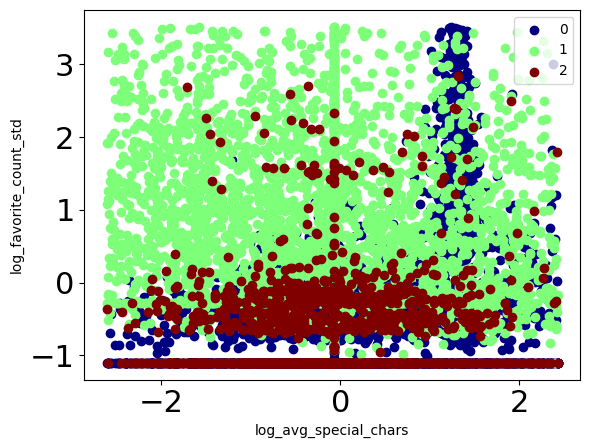

log_avg_special_chars - log_favorite_count_entropy


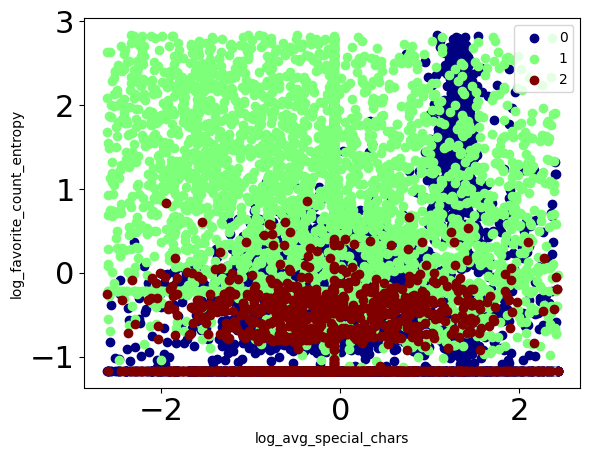

log_avg_special_chars - log_retweet_count_mean


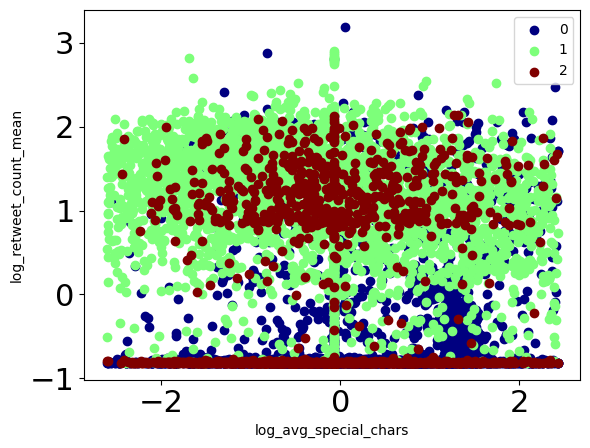

log_avg_special_chars - log_retweet_count_std


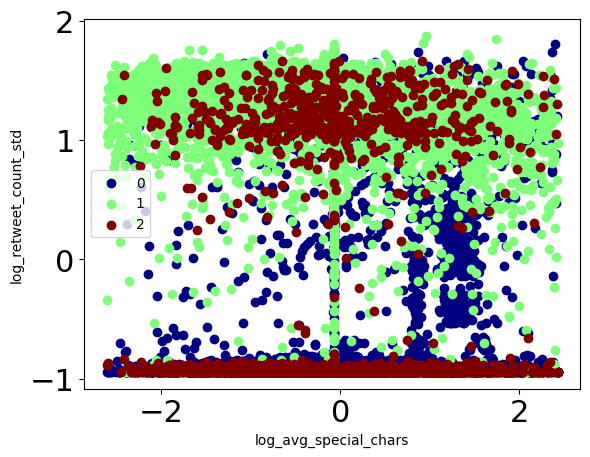

log_avg_special_chars - log_retweet_count_entropy


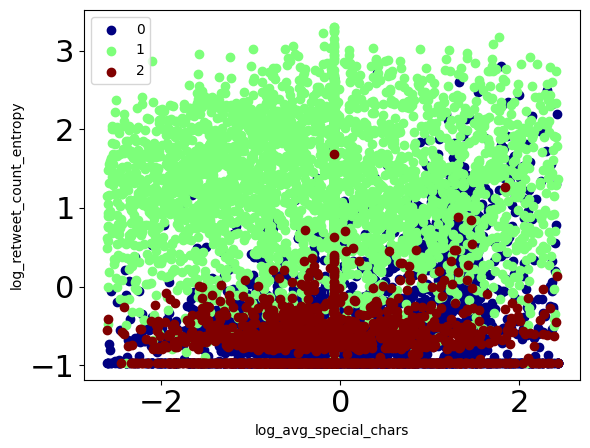

log_urls_ratio - log_mentions_ratio


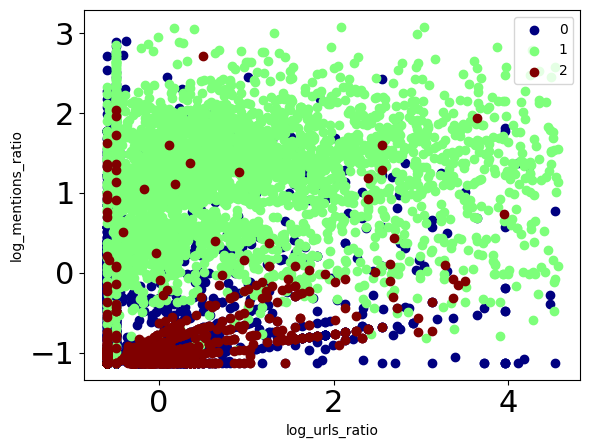

log_urls_ratio - log_hashtags_ratio


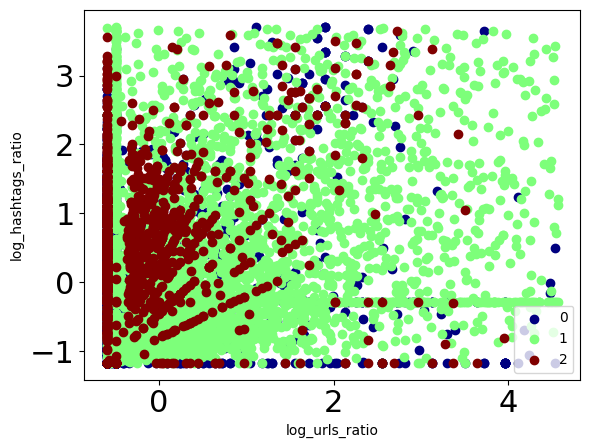

log_urls_ratio - log_reply_count_mean


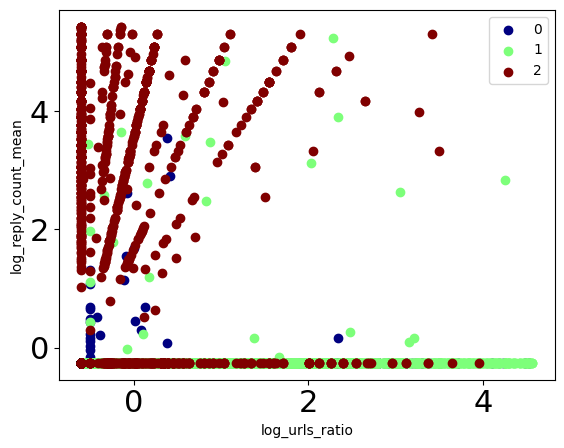

log_urls_ratio - log_reply_count_std


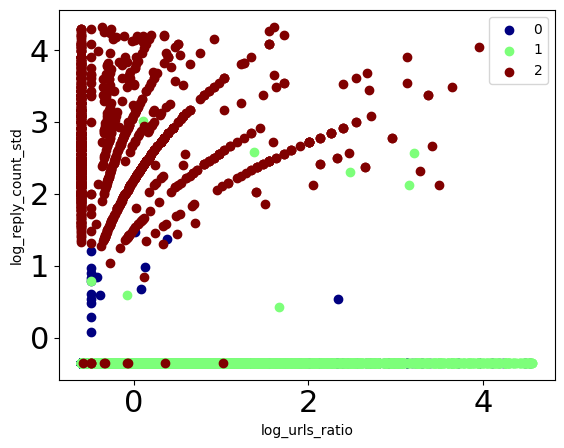

log_urls_ratio - log_favorite_count_mean


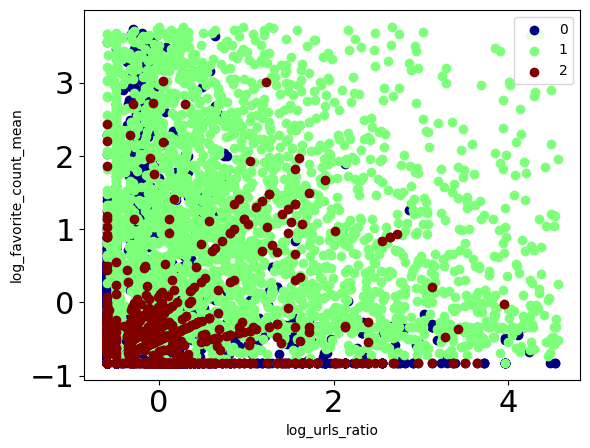

log_urls_ratio - log_favorite_count_std


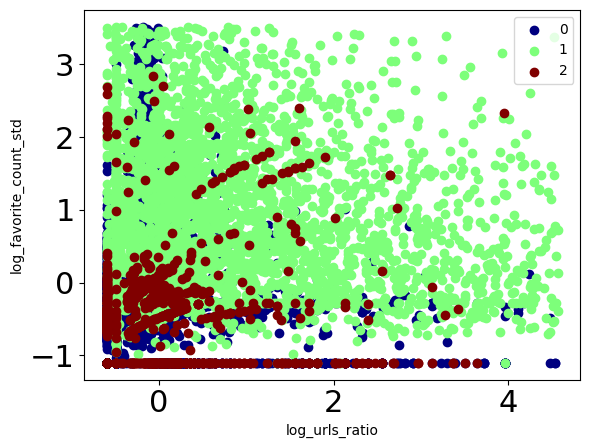

log_urls_ratio - log_favorite_count_entropy


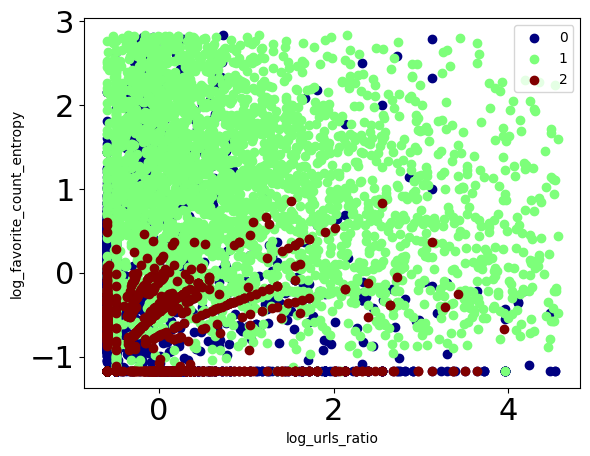

log_urls_ratio - log_retweet_count_mean


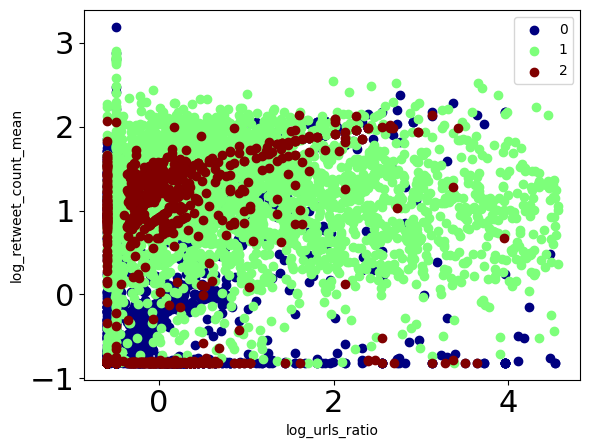

log_urls_ratio - log_retweet_count_std


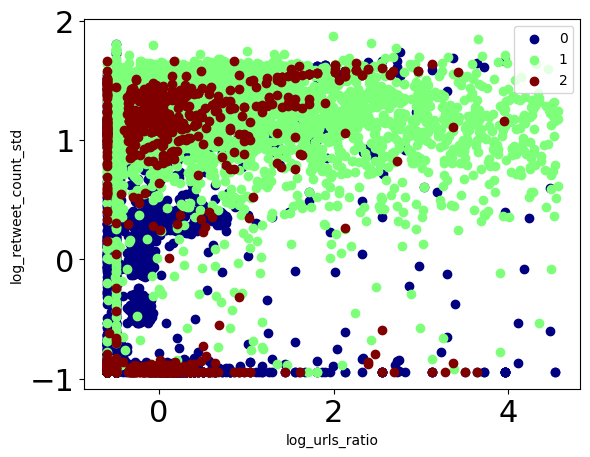

log_urls_ratio - log_retweet_count_entropy


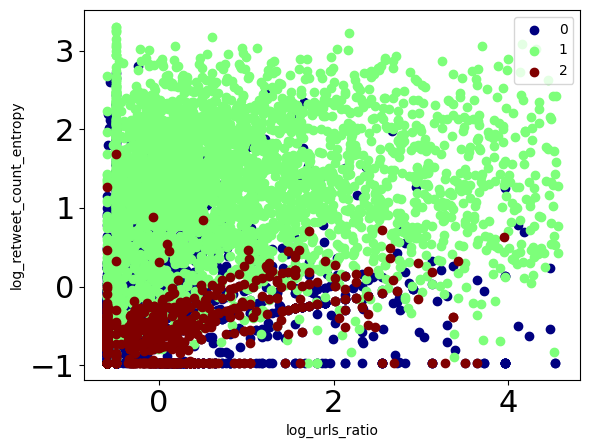

log_mentions_ratio - log_hashtags_ratio


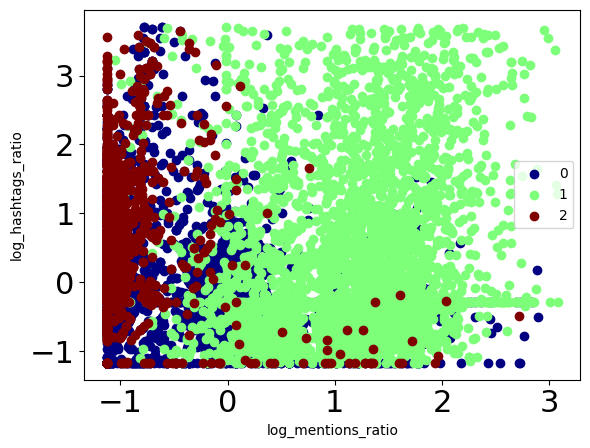

log_mentions_ratio - log_reply_count_mean


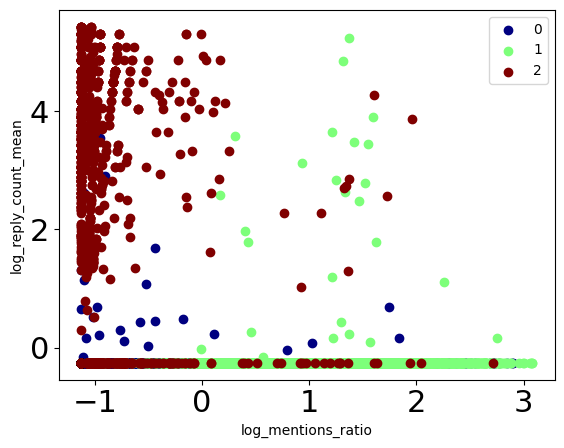

log_mentions_ratio - log_reply_count_std


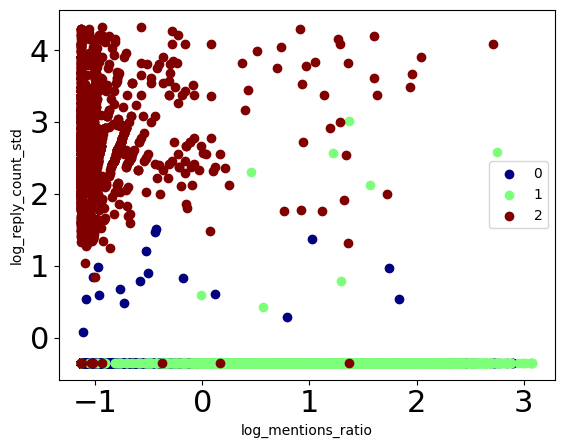

log_mentions_ratio - log_favorite_count_mean


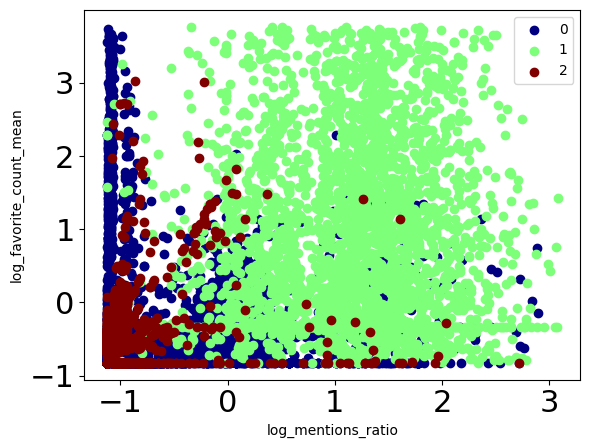

log_mentions_ratio - log_favorite_count_std


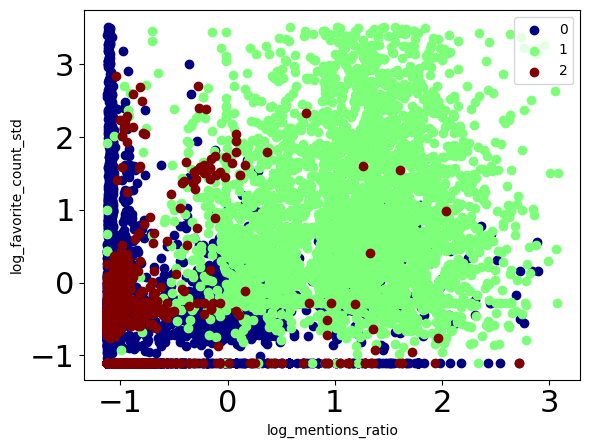

log_mentions_ratio - log_favorite_count_entropy


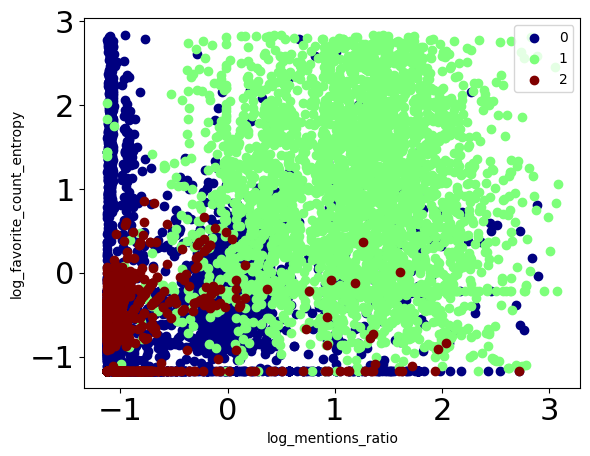

log_mentions_ratio - log_retweet_count_mean


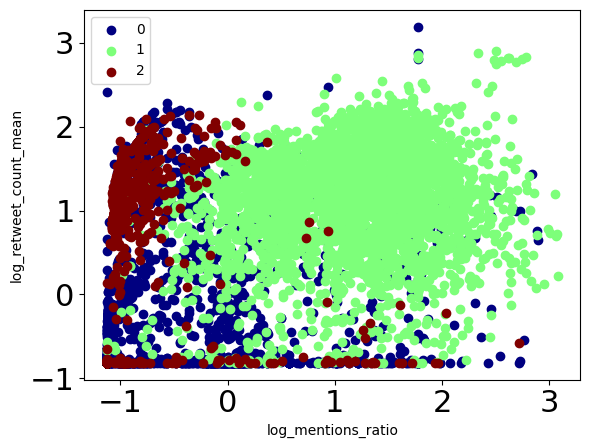

log_mentions_ratio - log_retweet_count_std


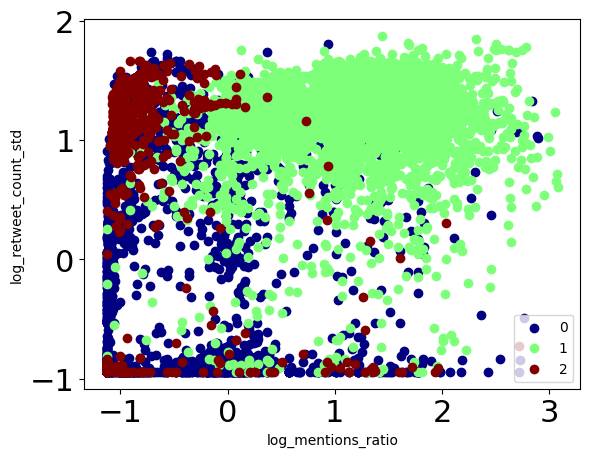

log_mentions_ratio - log_retweet_count_entropy


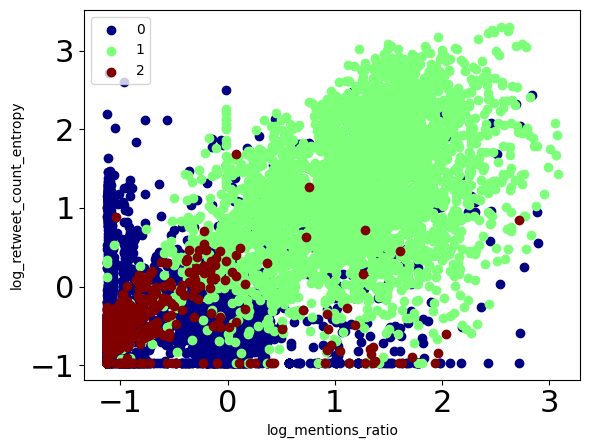

log_hashtags_ratio - log_reply_count_mean


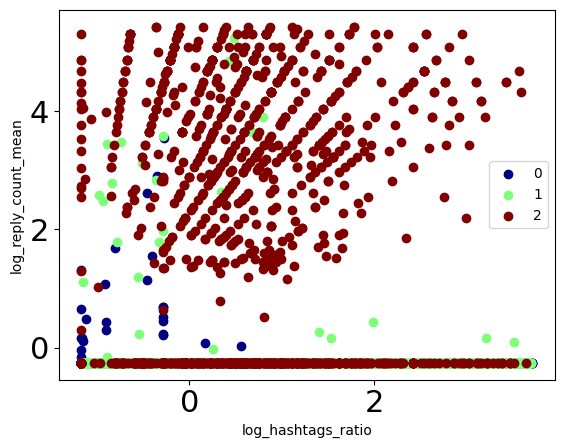

log_hashtags_ratio - log_reply_count_std


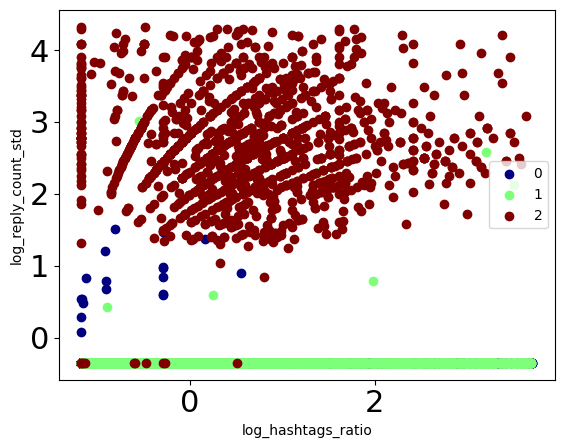

log_hashtags_ratio - log_favorite_count_mean


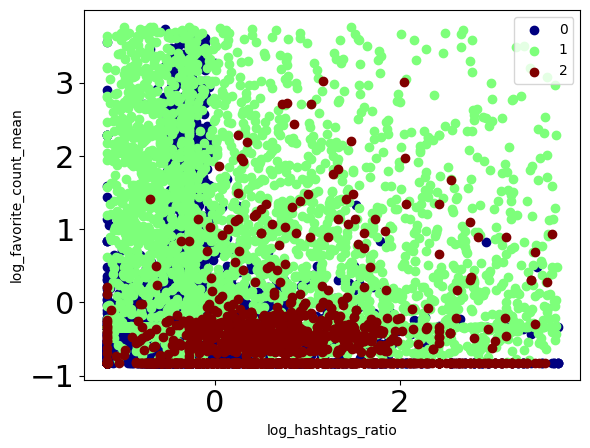

log_hashtags_ratio - log_favorite_count_std


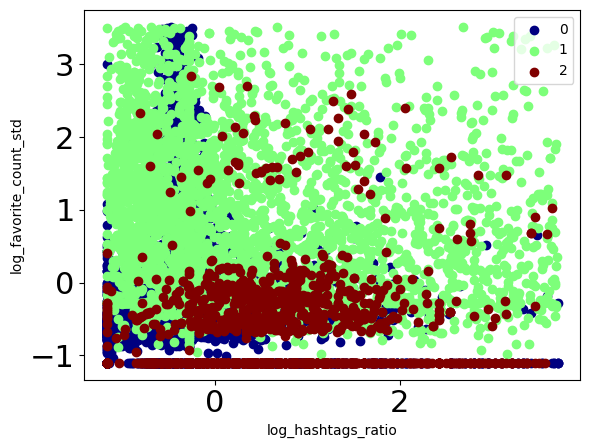

log_hashtags_ratio - log_favorite_count_entropy


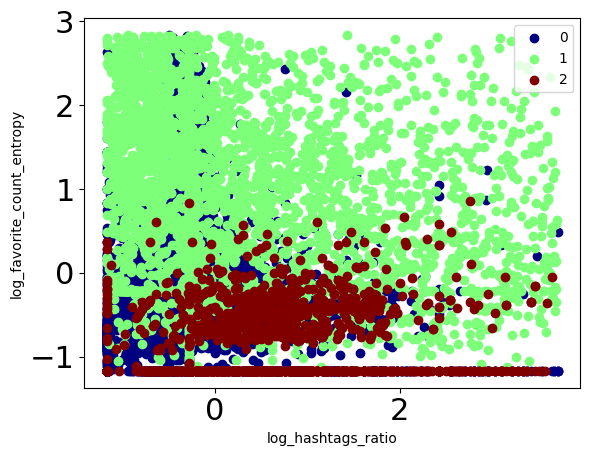

log_hashtags_ratio - log_retweet_count_mean


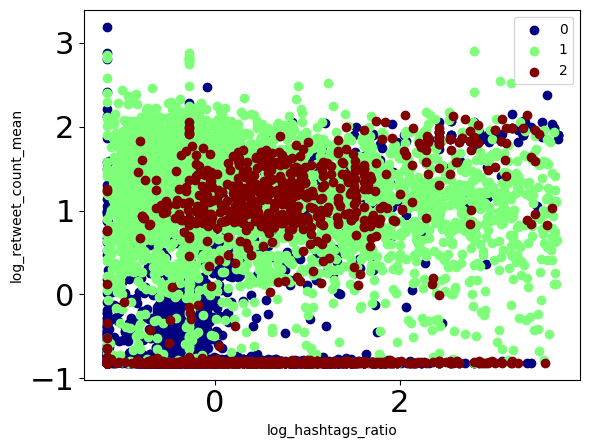

log_hashtags_ratio - log_retweet_count_std


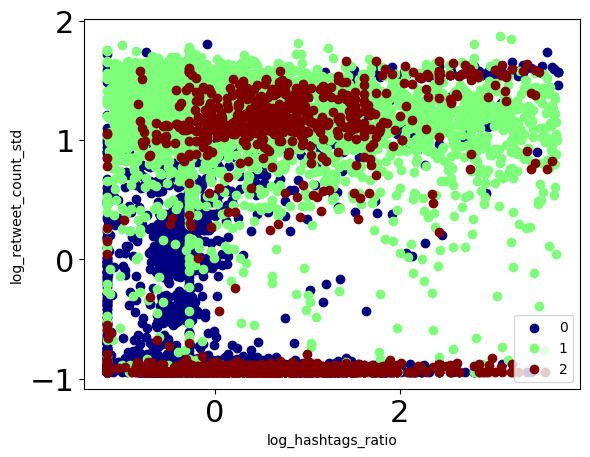

log_hashtags_ratio - log_retweet_count_entropy


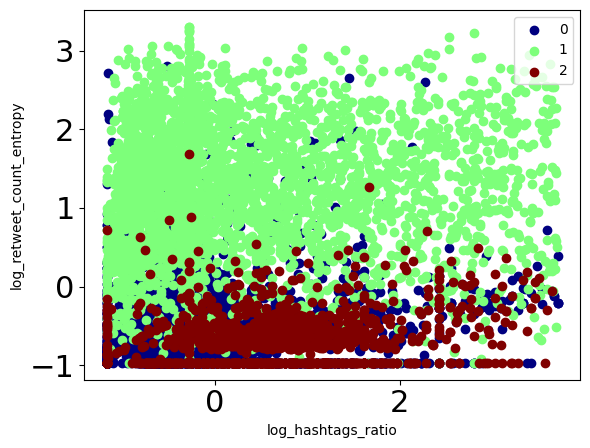

log_reply_count_mean - log_reply_count_std


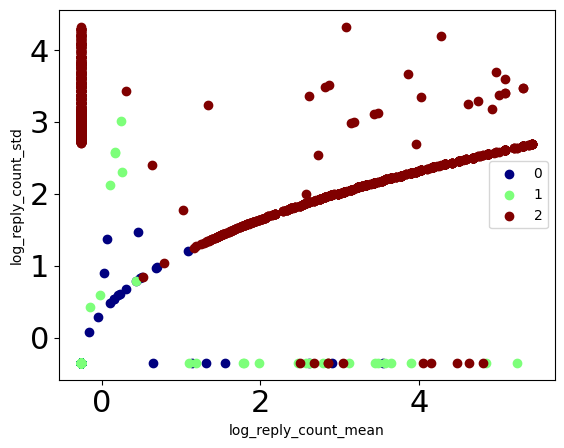

log_reply_count_mean - log_favorite_count_mean


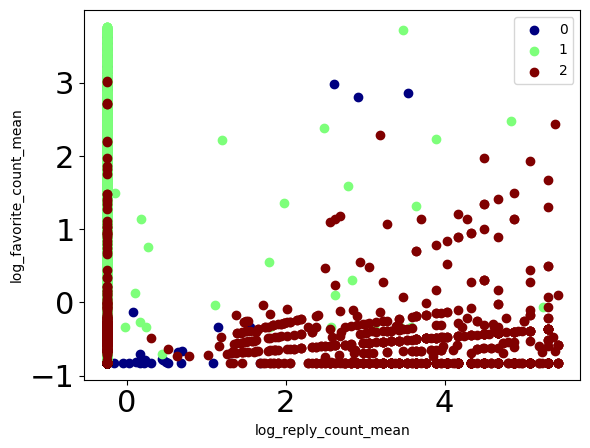

log_reply_count_mean - log_favorite_count_std


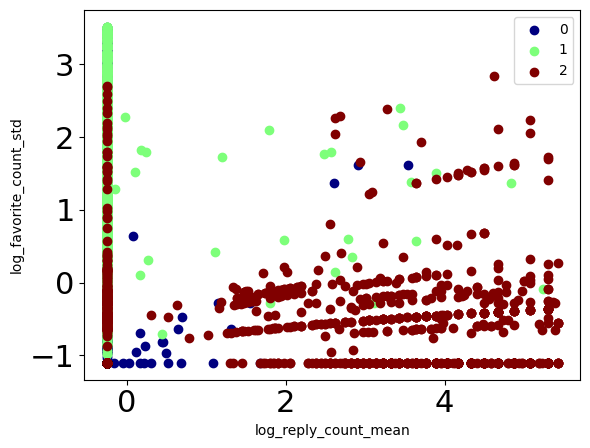

log_reply_count_mean - log_favorite_count_entropy


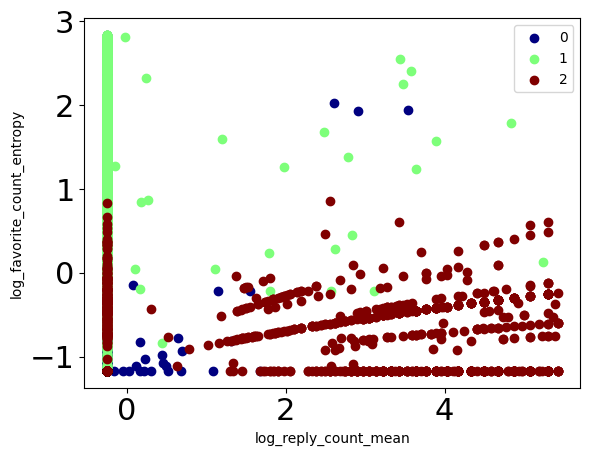

log_reply_count_mean - log_retweet_count_mean


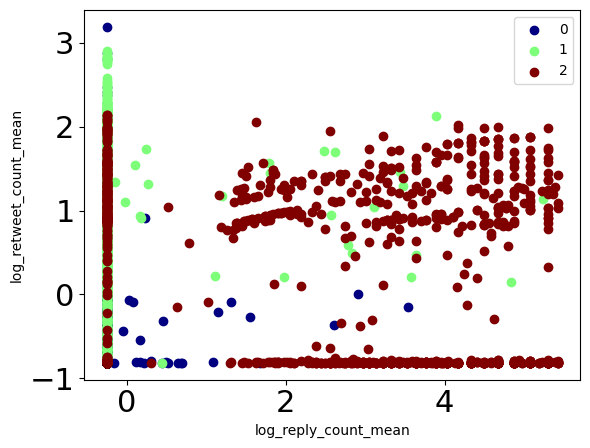

log_reply_count_mean - log_retweet_count_std


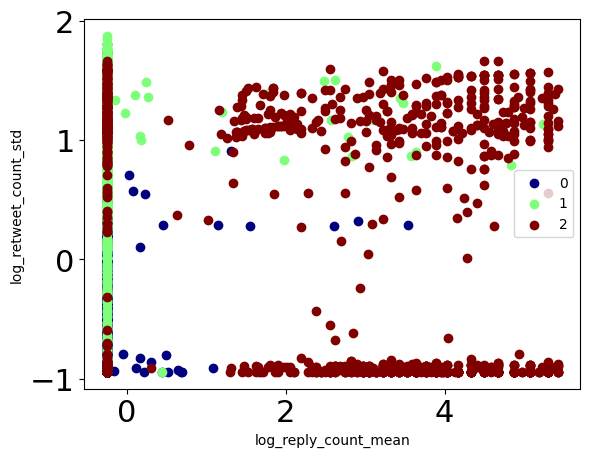

log_reply_count_mean - log_retweet_count_entropy


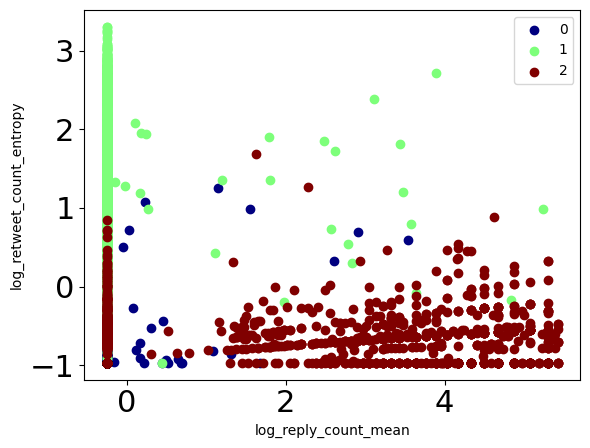

log_reply_count_std - log_favorite_count_mean


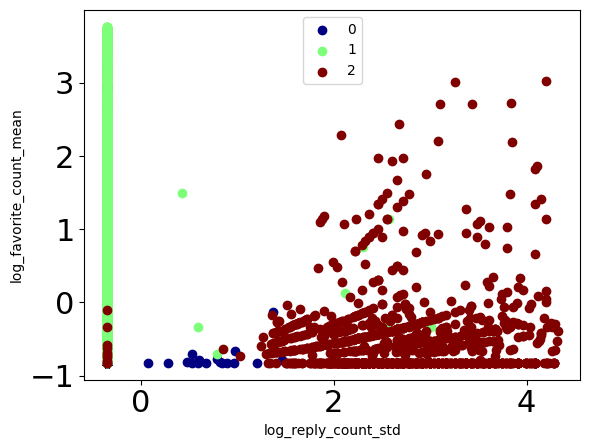

log_reply_count_std - log_favorite_count_std


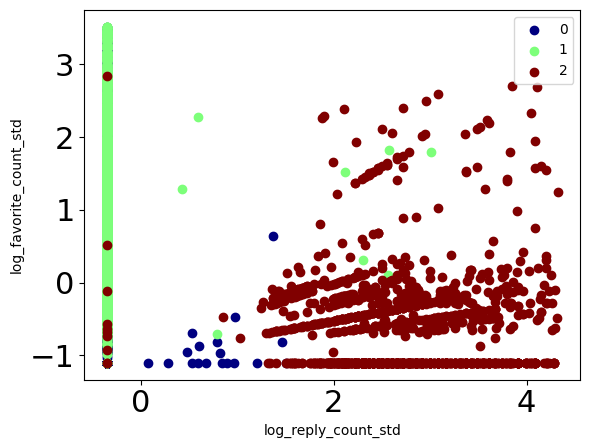

log_reply_count_std - log_favorite_count_entropy


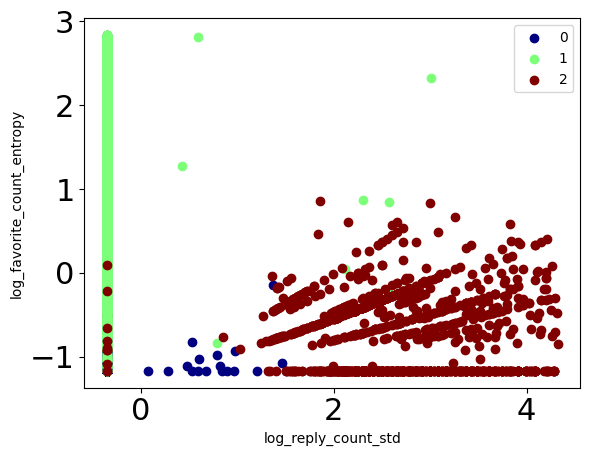

log_reply_count_std - log_retweet_count_mean


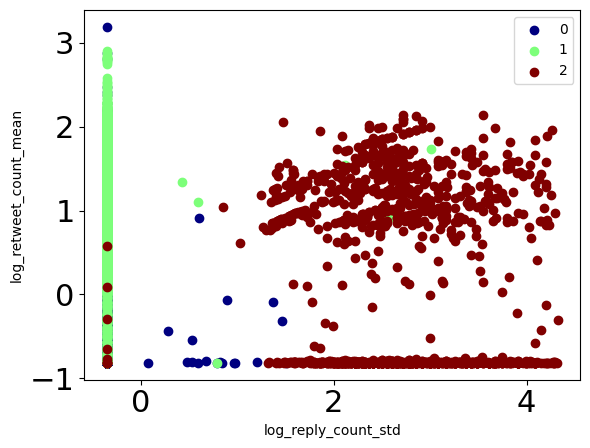

log_reply_count_std - log_retweet_count_std


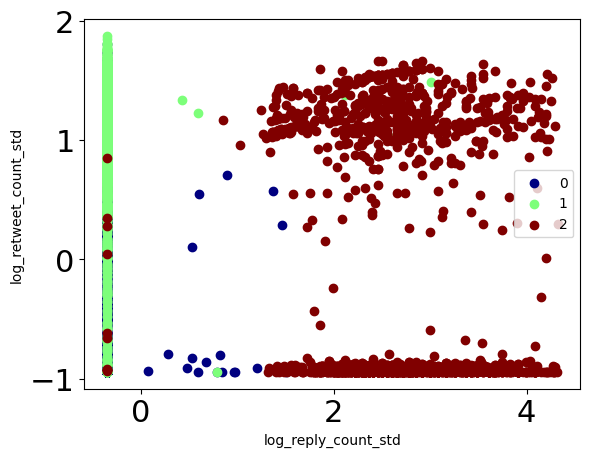

log_reply_count_std - log_retweet_count_entropy


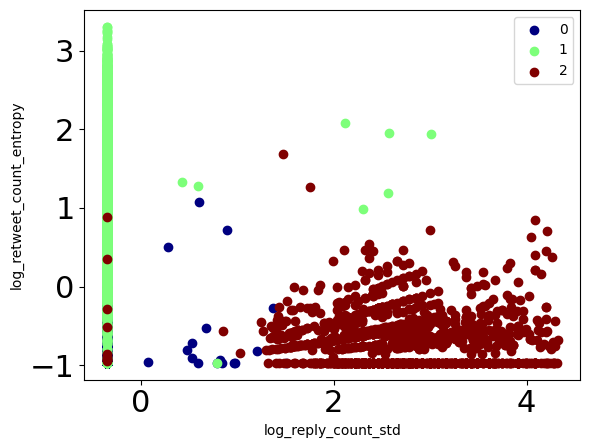

log_favorite_count_mean - log_favorite_count_std


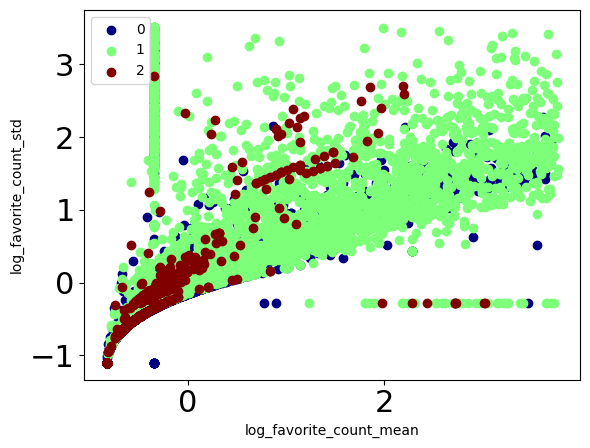

log_favorite_count_mean - log_favorite_count_entropy


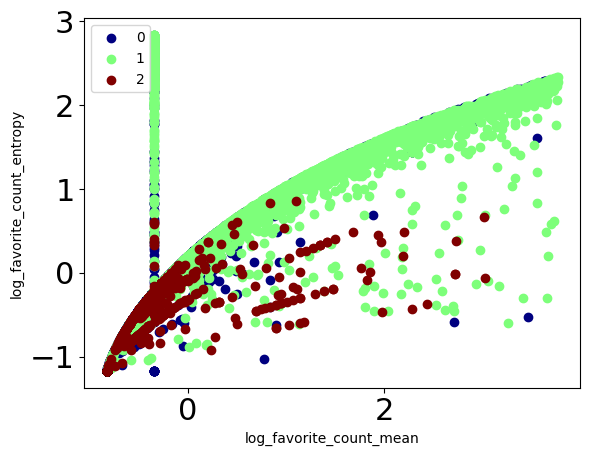

log_favorite_count_mean - log_retweet_count_mean


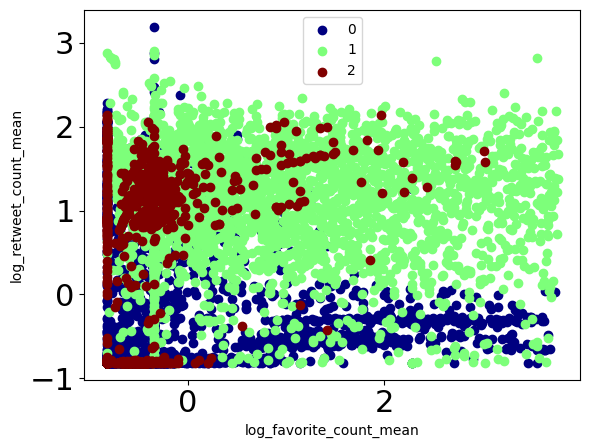

log_favorite_count_mean - log_retweet_count_std


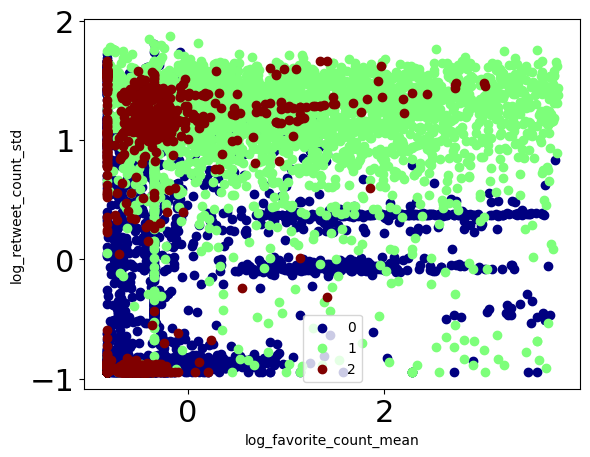

log_favorite_count_mean - log_retweet_count_entropy


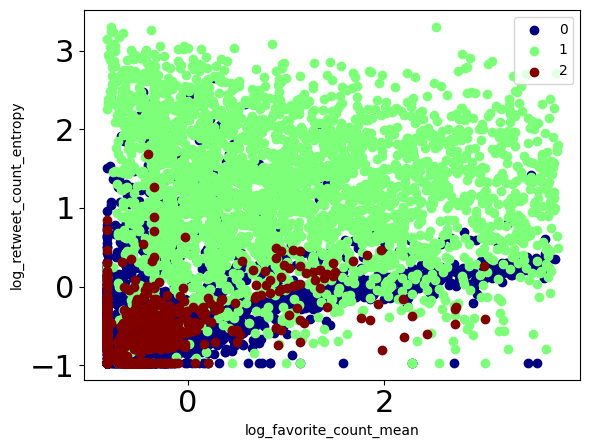

log_favorite_count_std - log_favorite_count_entropy


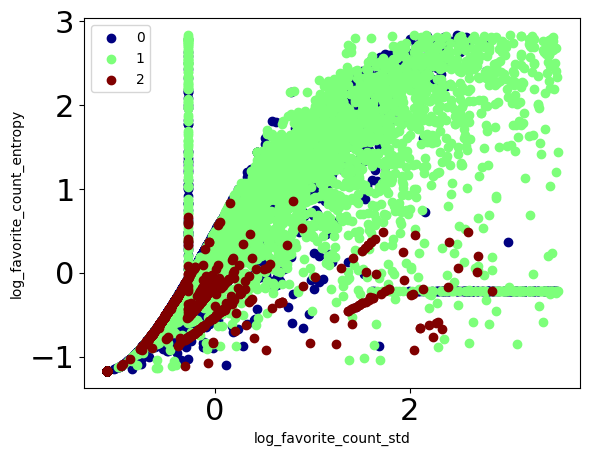

log_favorite_count_std - log_retweet_count_mean


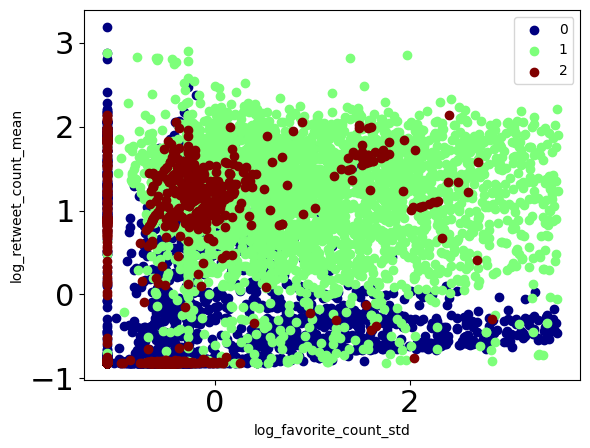

log_favorite_count_std - log_retweet_count_std


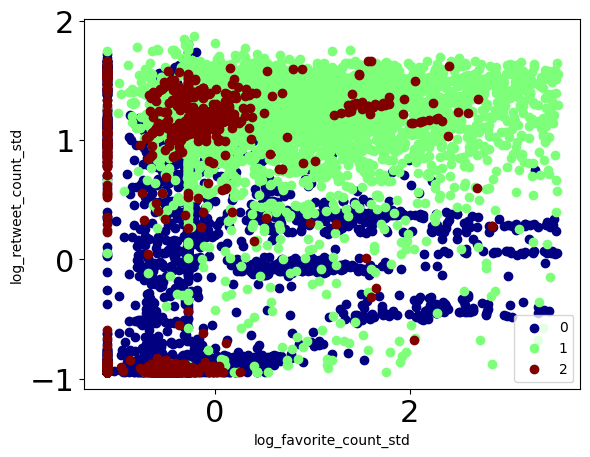

log_favorite_count_std - log_retweet_count_entropy


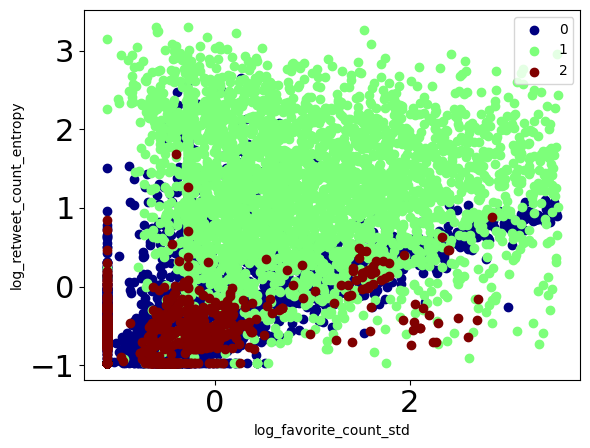

log_favorite_count_entropy - log_retweet_count_mean


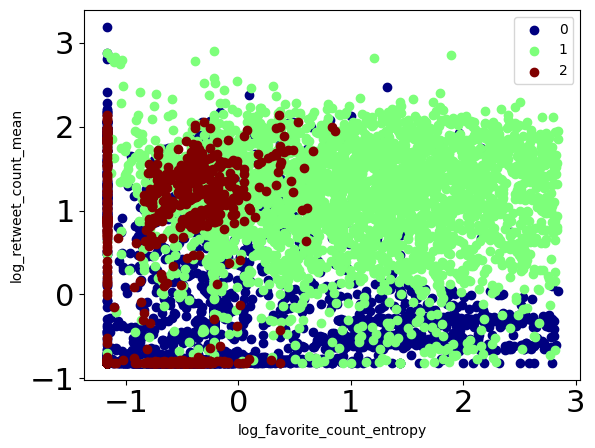

log_favorite_count_entropy - log_retweet_count_std


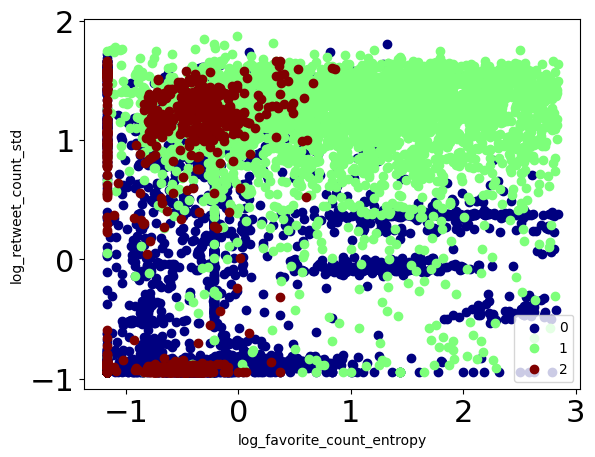

log_favorite_count_entropy - log_retweet_count_entropy


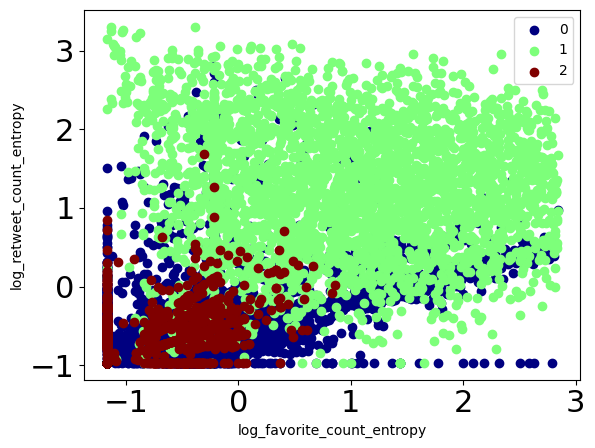

log_retweet_count_mean - log_retweet_count_std


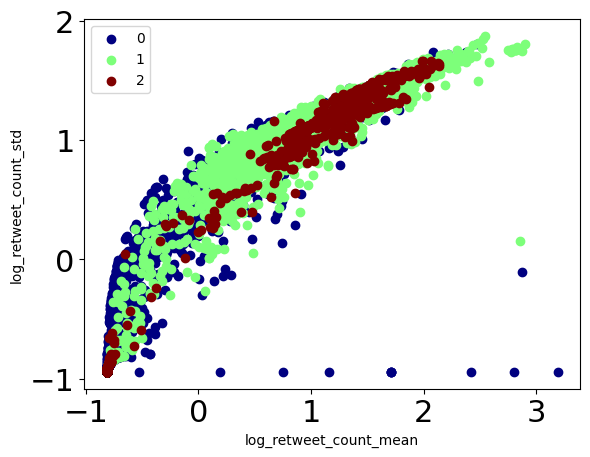

log_retweet_count_mean - log_retweet_count_entropy


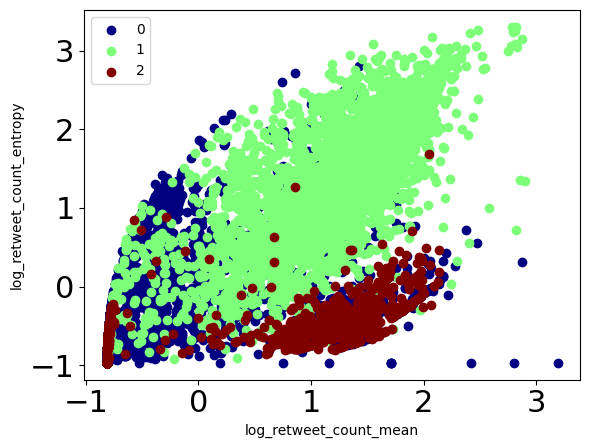

log_retweet_count_std - log_retweet_count_entropy


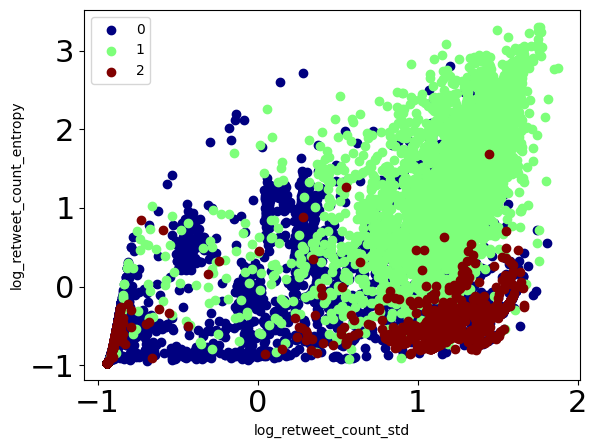

In [40]:
scatter_features_clusters(pd.DataFrame(X, columns=df_num_not_skewed.columns), res_cluster.labels_)

### PCA

Apply PCA to visualize the scatter plot distribution of the clustered data

In [41]:
pca = PCA(n_components=2)
X_reduced = pca.fit_transform(X)

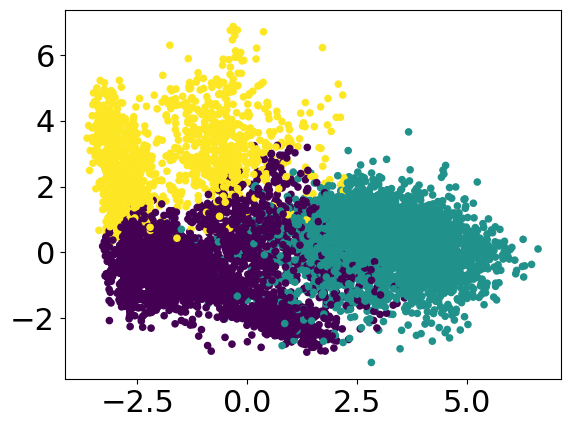

In [42]:
plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=res_cluster.labels_, s=20)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.savefig("../images/clustering/hierarchical_pca.png")
plt.show()

### Evaluation Hierarchical

Print the SSE, Silouette and Separation of the method selected out.

In [43]:
def get_sse(X, labels, centers):
    sum_ = 0
    for k in range(len(np.unique(labels))):
        datas = X[labels == np.unique(labels)[k]]
        center = centers[k]
        for data in datas:
            dist = np.linalg.norm(data - center)**2
            sum_ += dist
    return sum_

In [44]:
print('SSE %s' % get_sse(X, res_cluster.labels_, clf.centroids_))
print('Silhouette %s' % silhouette_score(X, res_cluster.labels_))
print('Separation %s' % metrics.davies_bouldin_score(X, res_cluster.labels_))

SSE 95689.84406343795
Silhouette 0.349018386442831
Separation 1.298321401122908
